In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import seaborn as sns
import matplotlib.pyplot as plt

: 

# 📊 제2진도대교 센서 데이터 컬럼 정리

## 1️⃣ 데이터 개요
본 데이터는 **제2진도대교의 구조 건전성 모니터링(SHM)**을 위해 설치된  
다양한 IoT 센서의 시계열 데이터를 기반으로 한다.  
각 센서는 교량의 **변형률, 진동, 온도, 풍속, 지진 가속도 등**을 실시간으로 측정한다.

---

## 2️⃣ 센서별 컬럼 요약

| 약어 | 센서 종류 | 주요 측정값 | 예시 컬럼명 | 단위 / 비고 |
|:------:|:------------|:-------------|:------------------|:----------------|
| **FBG** | 광섬유 변형률계 *(Fiber Bragg Grating Strain)* | 교량 부재의 **변형률(Strain)** | `FBG001` ~ `FBG024` | μstrain *(마이크로스트레인)* |
| **FBT** | 광섬유 온도계 *(Fiber Bragg Temperature)* | **온도 보정용 데이터** | `FBT001` ~ `FBT020` | °C |
| **ACC** | 가속도계 *(Accelerometer)* | 교량의 **진동 / 응답 가속도(X/Y/Z축)** | `ACC001_X`, `ACC001_Y`, `ACC001_Z` | m/s² |
| **CAC** | 케이블 가속도계 *(Cable Acceleration)* | 케이블의 **진동/가속도** | `CAC001` ~ `CAC018` | m/s² |
| **EQK** | 지진 가속도계 *(Earthquake Accelerometer)* | **지진, 지자기(X/Y/Z축)** | `EQK001_X`, `EQK001_Y`, `EQK001_Z` | m/s² |
| **WGT / WVR** | 풍향·풍속계 *(Wind Gauge / Wind Vane Recorder)* | **바람의 속도와 방향** | `WGT001_S`, `WGT001_D`, `WVR001_PSP`, `WVR002_HSP` | m/s, ° |
| **DIS** | 처짐계 *(Displacement Sensor)* | 교량 상판의 **처짐(Deflection)** | `DIS001_Y`, `DIS001_Z` | mm |
| **GNS** | GNSS *(GPS 기반 위치계)* | **교각 또는 케이블의 변위(Position)** | `GNS001_X`, `GNS001_Y`, `GNS001_Z` | m |
| **TEMP** | 외기 온도 *(기상청 제공)* | **외부 환경 온도** | `TEMP`, `WGT_TEMP` | °C |
| **HUM** | 습도계 *(Humidity Sensor)* | **상대습도(Relative Humidity)** | `HUM001` | % |
| **PRS** | 기압계 *(Pressure Sensor)* | **기압(Atmospheric Pressure)** | `PRS001` | hPa |

---

In [39]:
data = pd.read_csv("C:/Users/thddu/Desktop/데이터분석/진도대교분석/AI_anomalyDetection/data.csv", index_col = 0)
data.head()
d = set(data.columns)
d

{'ACC001_X',
 'ACC001_Y',
 'ACC001_Z',
 'ACC002_Z',
 'ACC003_Z',
 'CAC001',
 'CAC002',
 'CAC003',
 'CAC004',
 'CAC005',
 'CAC006',
 'CAC007',
 'CAC008',
 'CAC009',
 'CAC010',
 'CAC011',
 'CAC013',
 'CAC014',
 'CAC015',
 'CAC016',
 'CAC017',
 'CAC018',
 'DIS001_Y',
 'DIS001_Z',
 'EQK001_X',
 'EQK001_Y',
 'EQK001_Z',
 'EQK_TJAX',
 'EQK_TJAY',
 'EQK_TJBX',
 'EQK_TJBY',
 'EQK_TJBZ',
 'EQK_TJCX',
 'EQK_TJCY',
 'EQK_TJDX',
 'EQK_TJGE',
 'EQK_TJGN',
 'EQK_TJGZ',
 'EQK_TJHZ',
 'EQK_TJPX',
 'EQK_TJQY',
 'EQK_TJQZ',
 'FBG001',
 'FBG002',
 'FBG003',
 'FBG004',
 'FBG005',
 'FBG006',
 'FBG007',
 'FBG008',
 'FBG009',
 'FBG010',
 'FBG011',
 'FBG012',
 'FBG013',
 'FBG014',
 'FBG015',
 'FBG016',
 'FBG017',
 'FBG018',
 'FBG019',
 'FBG020',
 'FBG021',
 'FBG022',
 'FBG023',
 'FBG024',
 'FBT001',
 'FBT005',
 'FBT006',
 'FBT007',
 'FBT009',
 'FBT010',
 'FBT011',
 'FBT012',
 'FBT013',
 'FBT014',
 'FBT015',
 'FBT016',
 'FBT017',
 'FBT018',
 'FBT019',
 'FBT020',
 'GNS001_X',
 'GNS001_Y',
 'GNS001_Z',
 'GNS002_

# data별 EDA

## 1. 시간대별 

In [40]:
# X.Time의 컬럼을 datetime형태로 변환
data['X.Time'] = pd.to_datetime(data['X.Time'])
data['X.Time']

# X.Time의 컬럼명을 datetime으로 변환
data.rename(columns={'X.Time' : 'datetime'}, inplace = True)
data.columns

Index(['X', 'ind', 'datetime', 'ACC001_X', 'ACC001_Y', 'ACC001_Z', 'ACC002_Z',
       'ACC003_Z', 'CAC001', 'CAC002',
       ...
       'WGT002_S', 'WGT002_V', 'WVR001_HDR', 'WVR001_HSP', 'WVR001_PDR',
       'WVR001_PSP', 'WVR002_HDR', 'WVR002_HSP', 'WVR002_PDR', 'WVR002_PSP'],
      dtype='object', length=108)

In [41]:
columns = [col for col in data.columns if col not in ['X', 'ind']]
columns

['datetime',
 'ACC001_X',
 'ACC001_Y',
 'ACC001_Z',
 'ACC002_Z',
 'ACC003_Z',
 'CAC001',
 'CAC002',
 'CAC003',
 'CAC004',
 'CAC005',
 'CAC006',
 'CAC007',
 'CAC008',
 'CAC009',
 'CAC010',
 'CAC011',
 'CAC013',
 'CAC014',
 'CAC015',
 'CAC016',
 'CAC017',
 'CAC018',
 'DIS001_Y',
 'DIS001_Z',
 'EQK_TJAX',
 'EQK_TJAY',
 'EQK_TJBX',
 'EQK_TJBY',
 'EQK_TJBZ',
 'EQK_TJCX',
 'EQK_TJCY',
 'EQK_TJDX',
 'EQK_TJGE',
 'EQK_TJGN',
 'EQK_TJGZ',
 'EQK_TJHZ',
 'EQK_TJPX',
 'EQK_TJQY',
 'EQK_TJQZ',
 'EQK001_X',
 'EQK001_Y',
 'EQK001_Z',
 'FBG001',
 'FBG002',
 'FBG003',
 'FBG004',
 'FBG005',
 'FBG006',
 'FBG007',
 'FBG008',
 'FBG009',
 'FBG010',
 'FBG011',
 'FBG012',
 'FBG013',
 'FBG014',
 'FBG015',
 'FBG016',
 'FBG017',
 'FBG018',
 'FBG019',
 'FBG020',
 'FBG021',
 'FBG022',
 'FBG023',
 'FBG024',
 'FBT001',
 'FBT005',
 'FBT006',
 'FBT007',
 'FBT009',
 'FBT010',
 'FBT011',
 'FBT012',
 'FBT013',
 'FBT014',
 'FBT015',
 'FBT016',
 'FBT017',
 'FBT018',
 'FBT019',
 'FBT020',
 'GNS001_X',
 'GNS001_Y',
 'GNS001_

In [42]:
# 컬럼에서 3번째까지 슬라이싱해서 저장
columnSensor = []
for col in columns : 
    if col not in 'datetime' :
        columnSensor.append(col[:3])
    
columnSensor = list(set(columnSensor))
columnSensor

['GNS', 'WVR', 'DIS', 'WGT', 'CAC', 'ACC', 'FBT', 'FBG', 'EQK']

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\2938762340.py:10: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


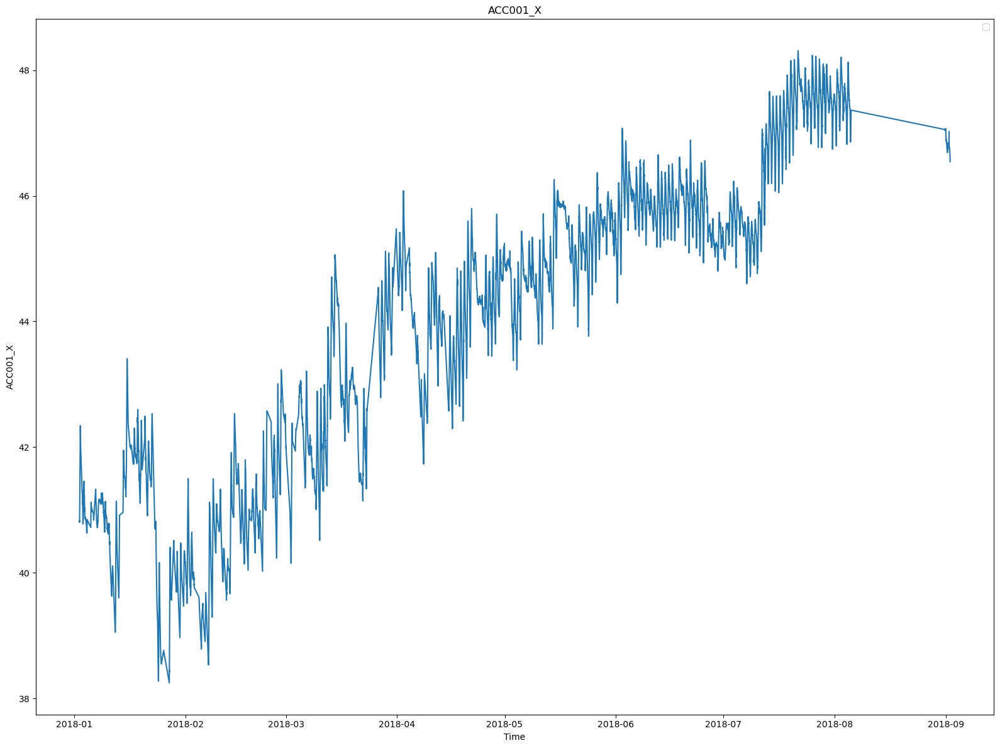

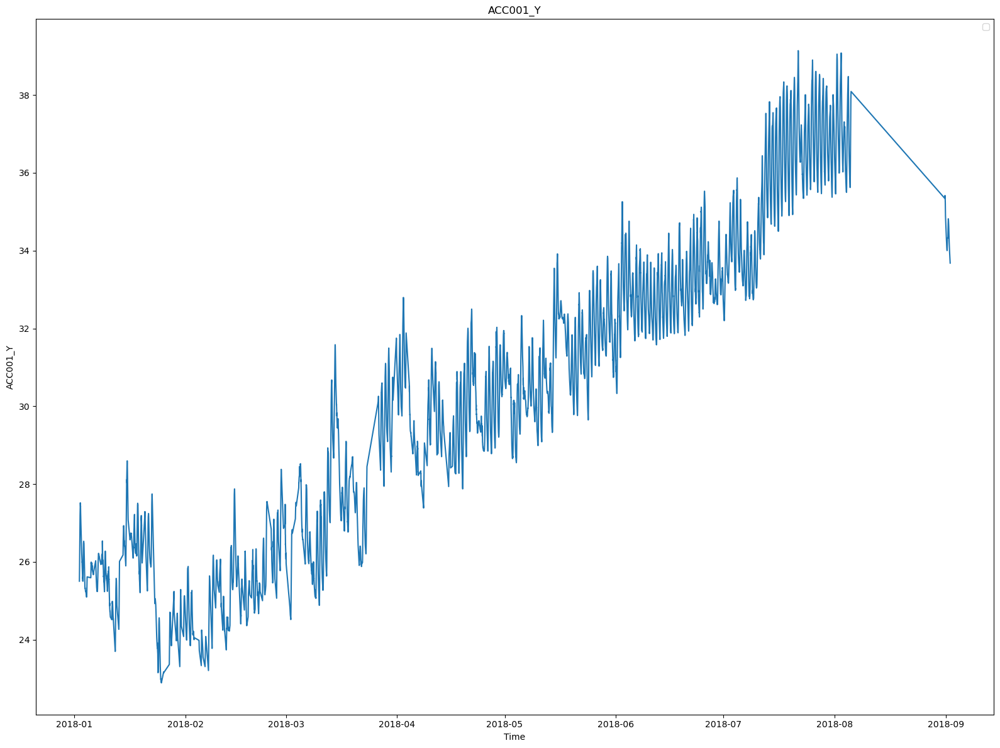

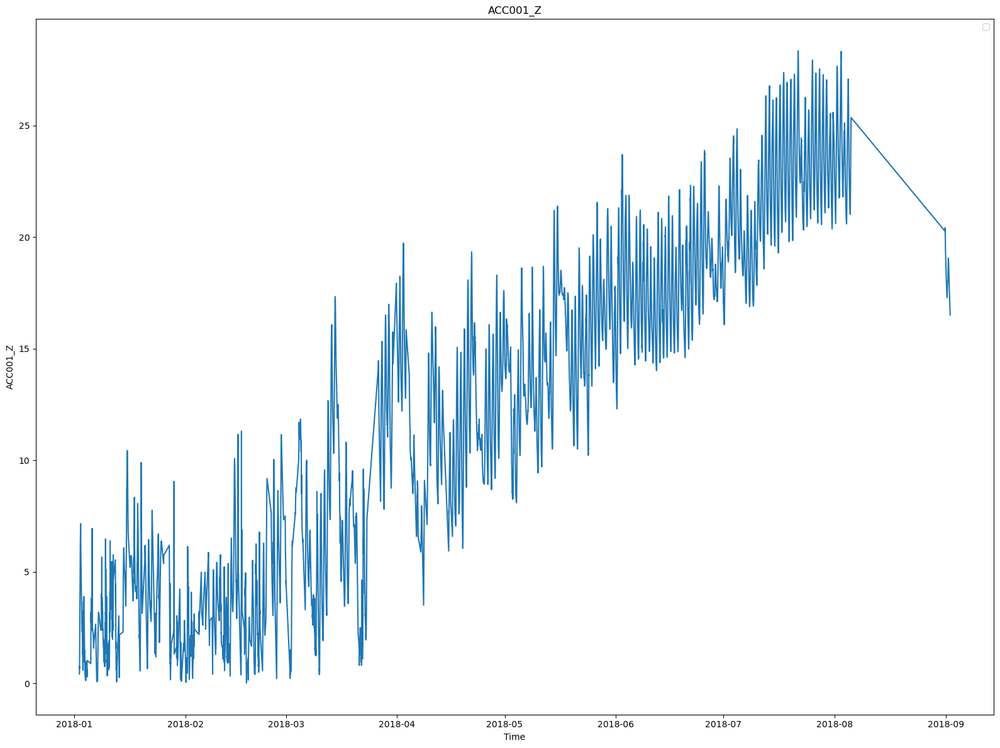

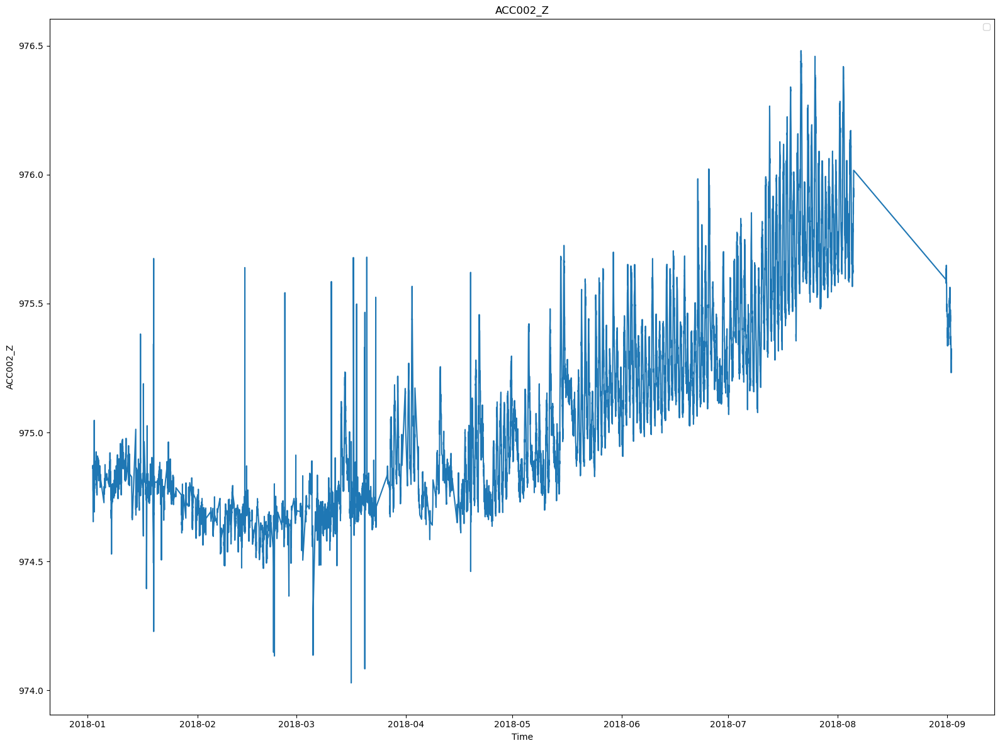

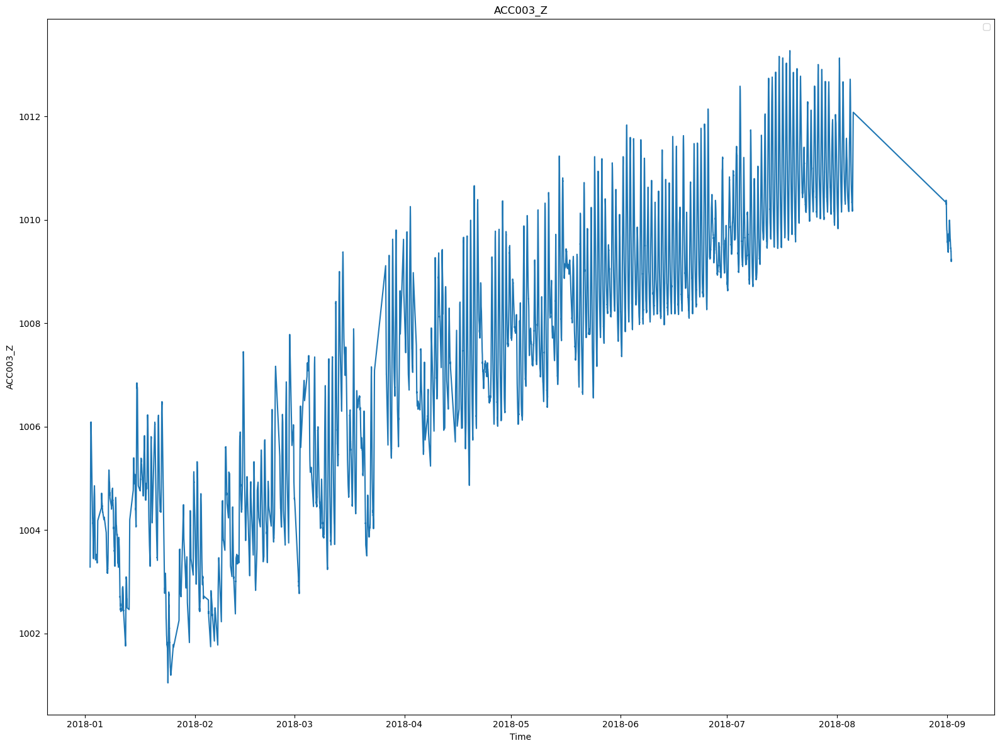

...

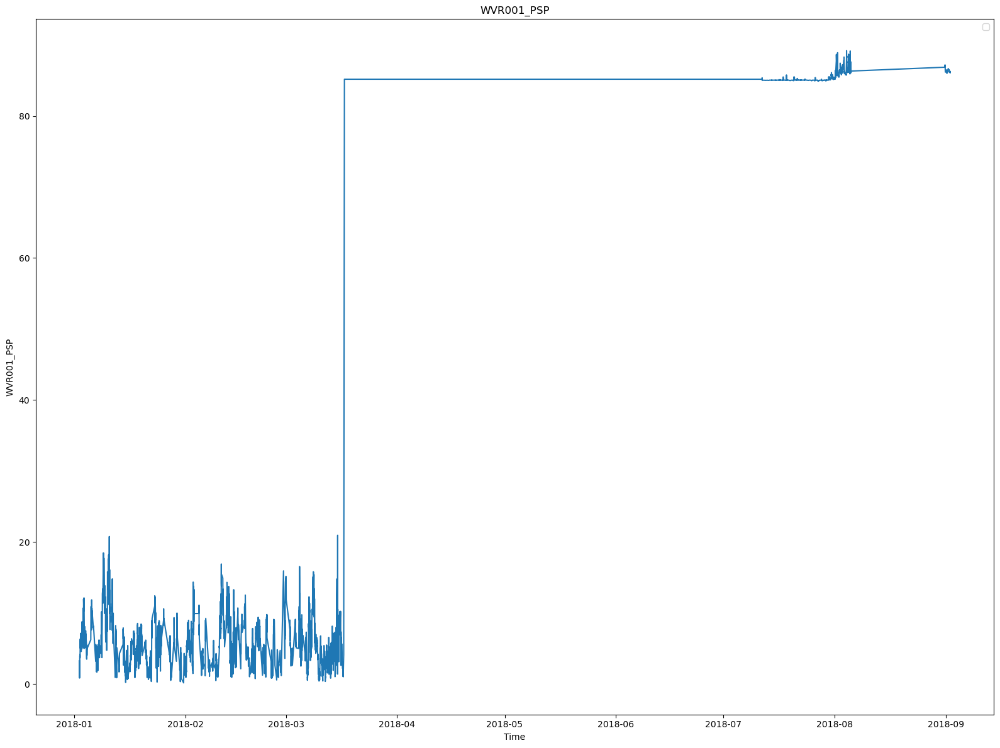

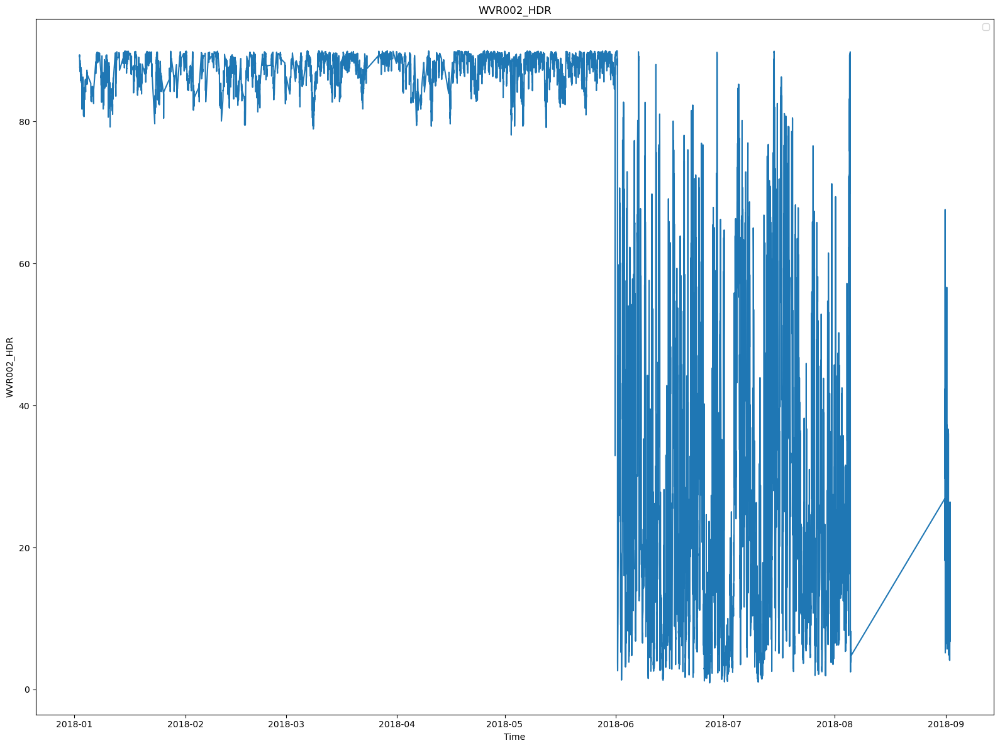

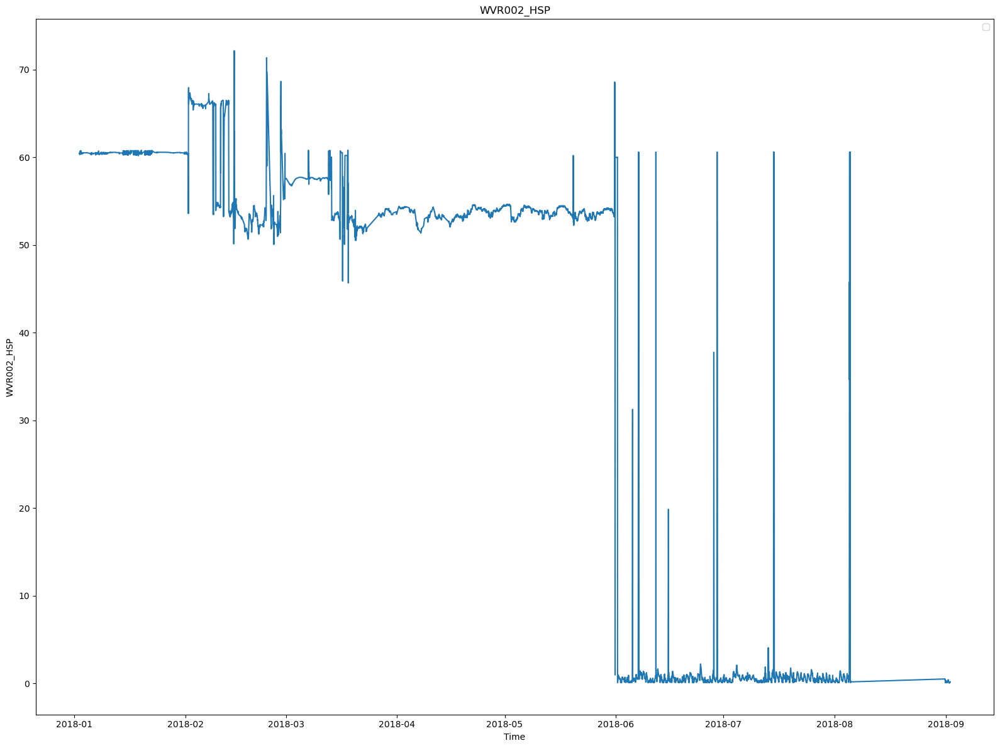

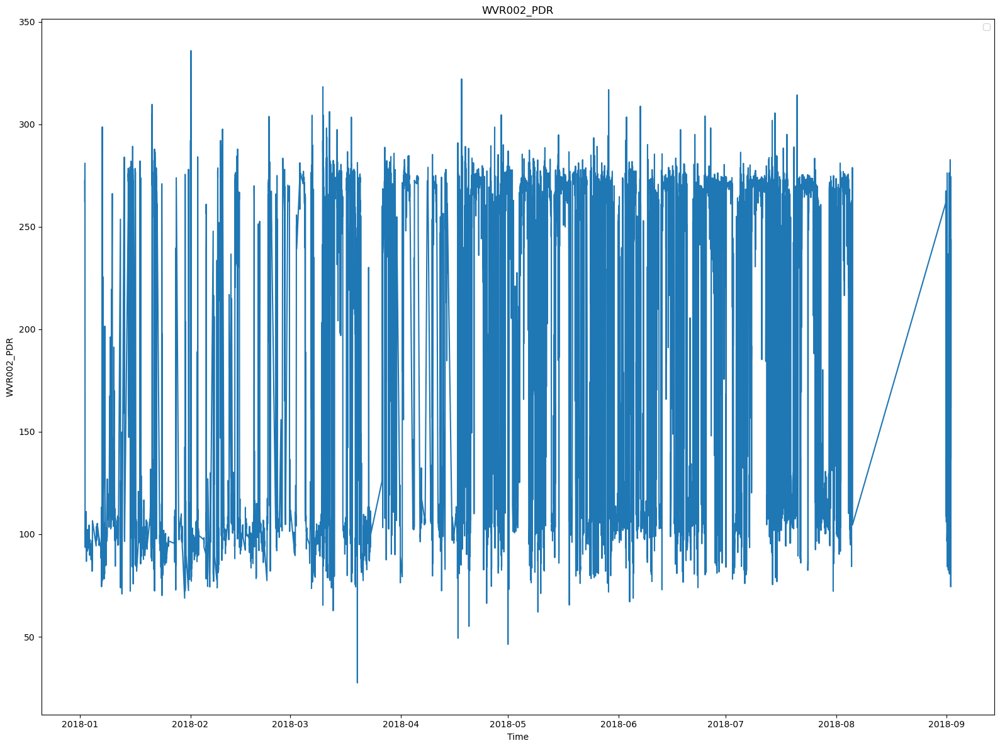

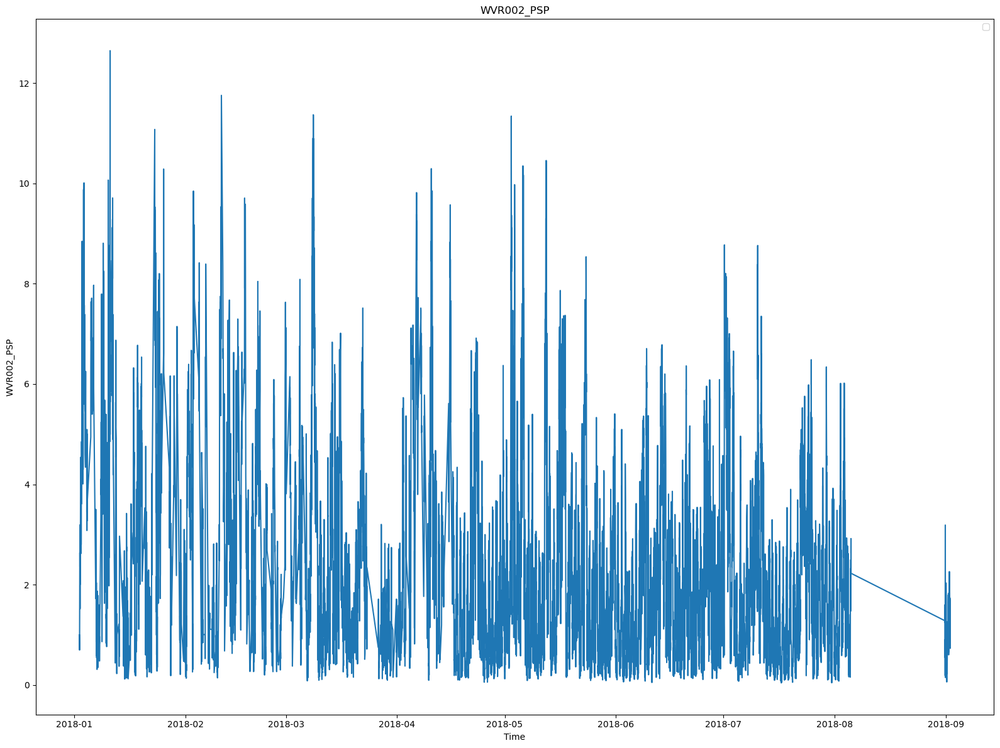

In [45]:
# 시간대별 컬럼 값 보기
for col in columns : 
    if col not in 'datetime' : 
        plt.figure(figsize=(16,12))
        plt.plot(data['datetime'], data[col])
        plt.title(col)
        plt.xlabel('Time')
        plt.ylabel(col)
        plt.grid
        plt.legend()
        plt.tight_layout()
        plt.show()

## 📊 Insight Summary

### 1. 데이터가 8월 ~ 9월 사이 끊겨있음 → 모델 학습의 시간적 연속성 손상
- 시계열 모델(LSTM, GRU 등)은 **연속성이 핵심 요소**임.  
- 중간 구간이 비어 있으면 **예측 정확도 및 패턴 학습 능력 저하**.  
- **조치 방향:** 해당 구간은 제외하거나, `interpolation` 또는 `resampling`으로 보정.

---

### 2. 중간중간 결측치 존재 → 보강 필요 (Interpolation, Forward Fill 등)
- 센서 오류나 통신 지연으로 인한 결측 구간 다수 존재.  
- **짧은 결측**은 선형 보간, **긴 결측**은 “센서 장애 이벤트”로 라벨링하는 것이 적절.  
- **조치 방향:** `linear` / `time` / `spline` 보간법 테스트 후 최적 방식 적용.

---

### 3. 센서별 값의 범위 차이 큼 → Scaling 필요
- 센서 단위가 제각각임 (예: m/s², kPa, ℃ 등).  
- 단위 차이가 크면 학습 시 특정 변수에 **가중치 쏠림 현상** 발생.  
- **조치 방향:**  
  - 진동/가속도 계열 → `StandardScaler`  
  - 온도/풍속 계열 → `MinMaxScaler`

---

### 4. 이상치(Outlier) 존재 → 이상감지 기준 수립 필요
- 단순한 큰 값이 아닌, “평균으로부터 급격히 벗어난 패턴”을 감지해야 함.  
- **고려 방법:**  
  - `Z-score` 기반 (|z| > 3)  
  - `IQR` 기반 (Q1 - 1.5×IQR, Q3 + 1.5×IQR)  
  - `Residual` 기반 (예측모델 대비 오차 분석)  
- **추가 판단:** 센서 이상인지, 실제 구조 이상인지 구분 필요.

---

### 5. 센서 간 상관관계(Feature Dependency) 존재
- 예: `WGT001` ↔ `WVR001`은 상관계수 0.99 이상.  
- 일부 센서는 중복된 정보를 제공하여 모델의 효율 저하 유발.  
- **조치 방향:** PCA, VIF 등을 통해 다중공선성 제거 및 Feature Selection 수행.

---

### 6. 센서 그룹별 패턴 유형 차이
- `ACC`, `EQK` 등 → 고주파 진동 중심  
- `FBT`, `WVR` 등 → 저주파 장기 추세 중심  
- **조치 방향:** 그룹별로 개별 모델 설계 (예: 진동 예측용, 환경 영향용 등).

---

### 7. 데이터 품질 관리(QA) 필요
- 일부 센서가 0 또는 일정값으로 수렴 → **센서 단선/고장 가능성**.  
- 센서별 **R², Missing Rate, Variance Stability** 등을 기준으로  
  신뢰도 점수 산출 후 Invalid Sensor 자동 필터링 필요.

---

### 8. 비정상 시계열(Non-Stationary) 가능성
- 특정 센서(`FBT011`, `WVR002_HDR`)는 시간에 따라 평균값이 이동.  
- 이는 비정상 시계열로 모델 학습 시 Drift 발생 위험.  
- **조치 방향:** `Differencing`, `Detrending`, 또는 `Rolling Mean Subtraction` 수행.

---

# 2. 정규분포로 보기

In [49]:
# 1. Heatmap부터
numeric_col = [col for col in columns if col not in ['datetime']]
correlation = data[numeric_col].corr()

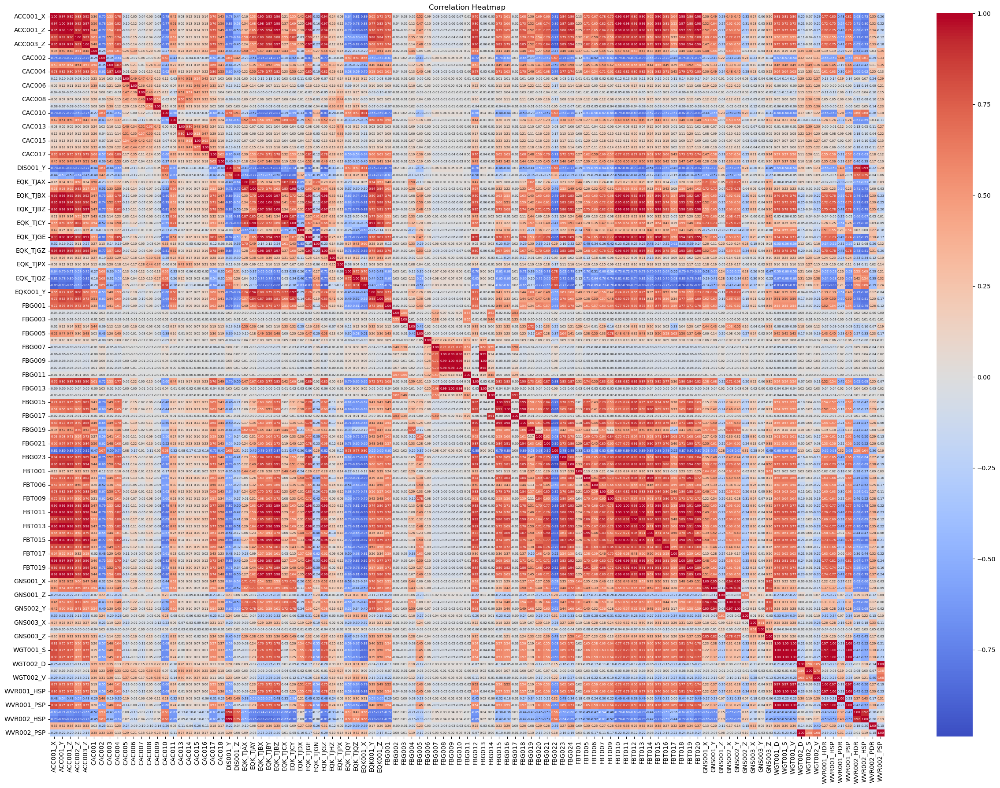

In [59]:
plt.figure(figsize=(25, 18))
sns.heatmap(correlation, cmap='coolwarm', center=0, annot=True, fmt=".2f",
            annot_kws={"size": 5})  # 숫자 크기 줄임
plt.title('Correlation Heatmap')
plt.tight_layout()
plt.savefig("correlation_heatmap.png", dpi=300, bbox_inches='tight')
plt.show()
plt.close()

In [74]:
# 각 컬럼별 0.5이상, -0.5이하 컬럼들
# 1.ACC기준 -> 딕셔너리 형태로 저장
acc_col = [col for col in columns if col.startswith('ACC')]
acc_pas_corr = {}
for col in acc_col : 
    acc_pas_corr[col] = []
    for i in columns : 
        if i not in 'datetime' and i != col : 
            if correlation.loc[col, i] >= 0.5 : 
                acc_pas_corr[col].append(i)

# acc_minus_corr
acc_minus_corr = {}
for col in acc_col : 
    acc_minus_corr[col] = []
    for i in columns : 
        if i not in 'datetime' and i != col :
            if correlation.loc[col, i] <= -0.5 : 
                acc_minus_corr[col].append

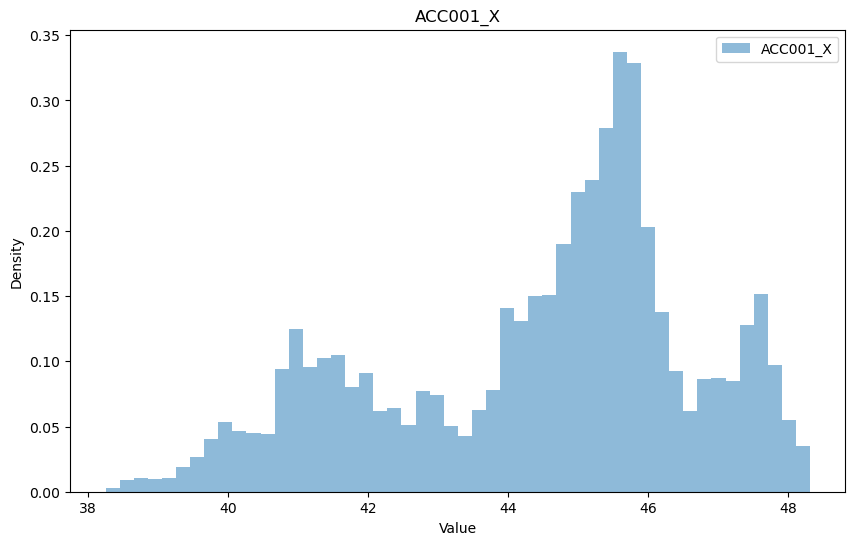

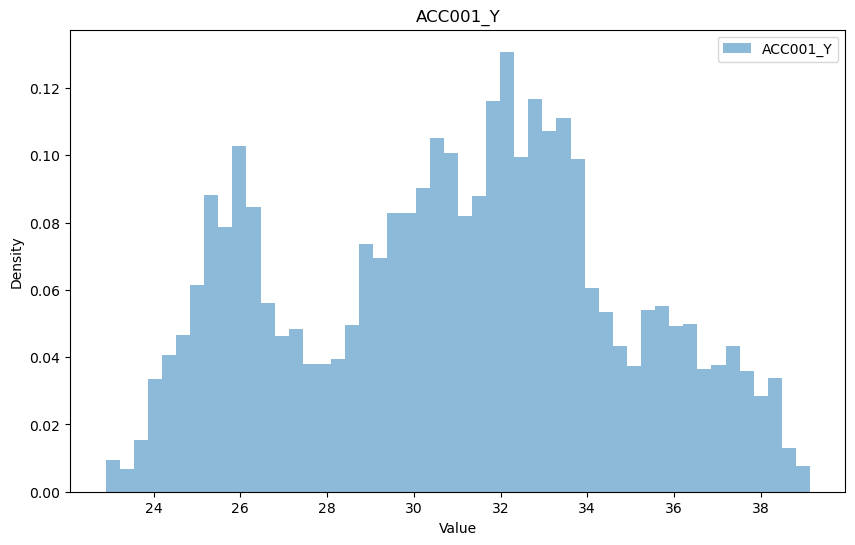

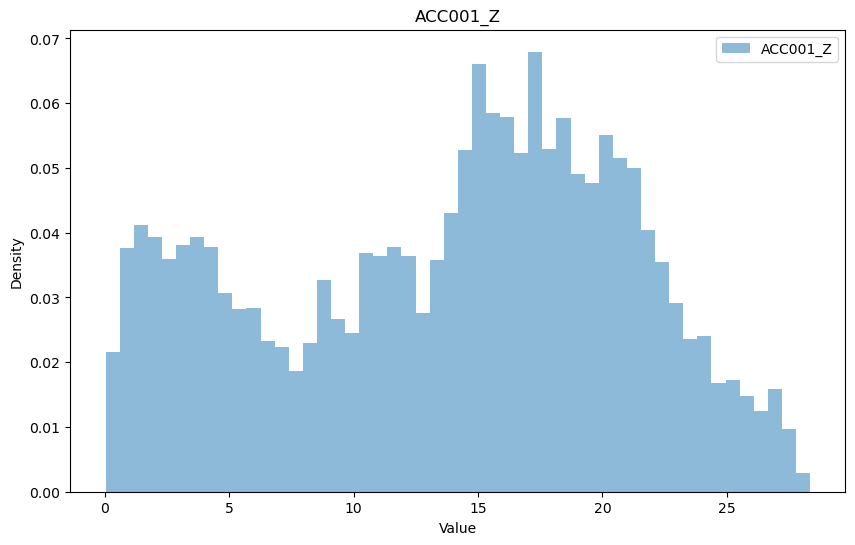

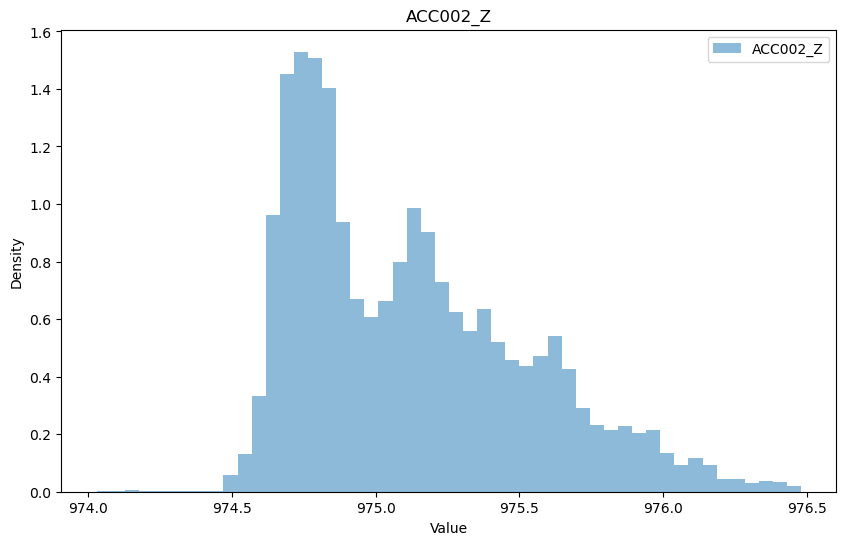

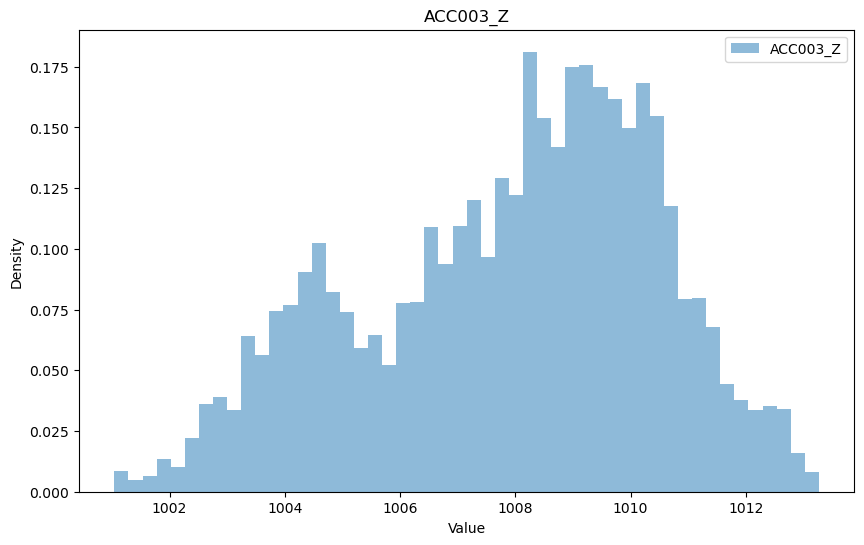

...

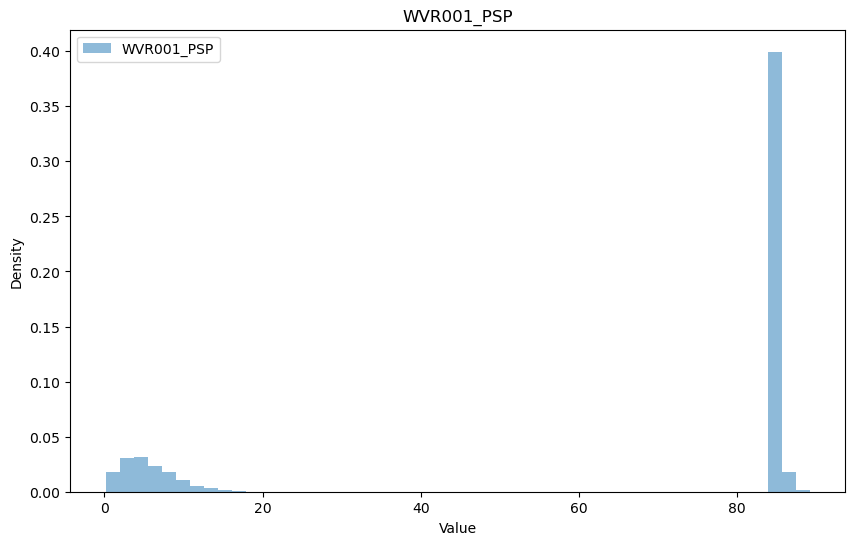

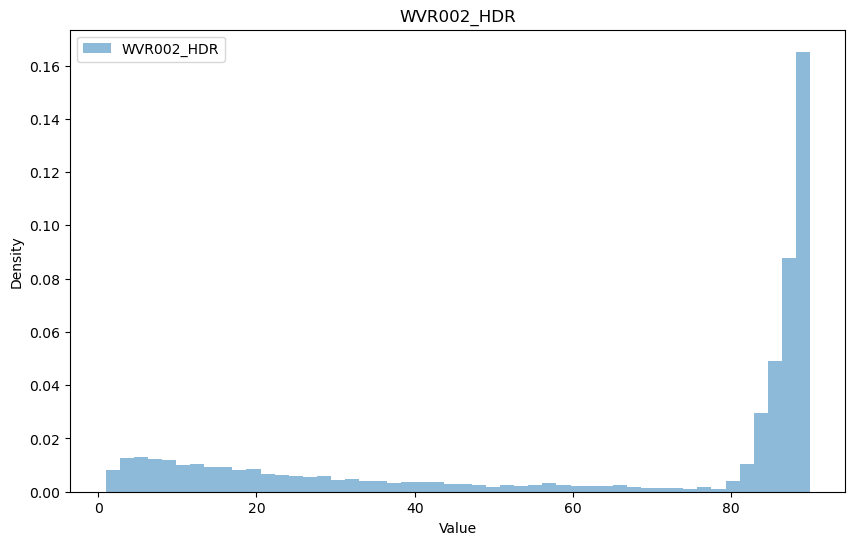

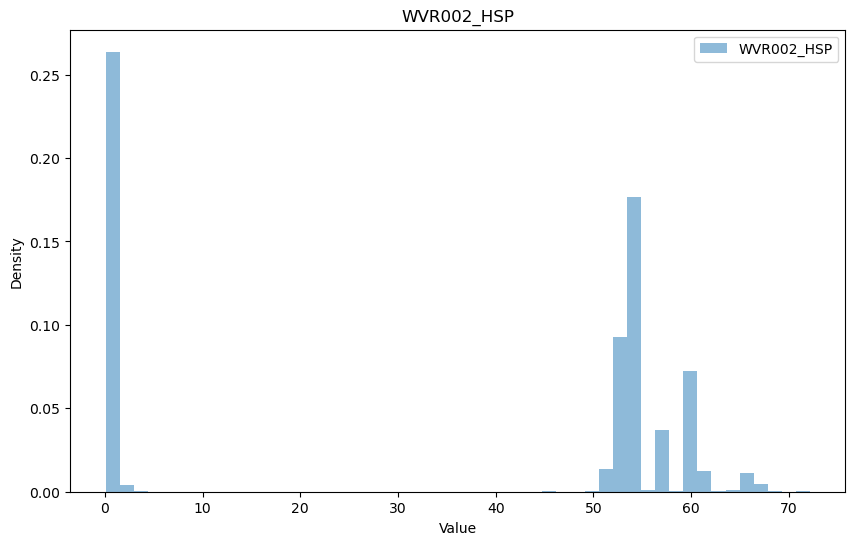

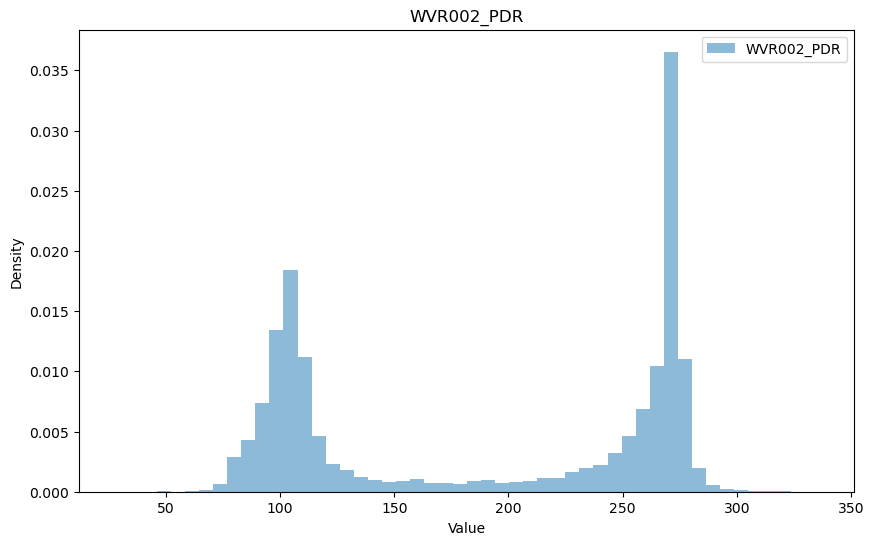

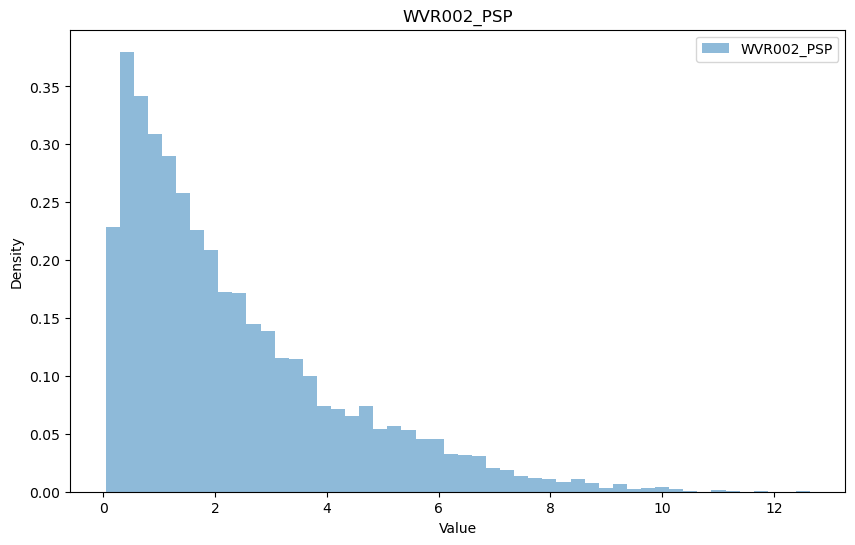

In [ ]:
# 정규분포 그려보기

for col in columns : 
    if col not in 'datetime' :
        plt.figure(figsize =(10,6))
        plt.hist(data[col], bins = 50, density=True, alpha = 0.5, label = col)
        # 정규 분포 곡선 추가
        mu = data[col].mean()
        sigma = data[col].std()
        x = np.linspace(data[col].min(), data[col].max(), 100)

        plt.title(col)
        plt.xlabel('Value')
        plt.ylabel('Density')
        plt.legend()
        plt.show()


C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


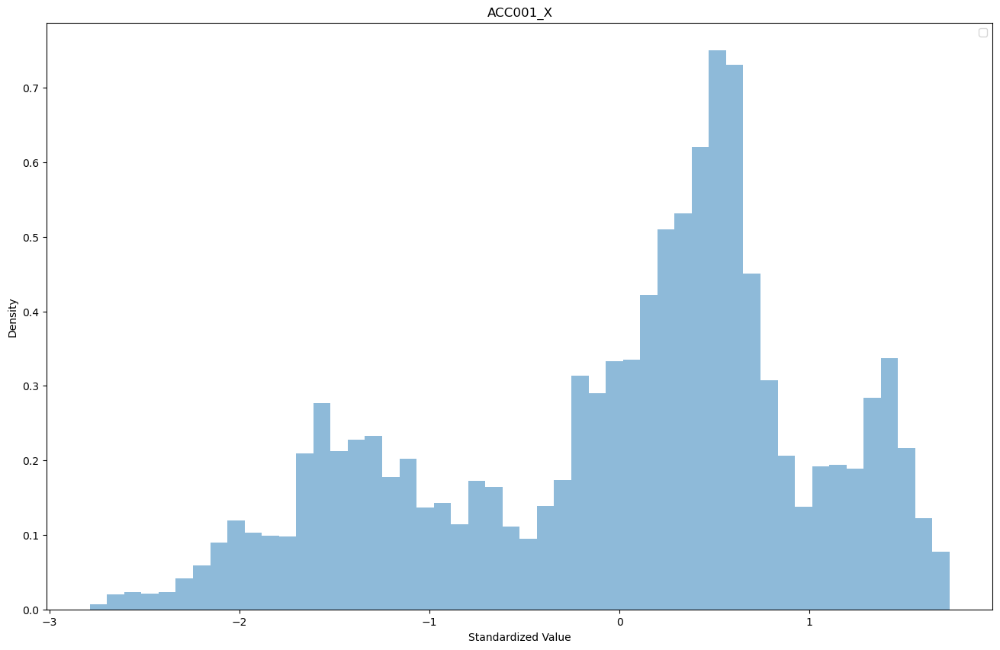

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


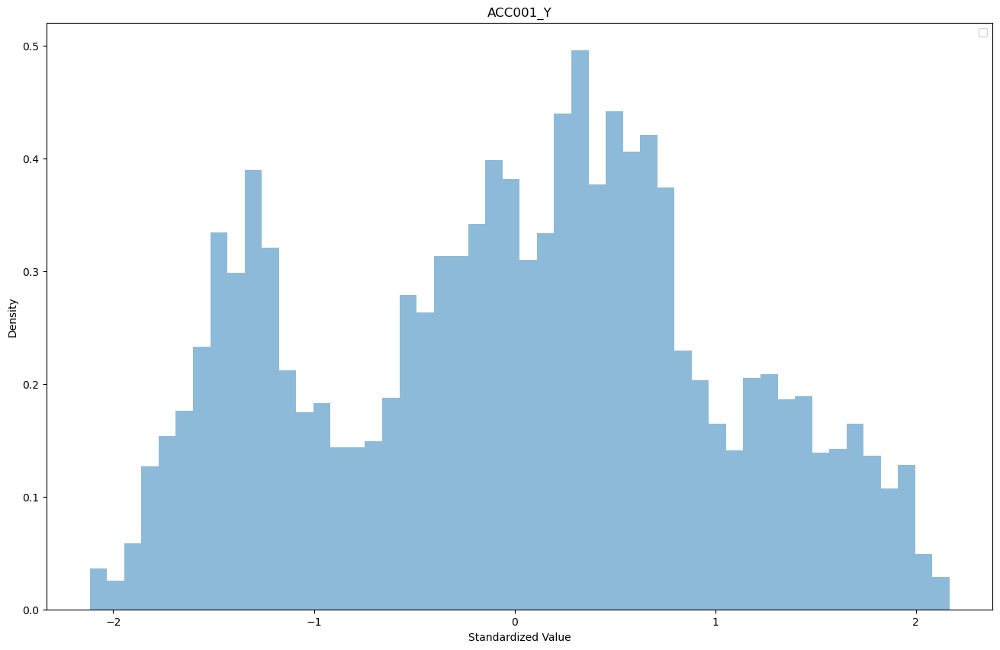

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


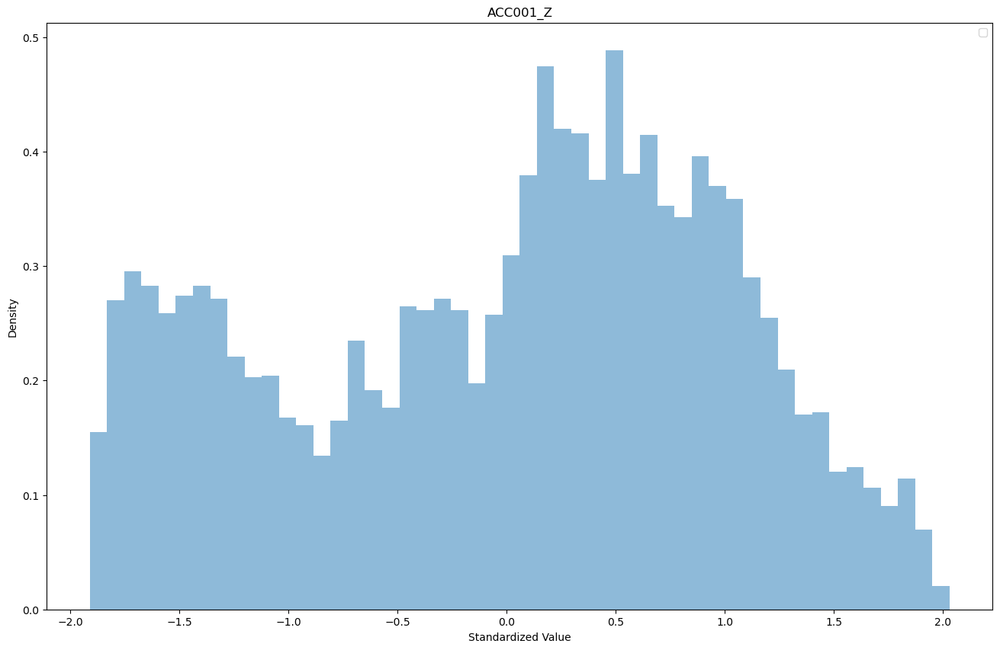

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


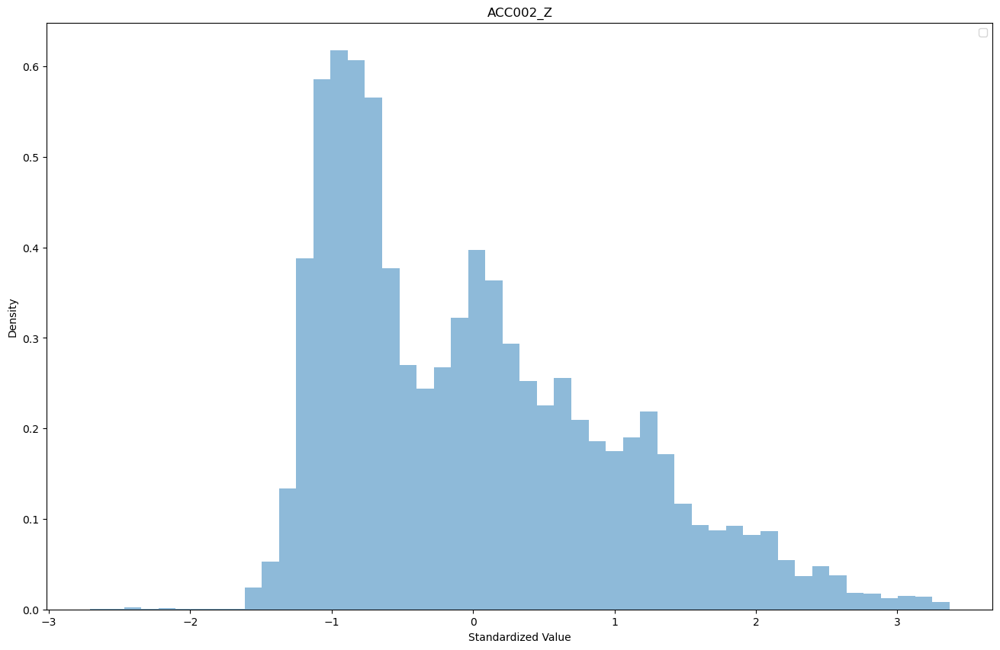

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


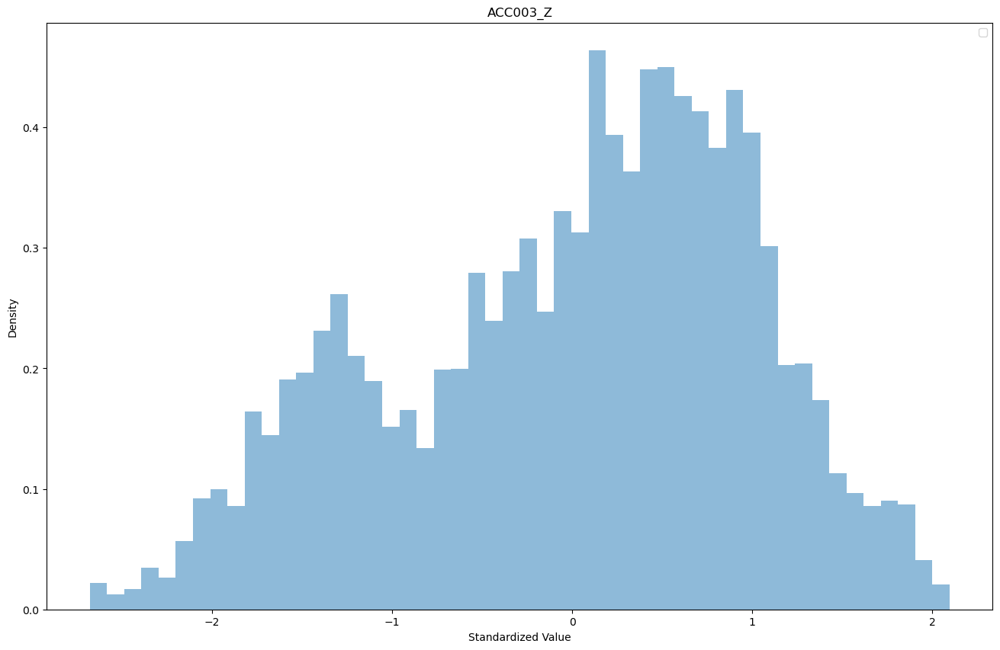

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


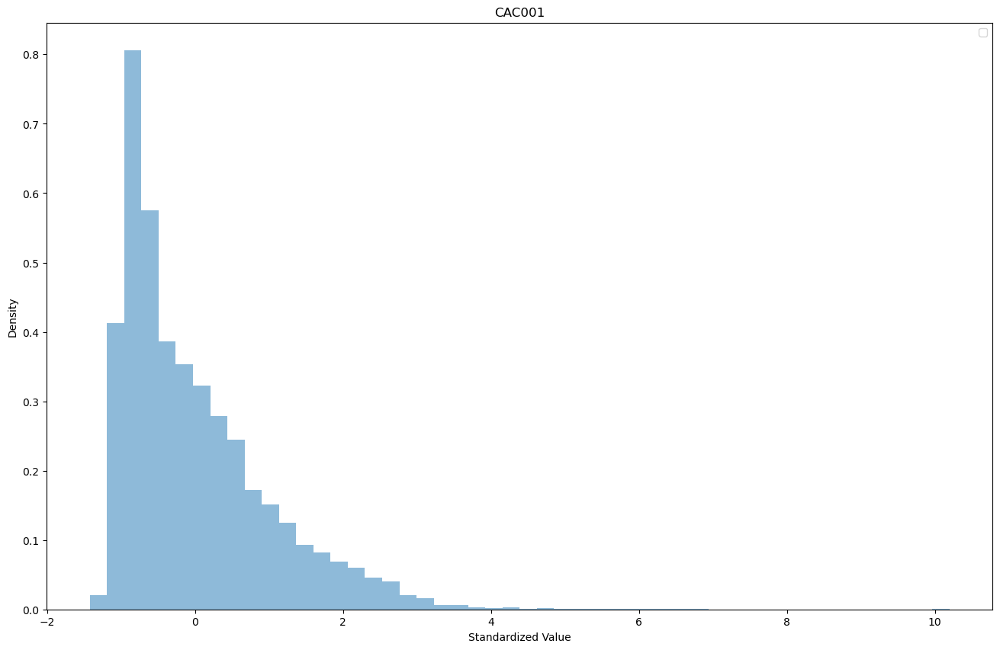

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


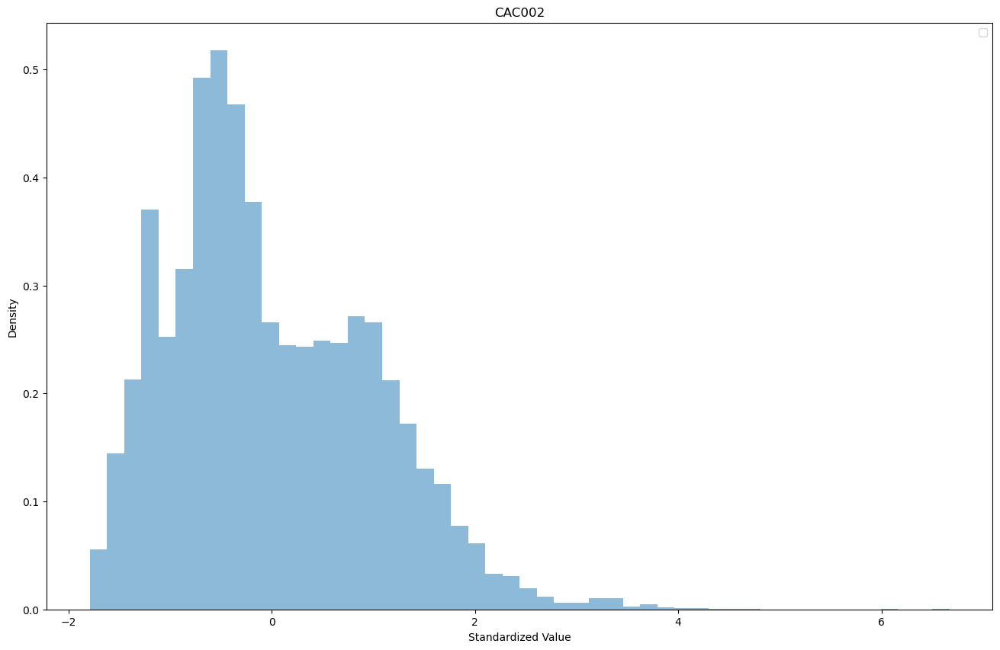

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


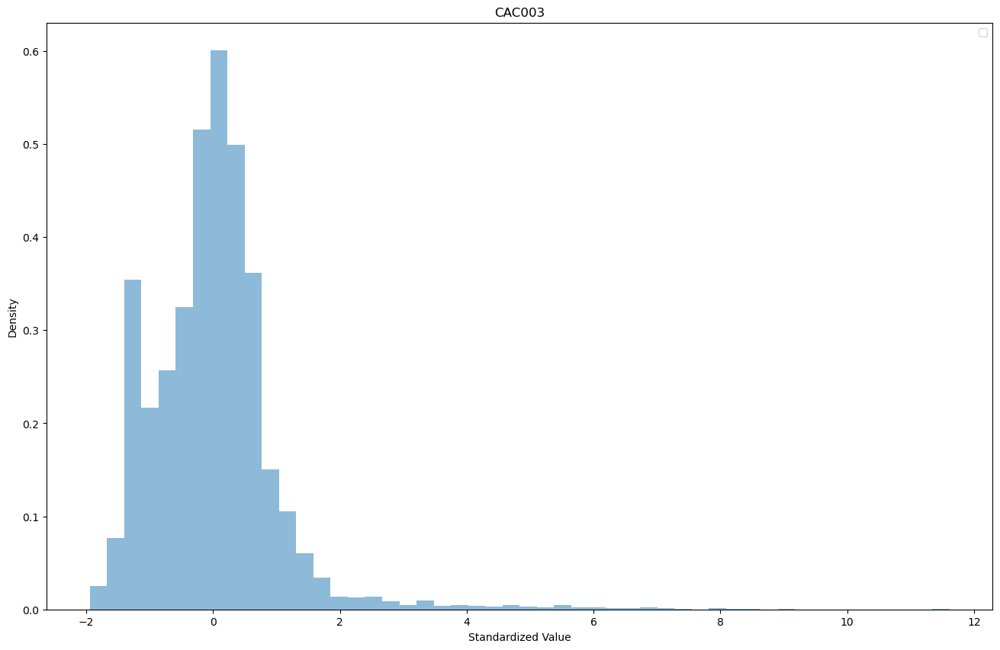

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


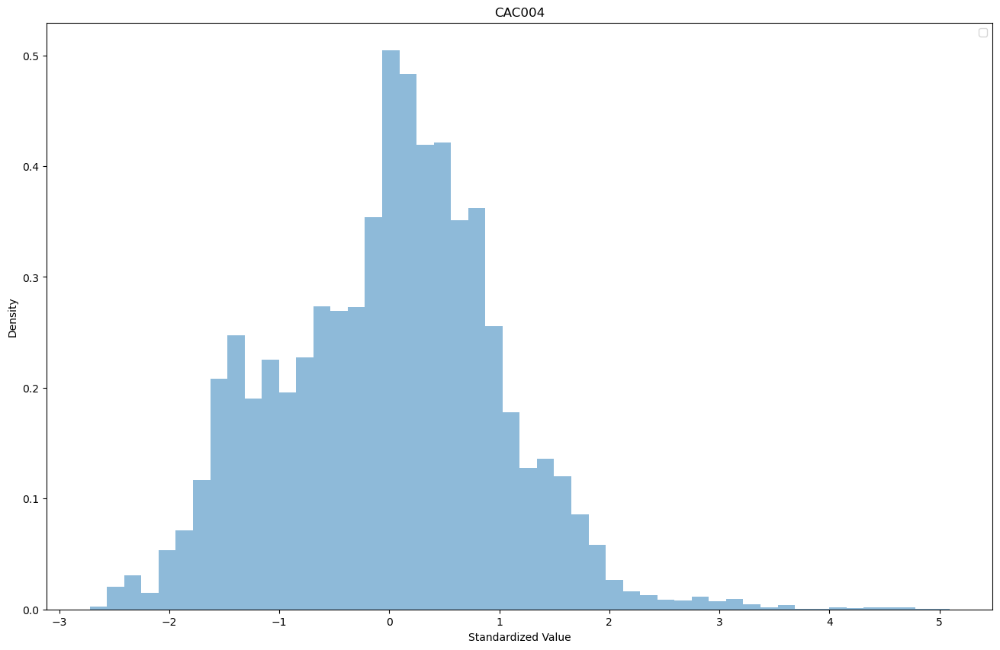

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


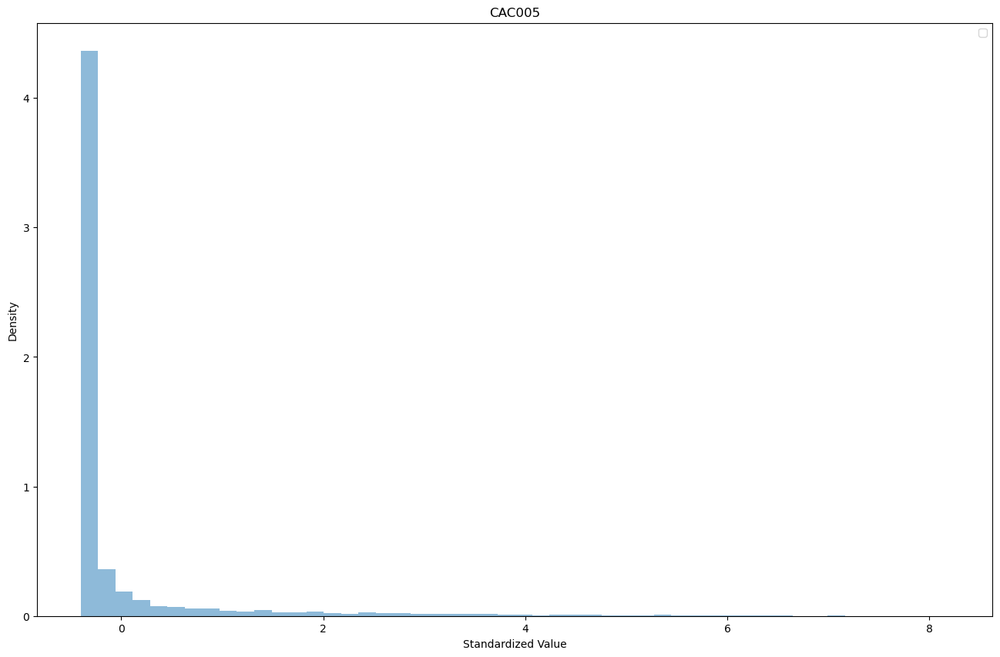

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


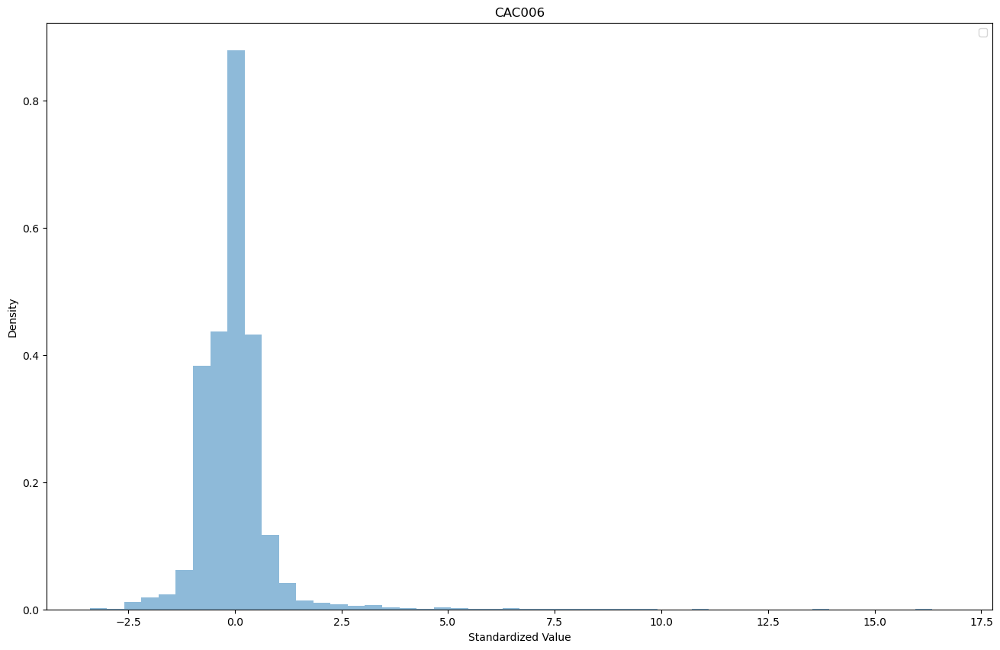

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


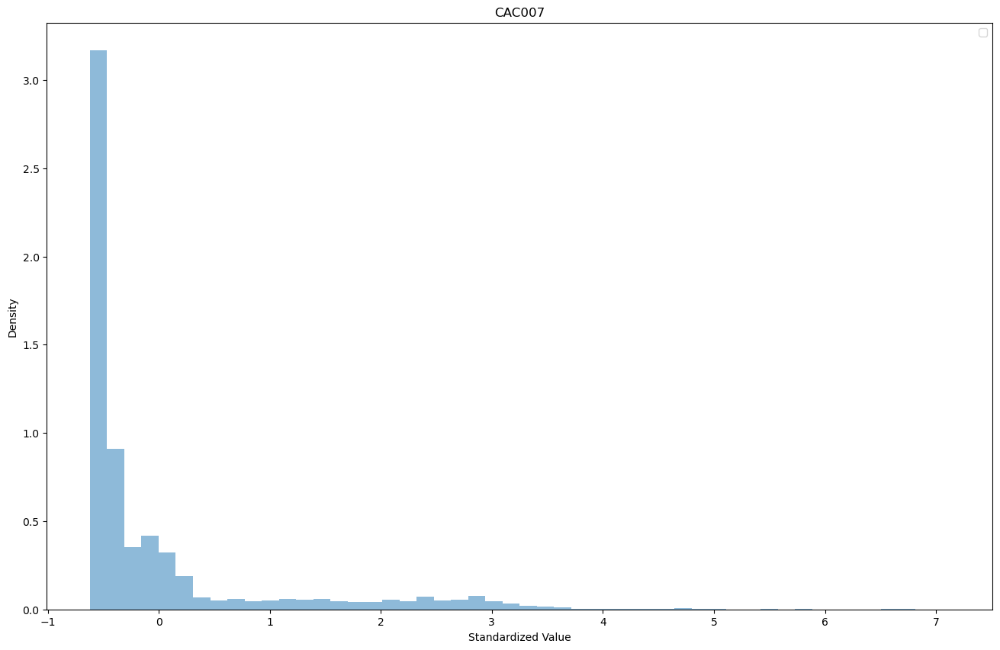

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


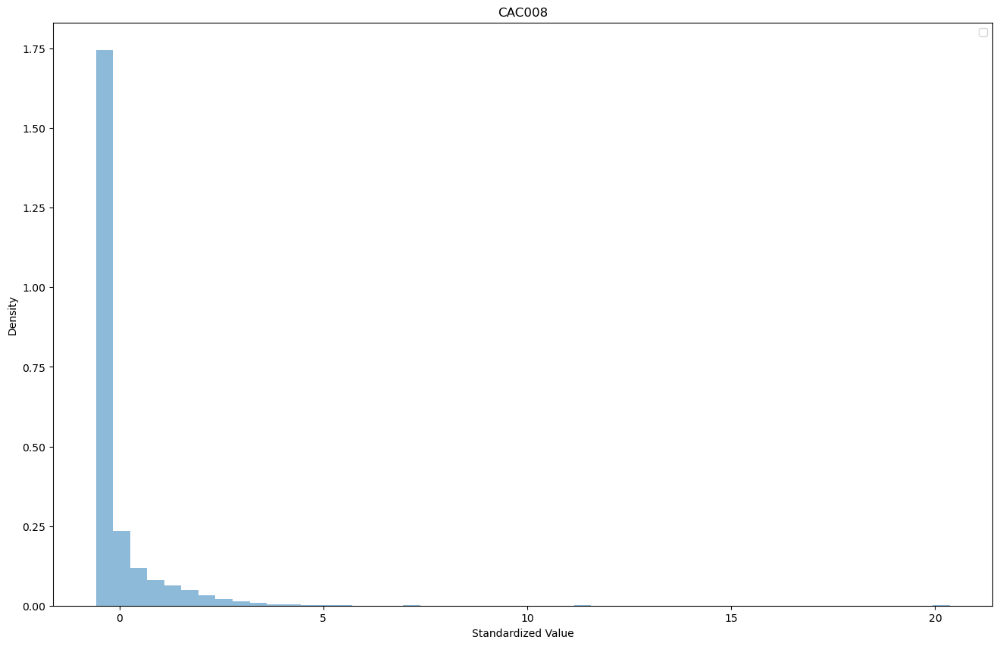

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


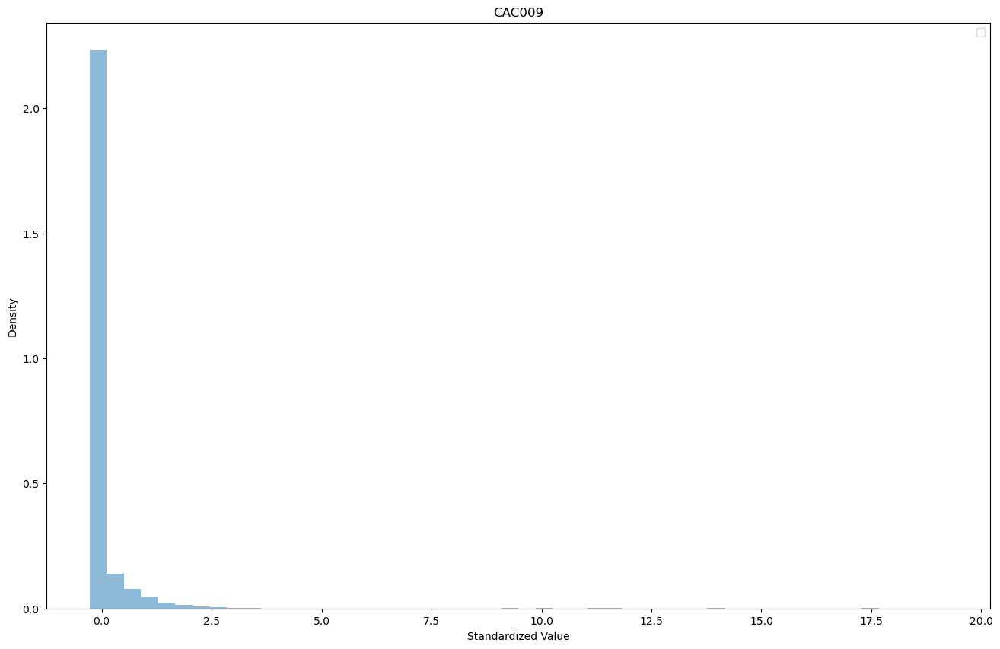

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


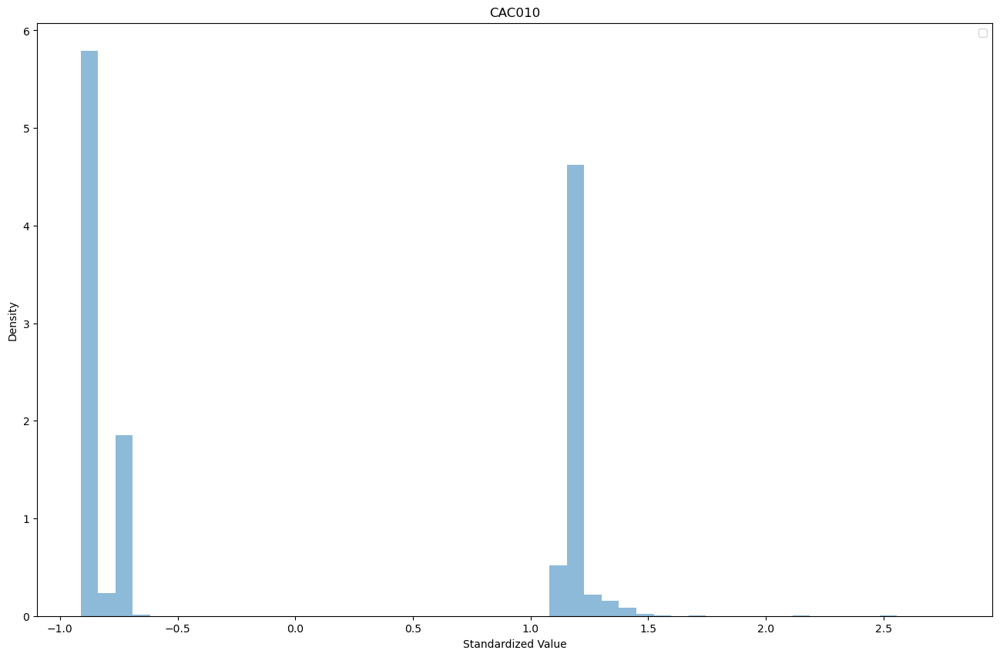

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


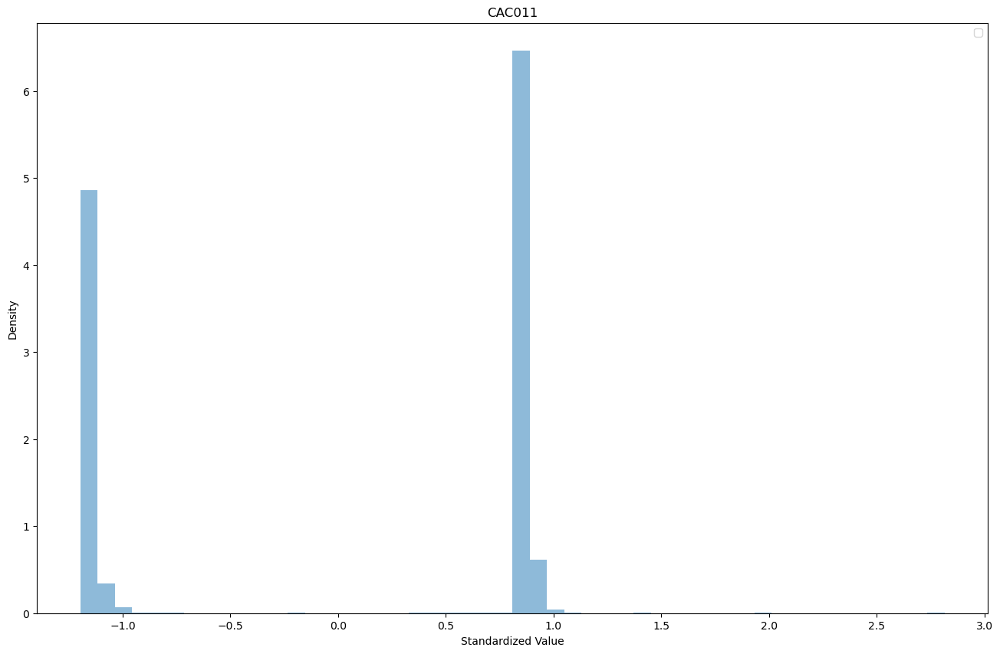

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


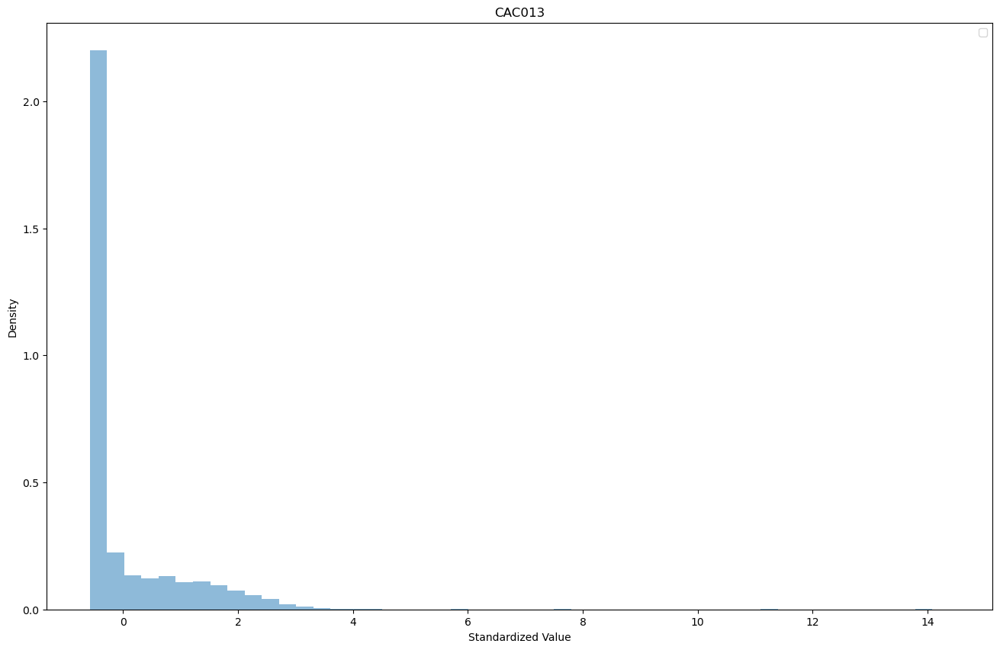

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


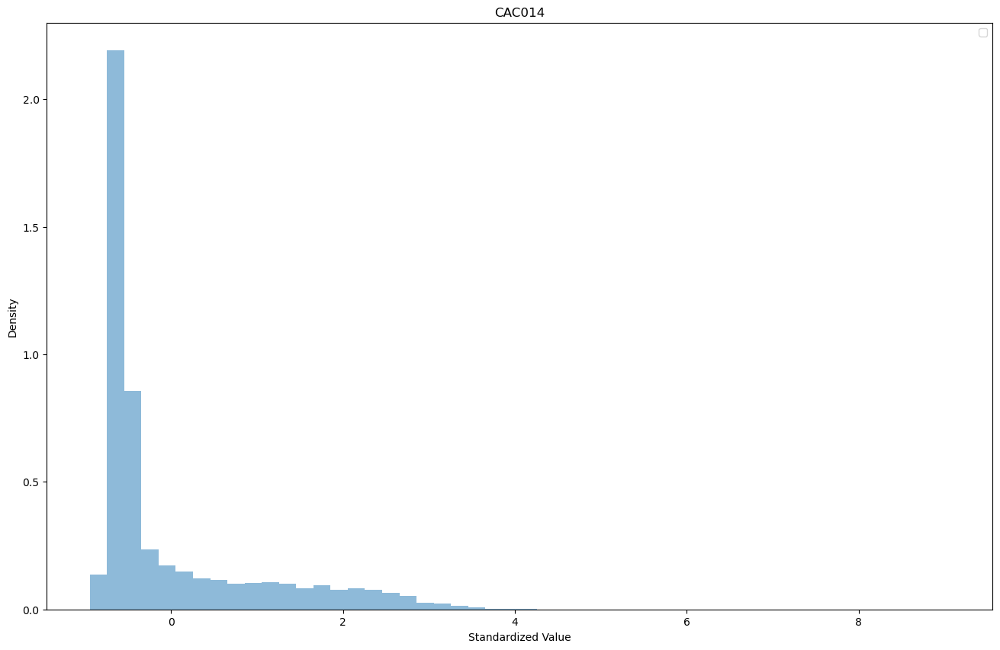

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


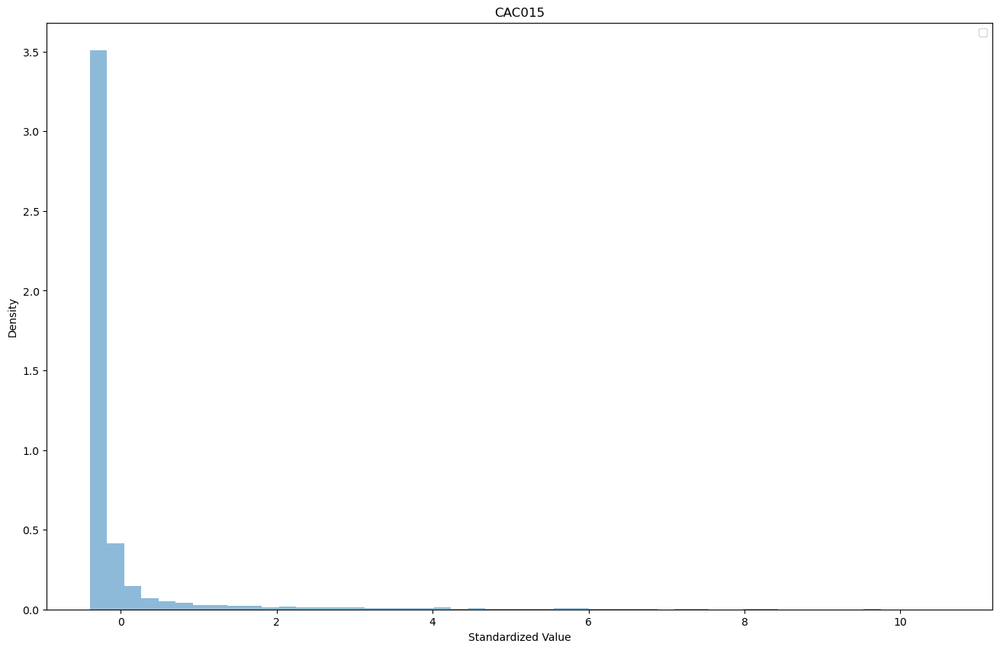

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


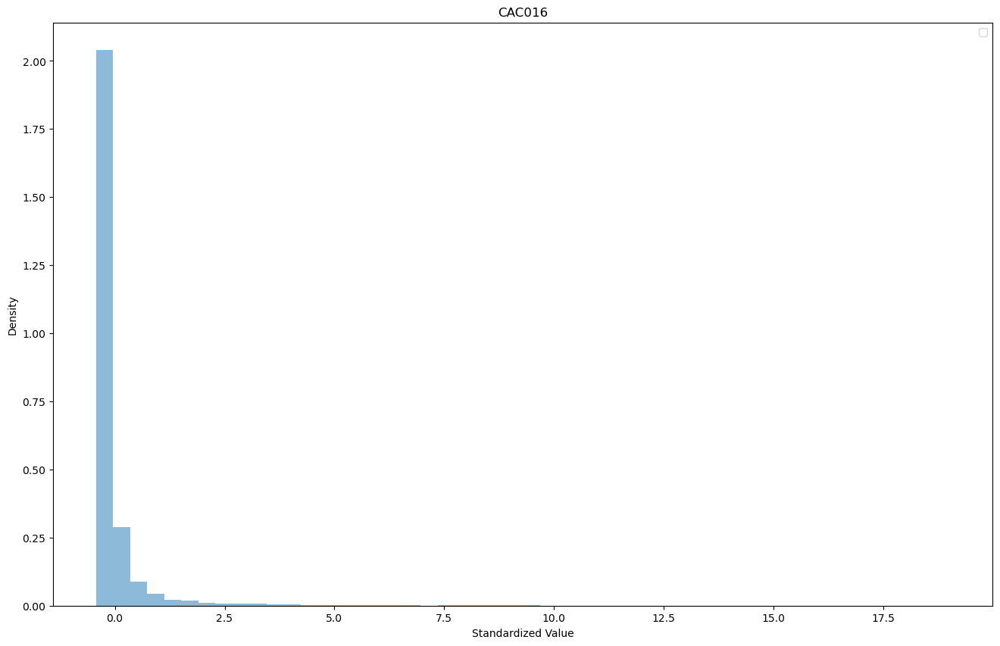

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


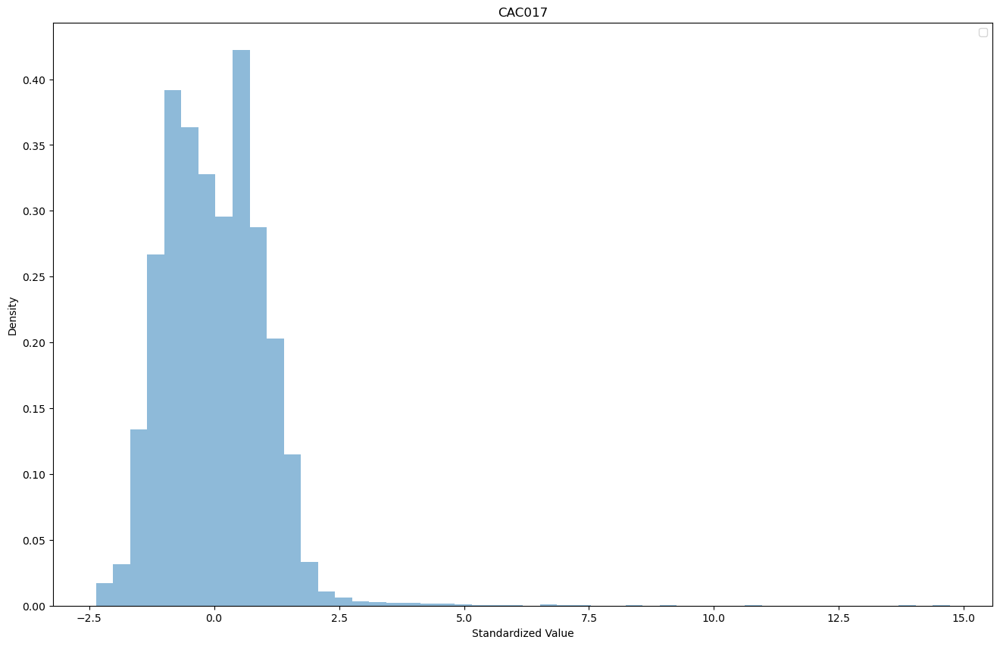

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


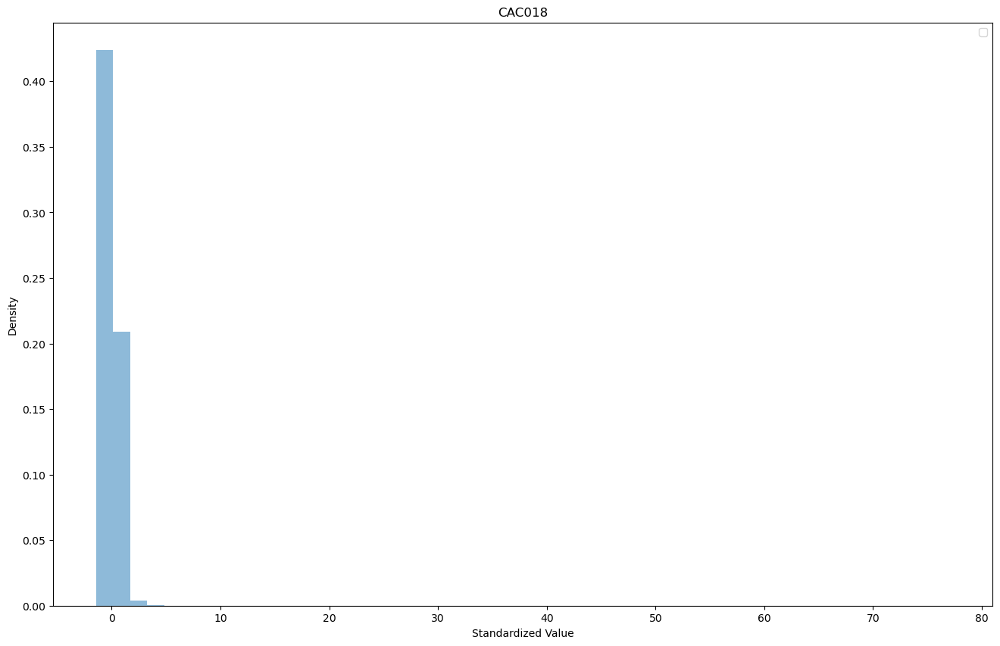

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


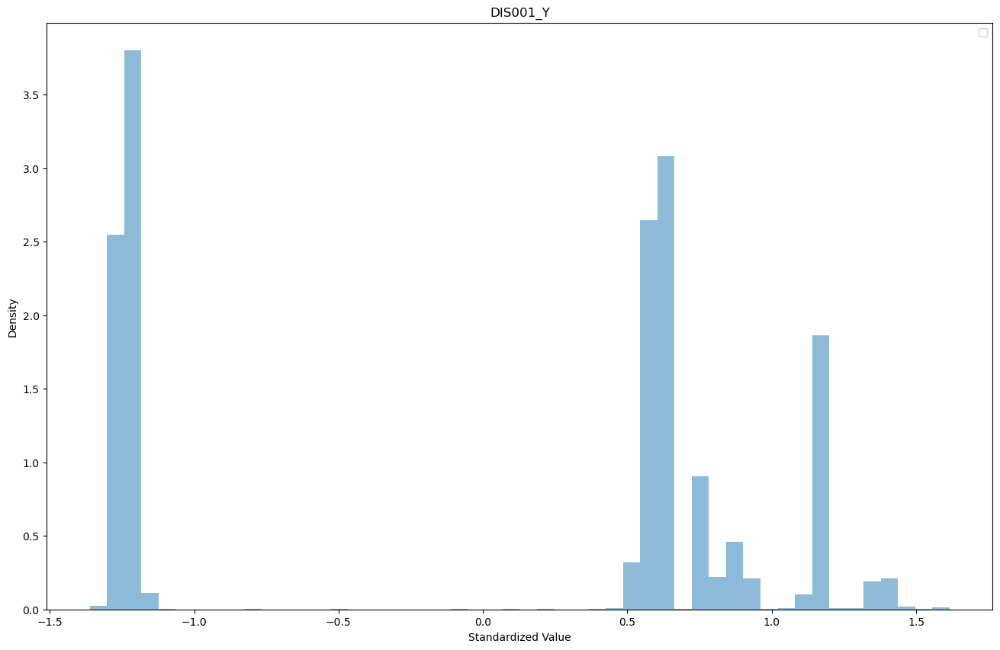

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


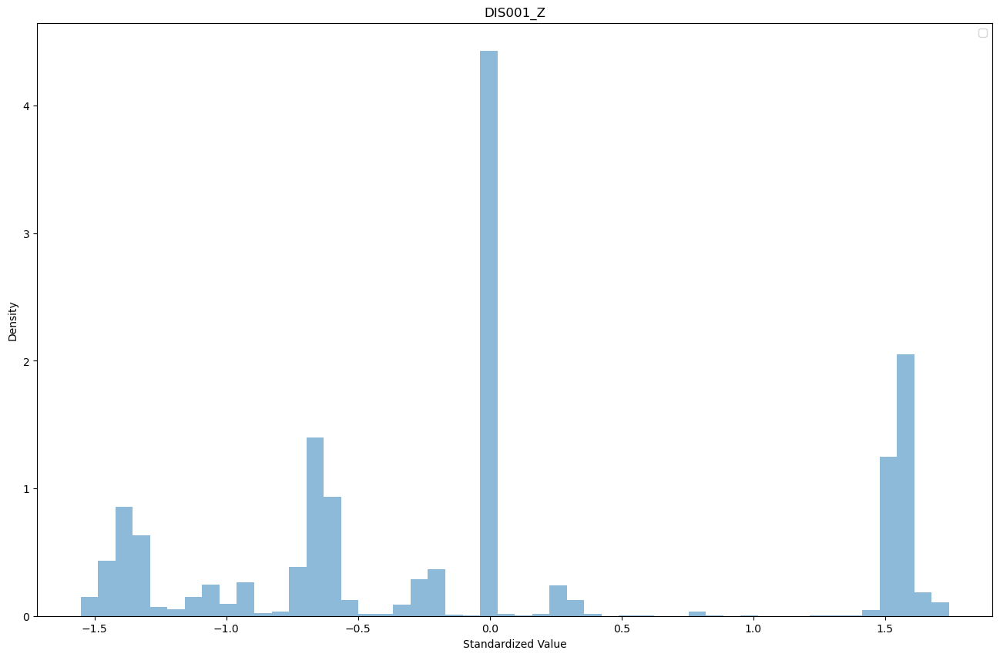

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


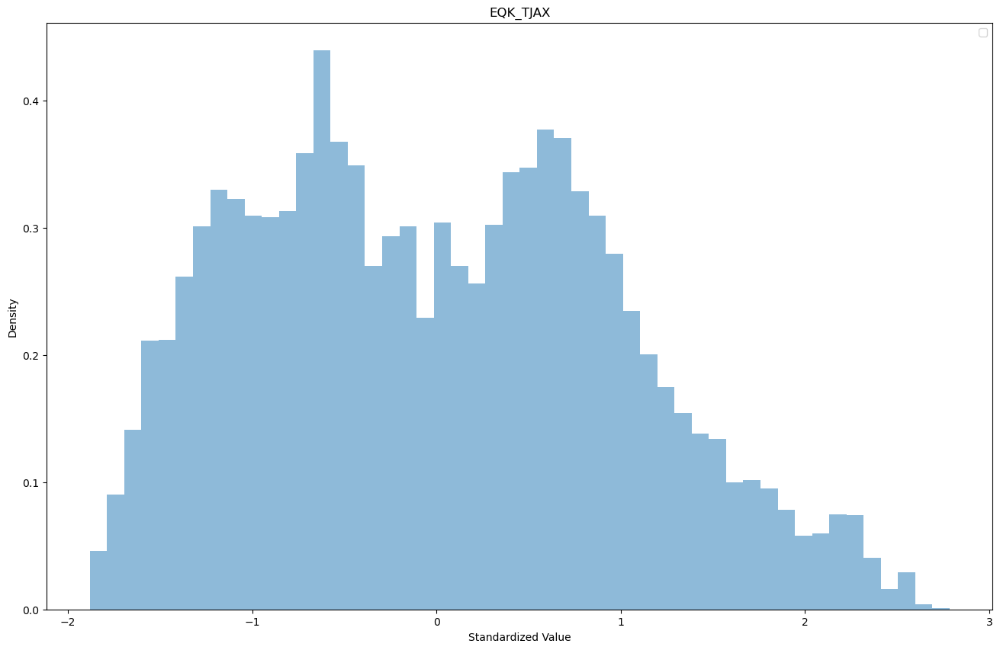

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


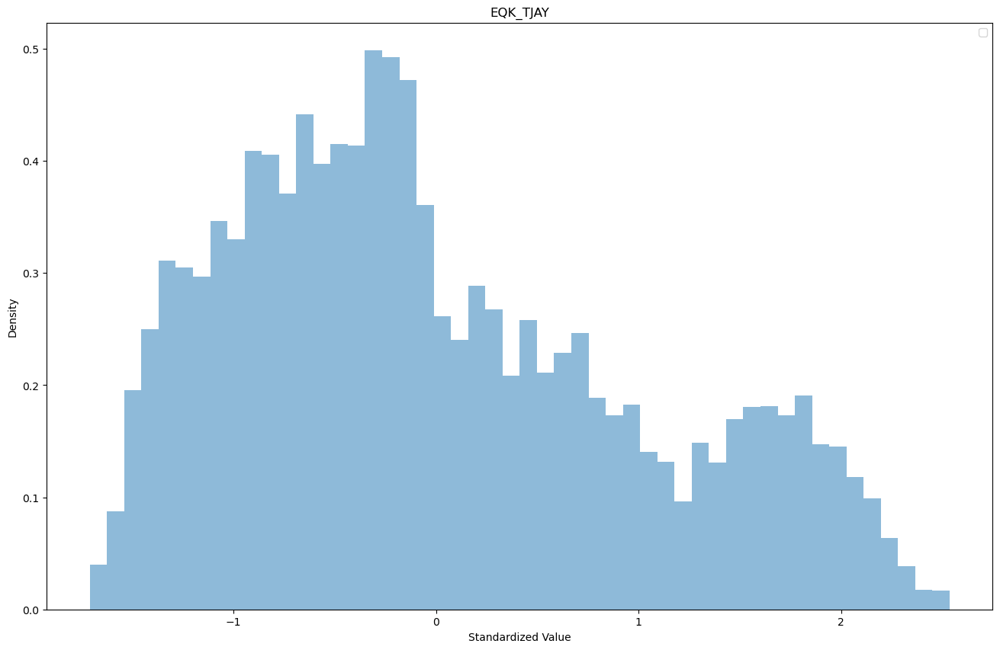

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


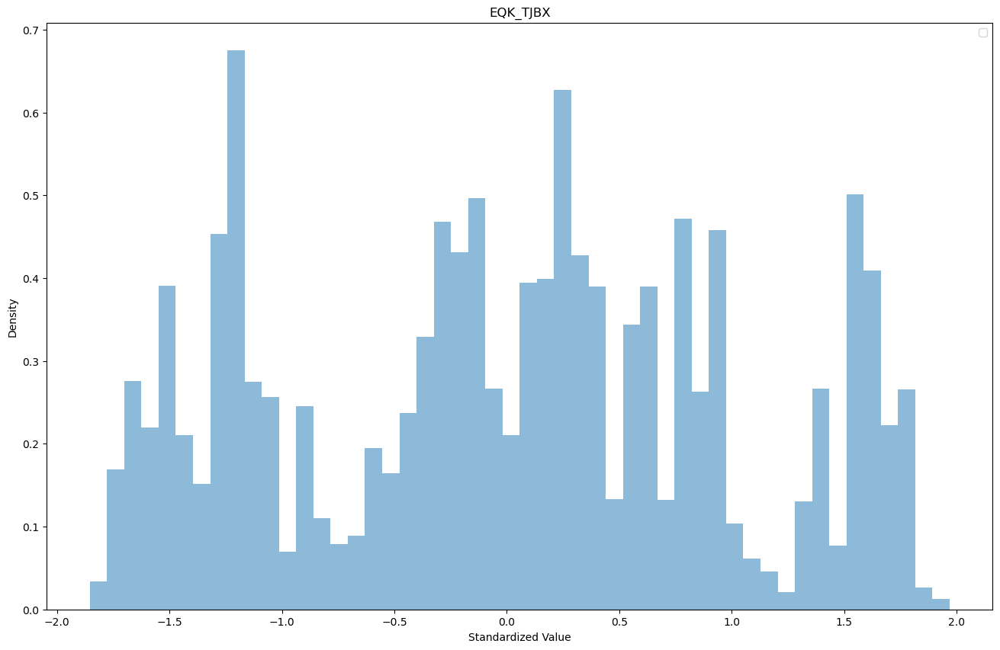

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


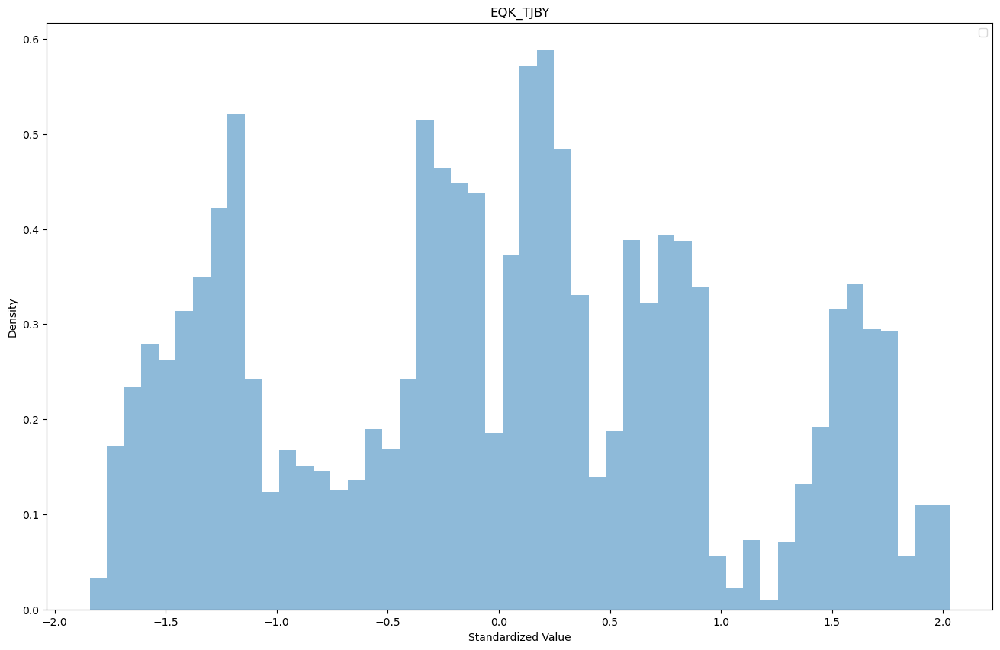

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


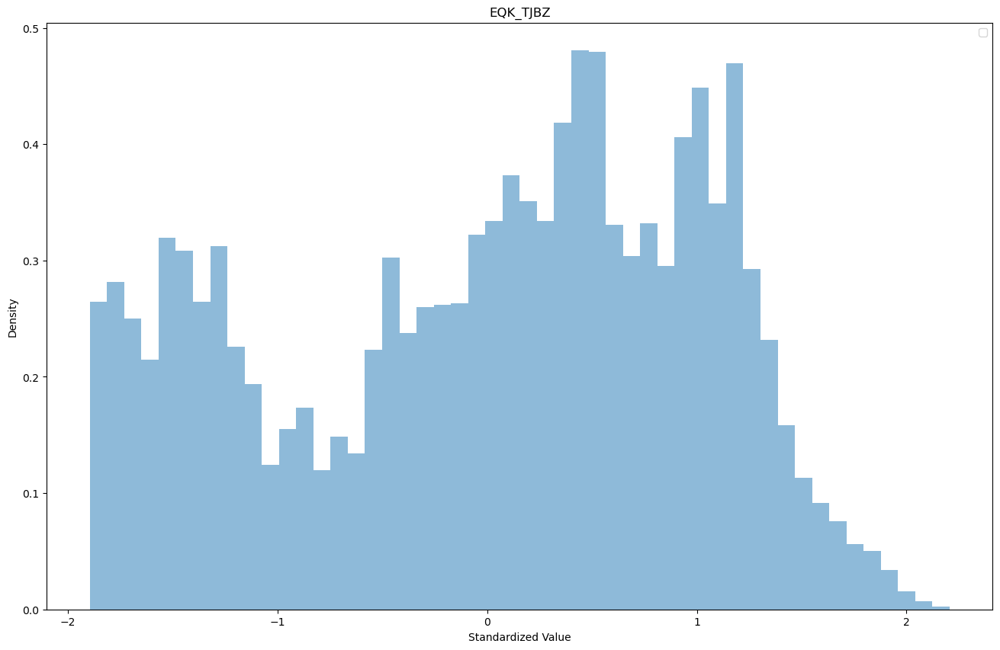

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


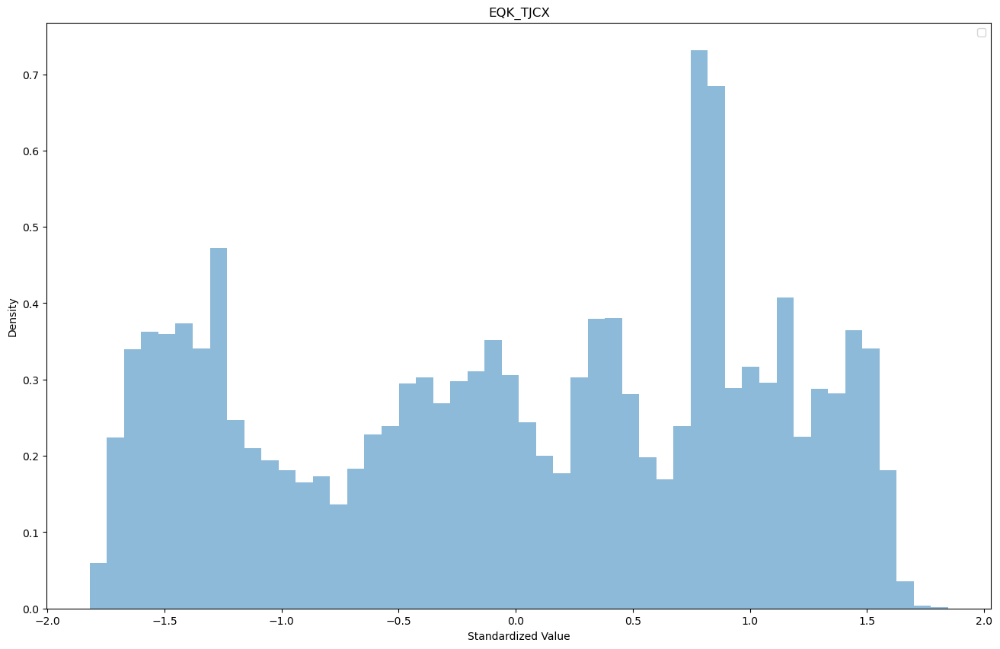

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


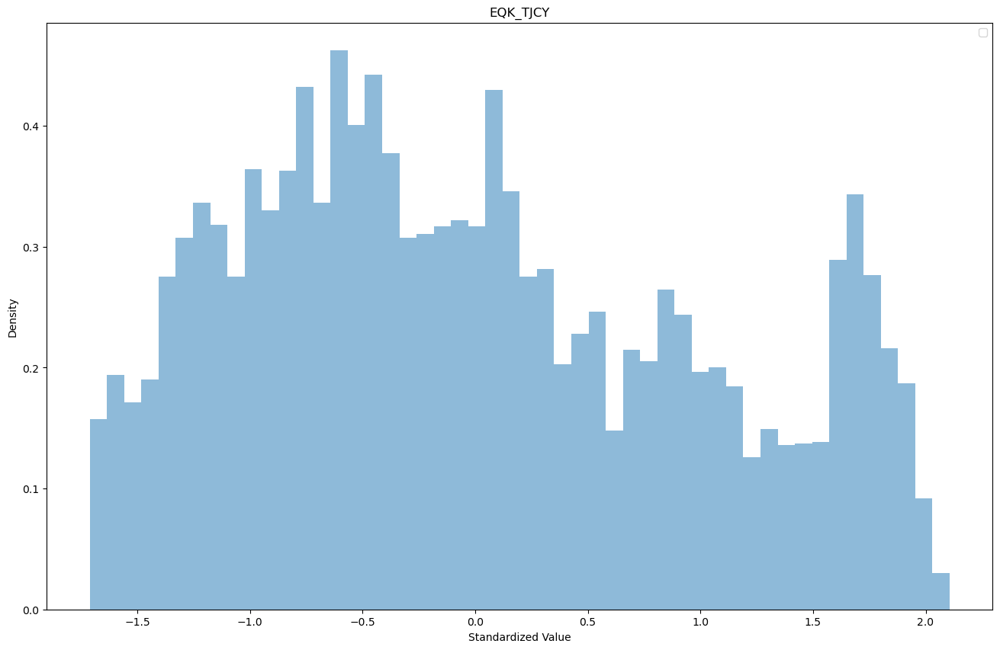

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


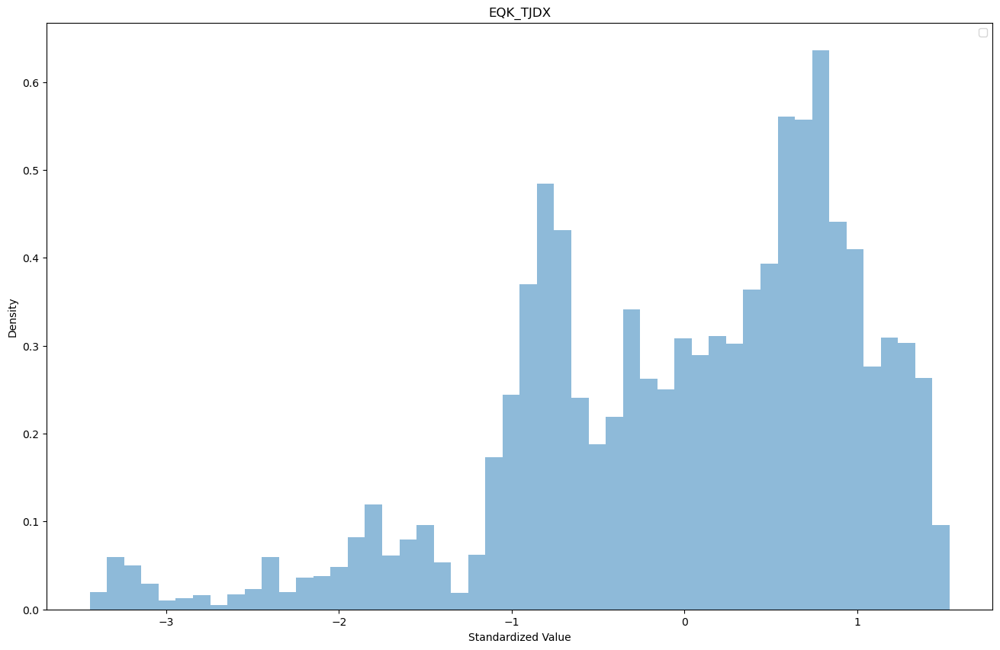

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


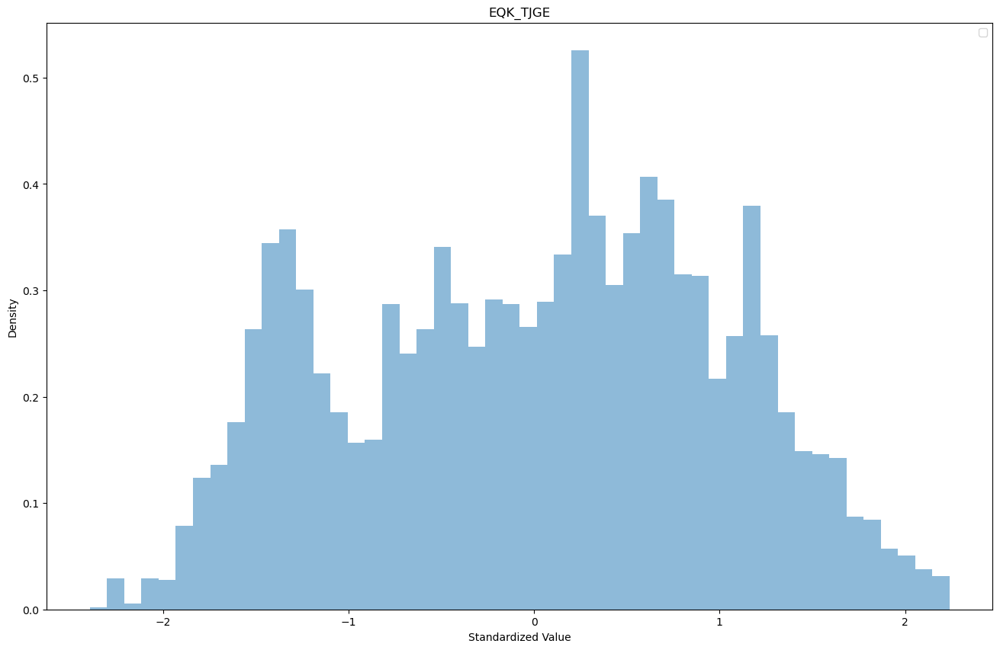

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


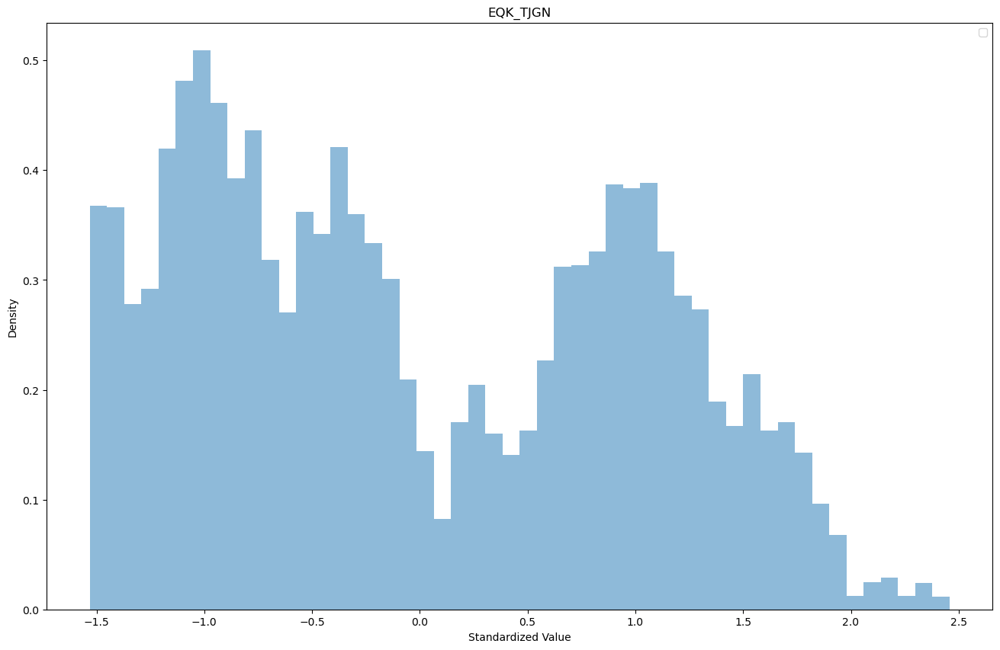

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


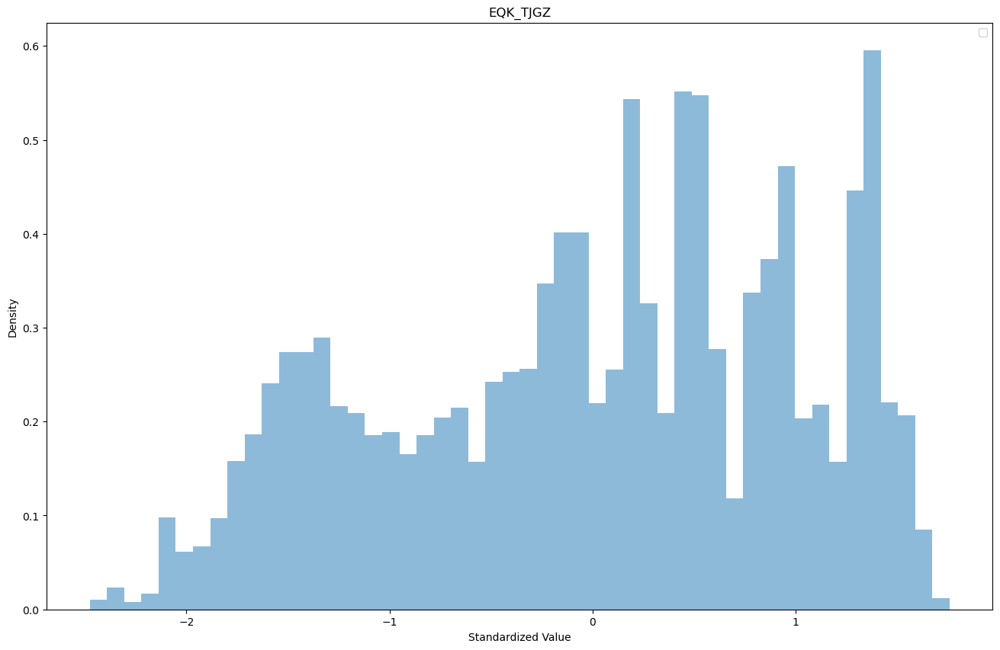

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


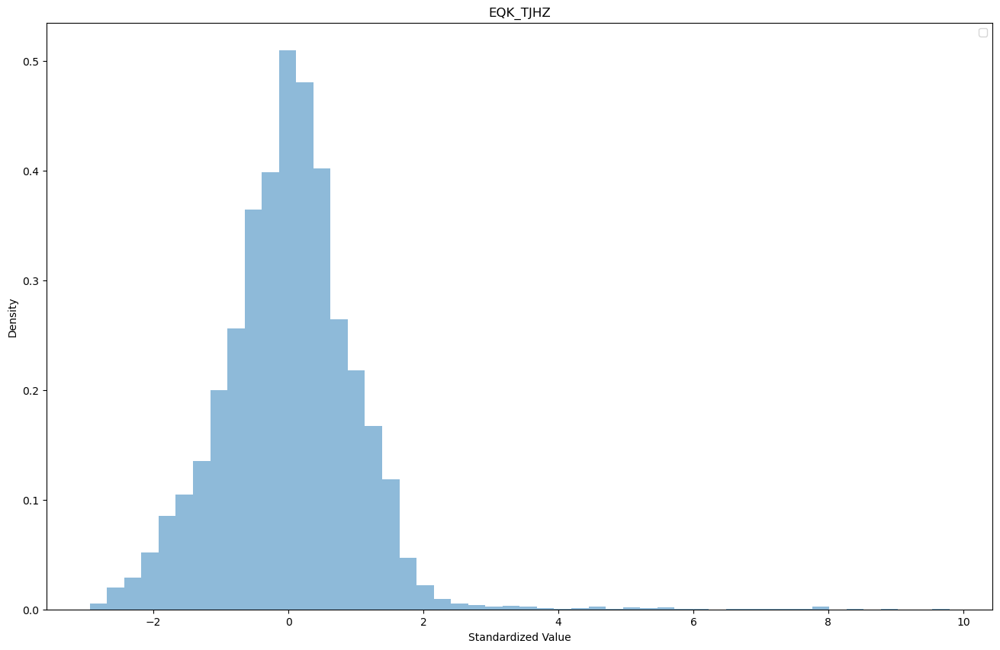

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


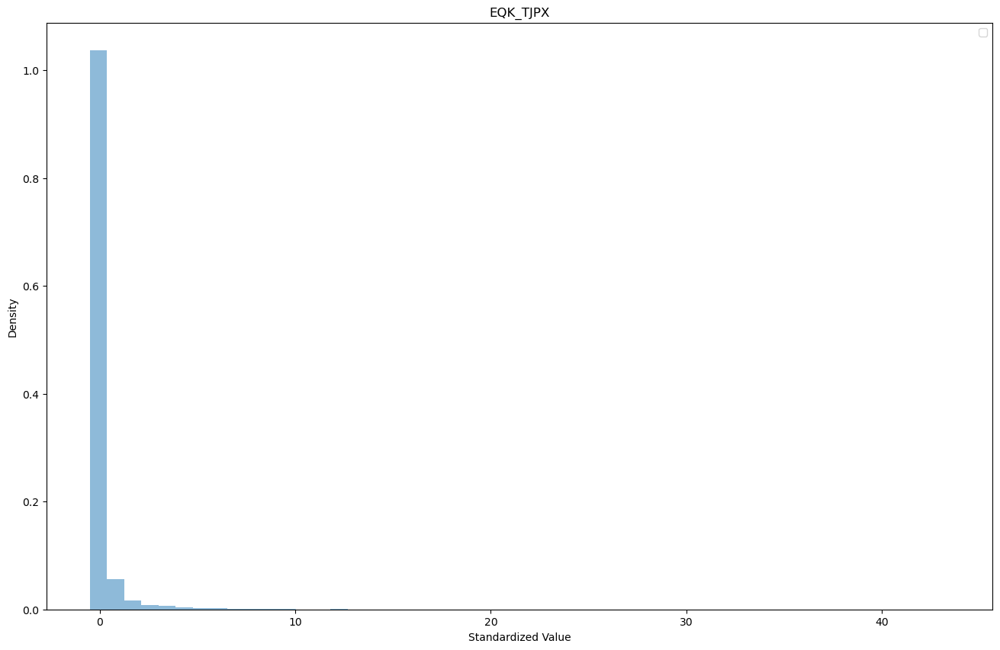

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


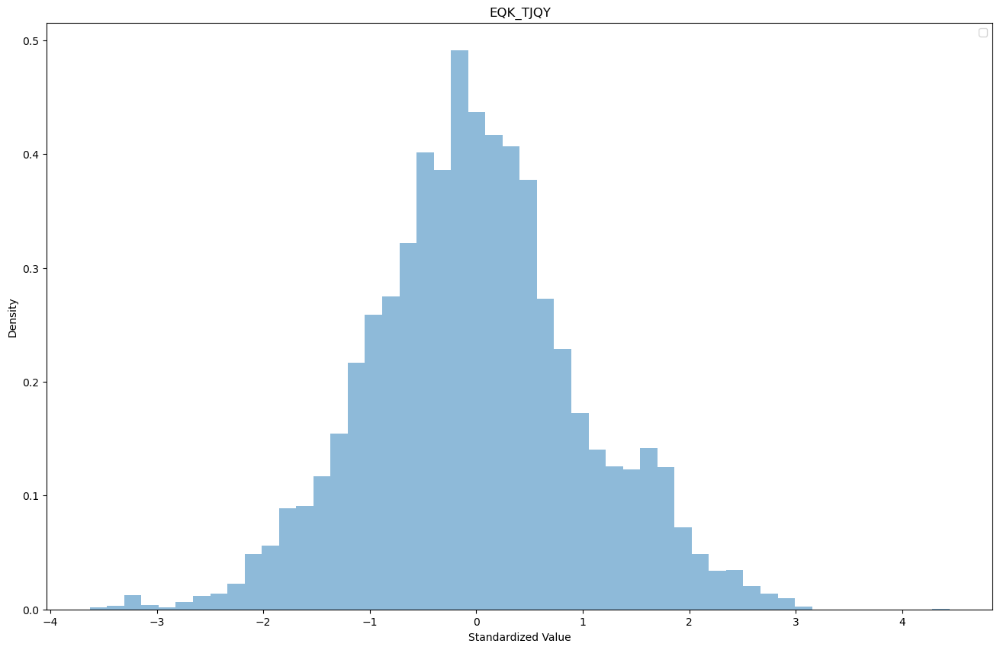

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


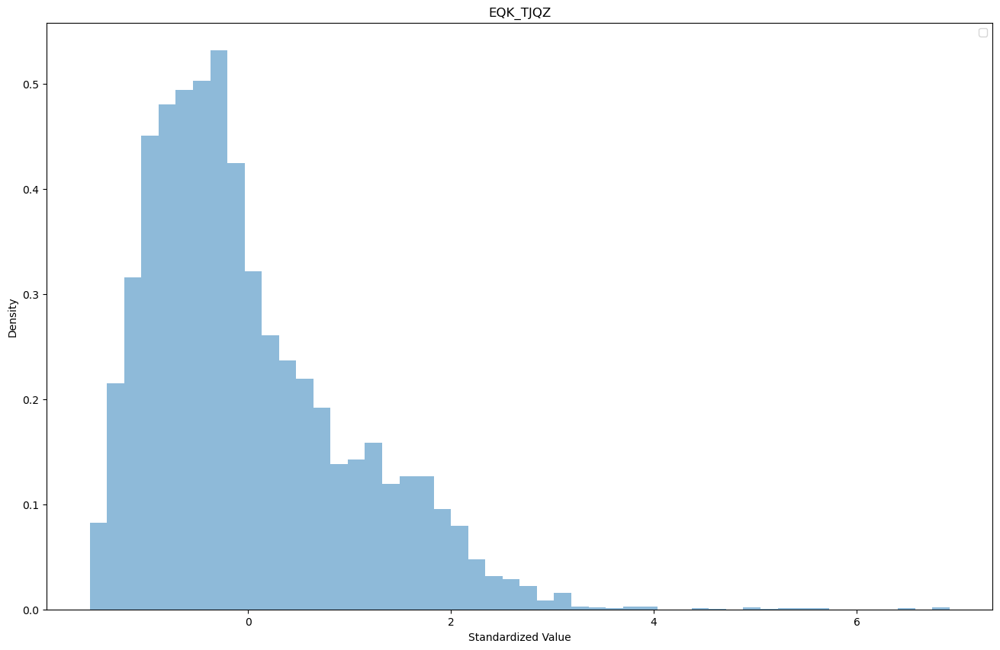

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


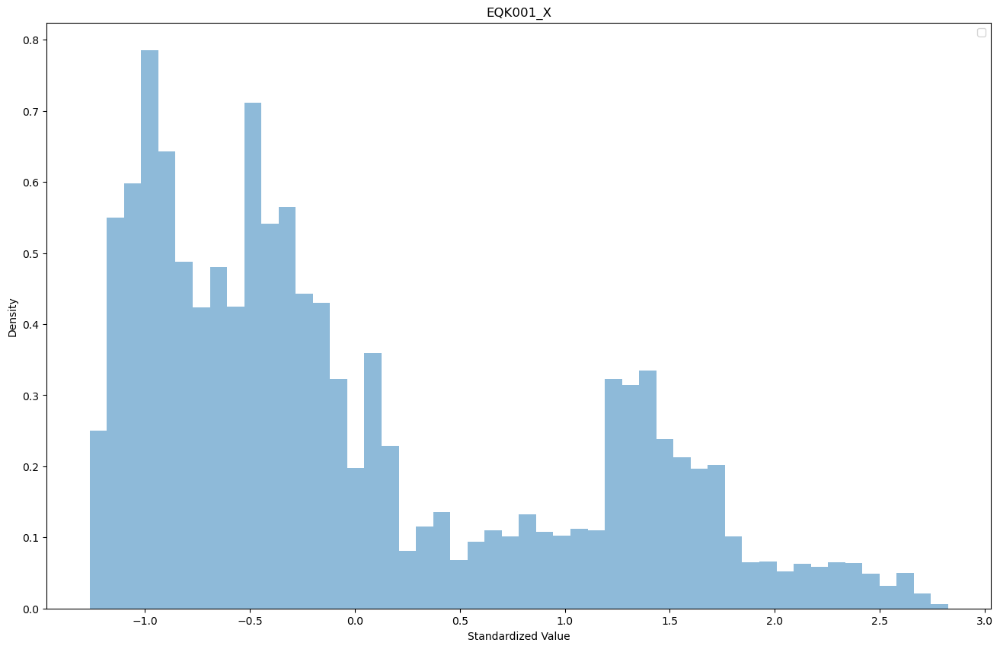

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


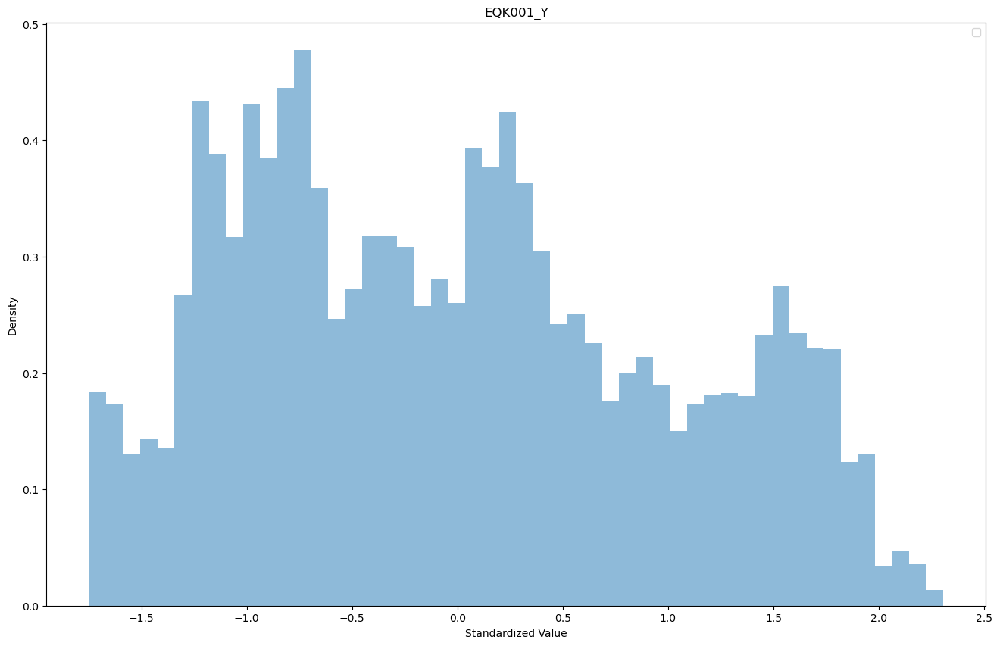

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


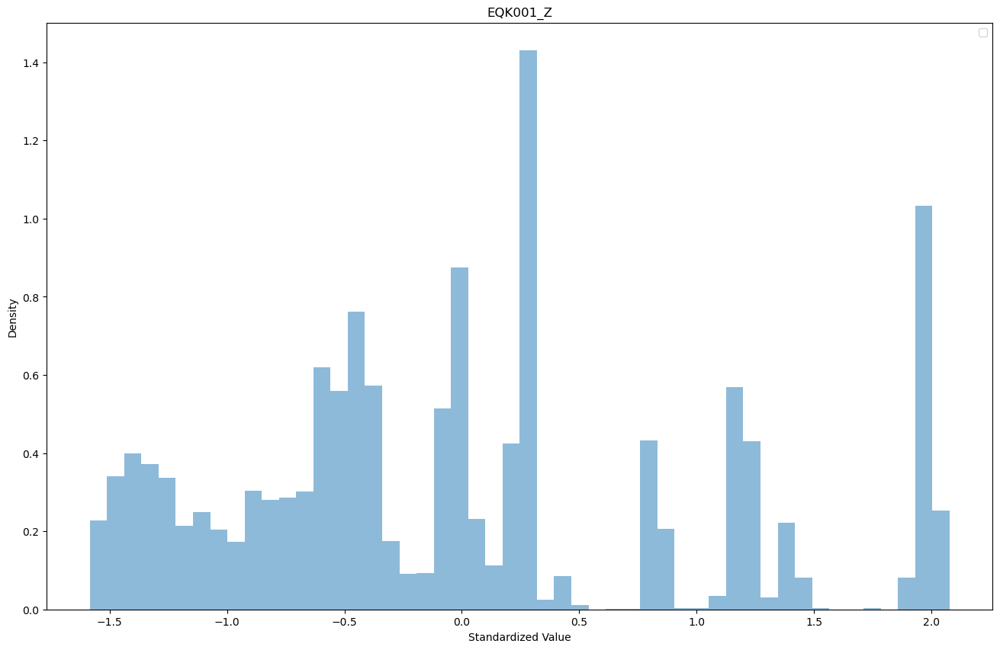

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


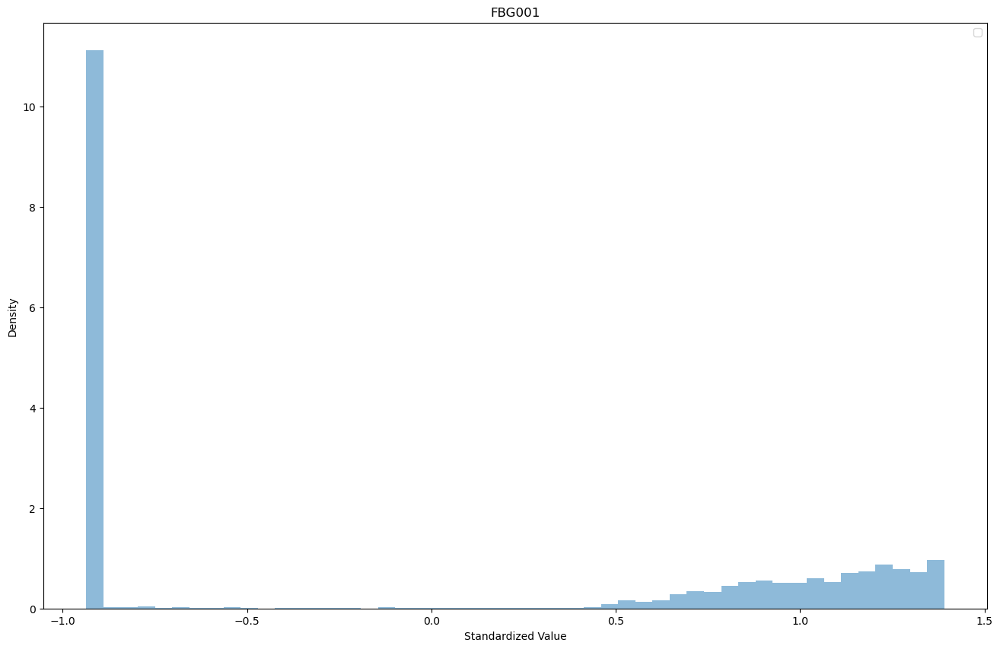

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


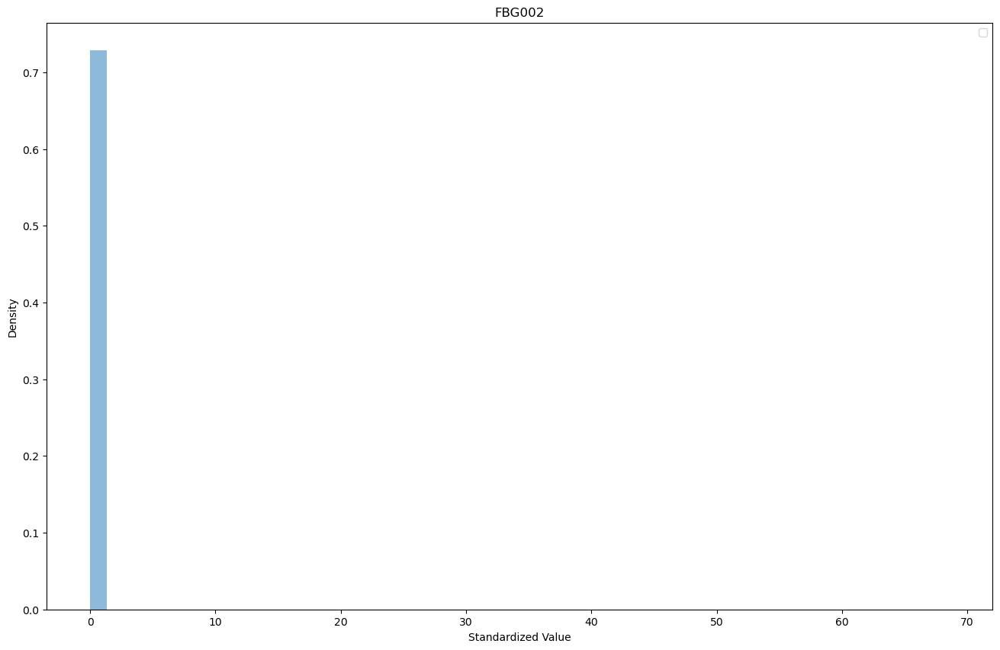

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


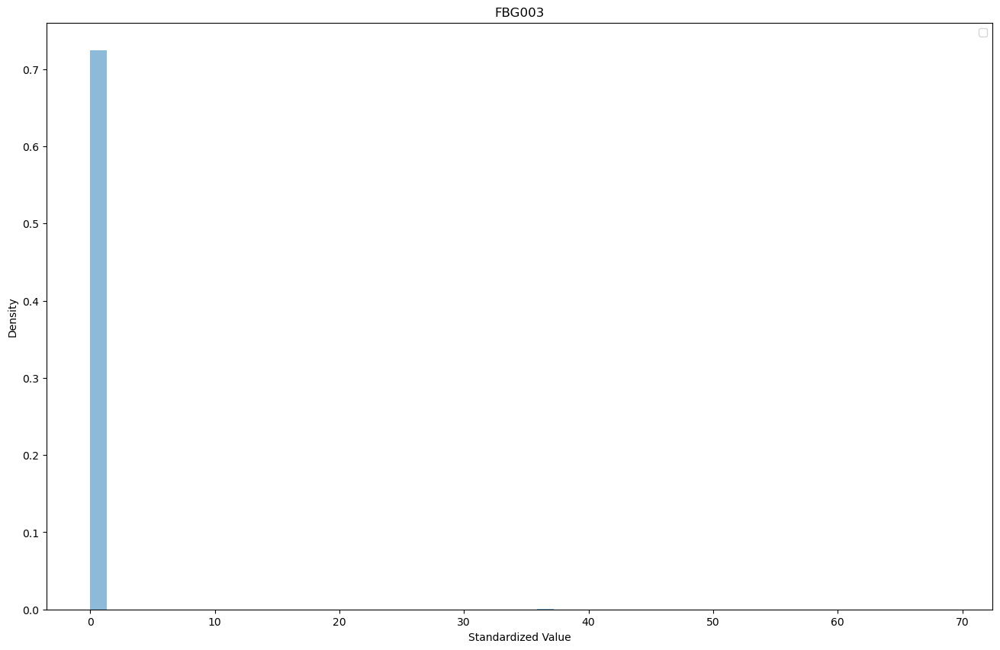

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


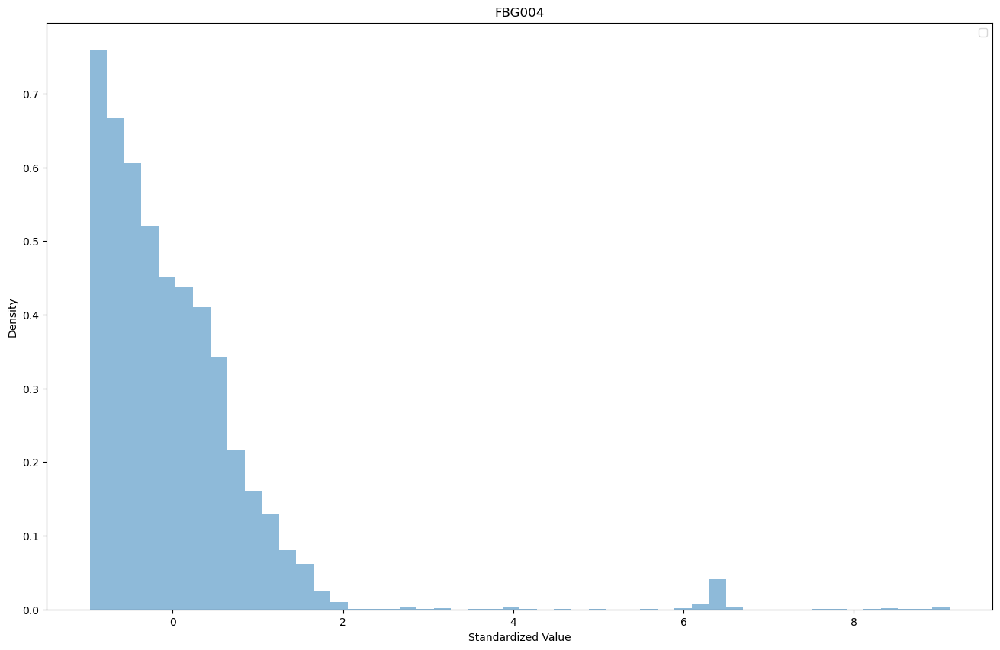

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


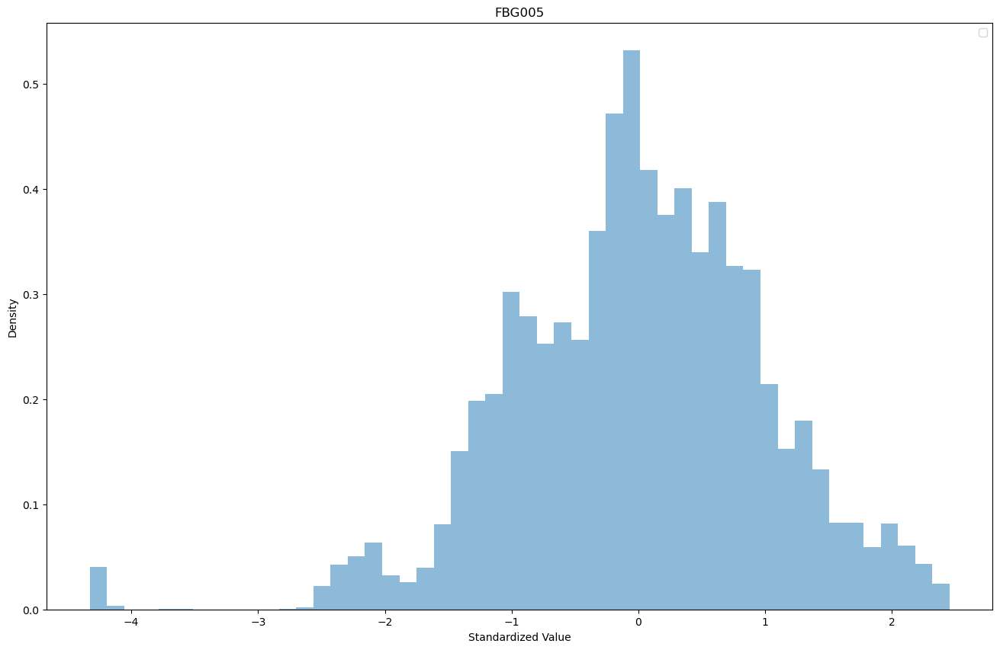

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


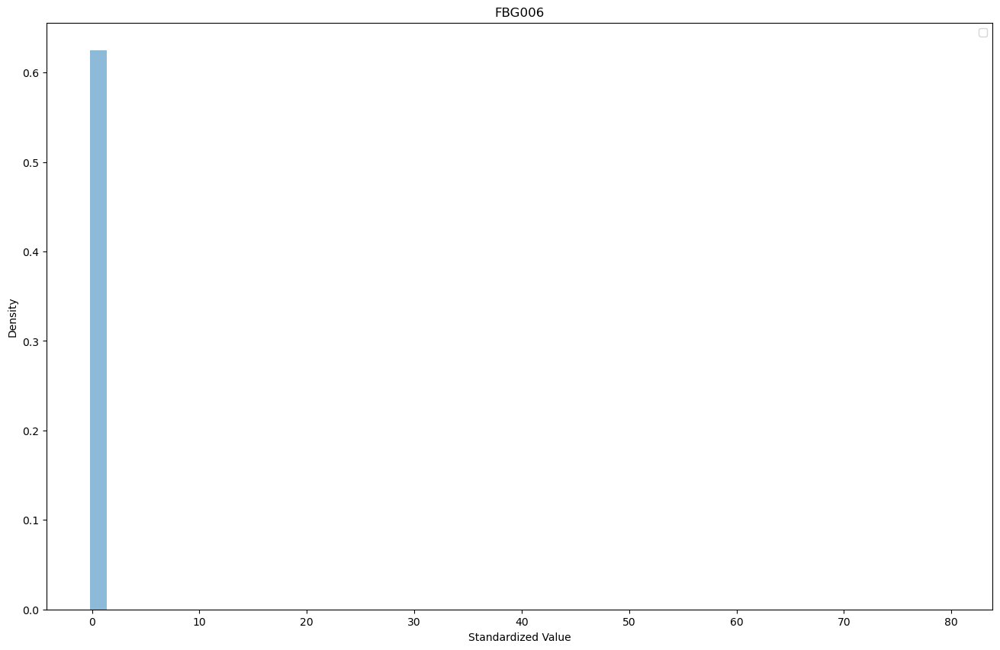

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


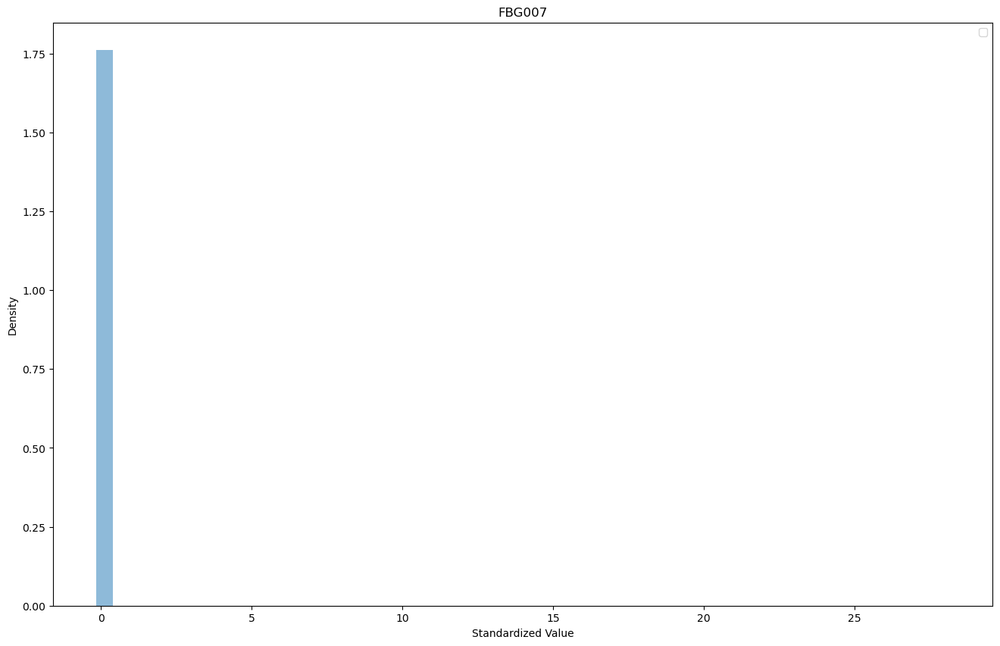

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


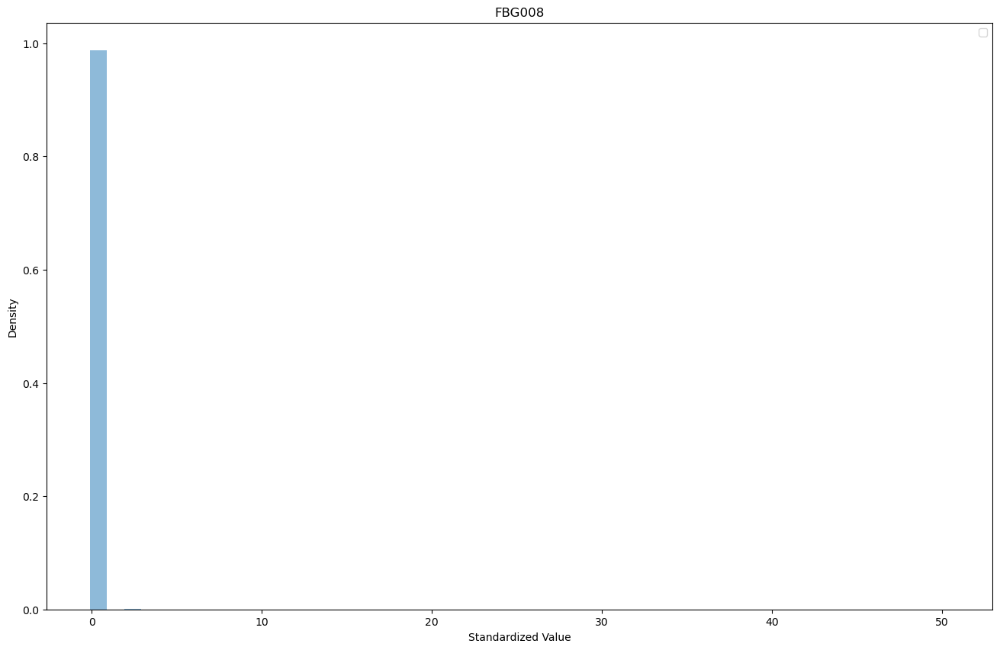

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


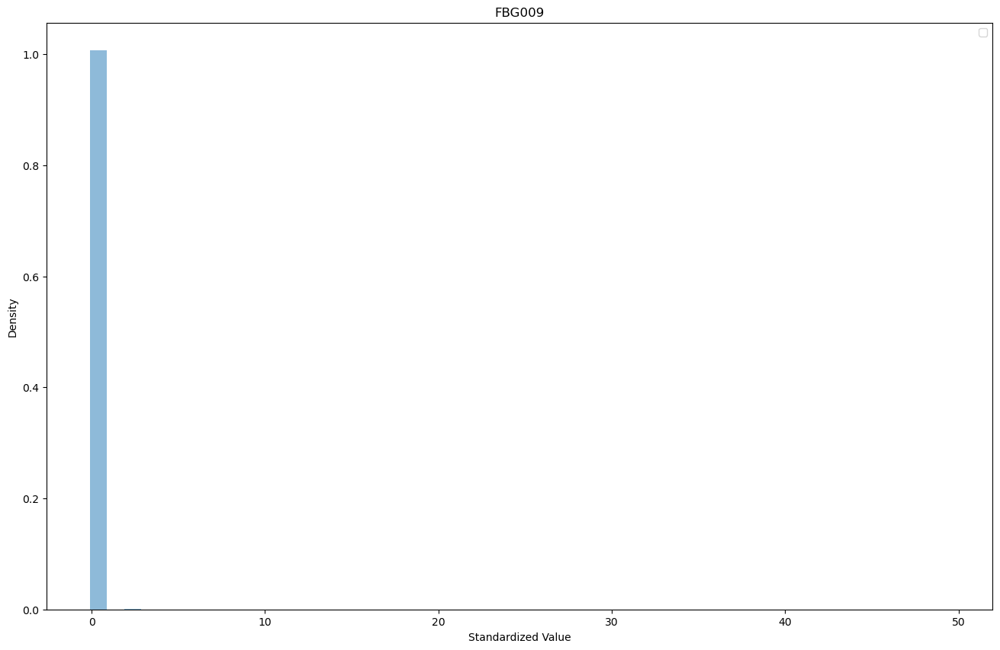

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


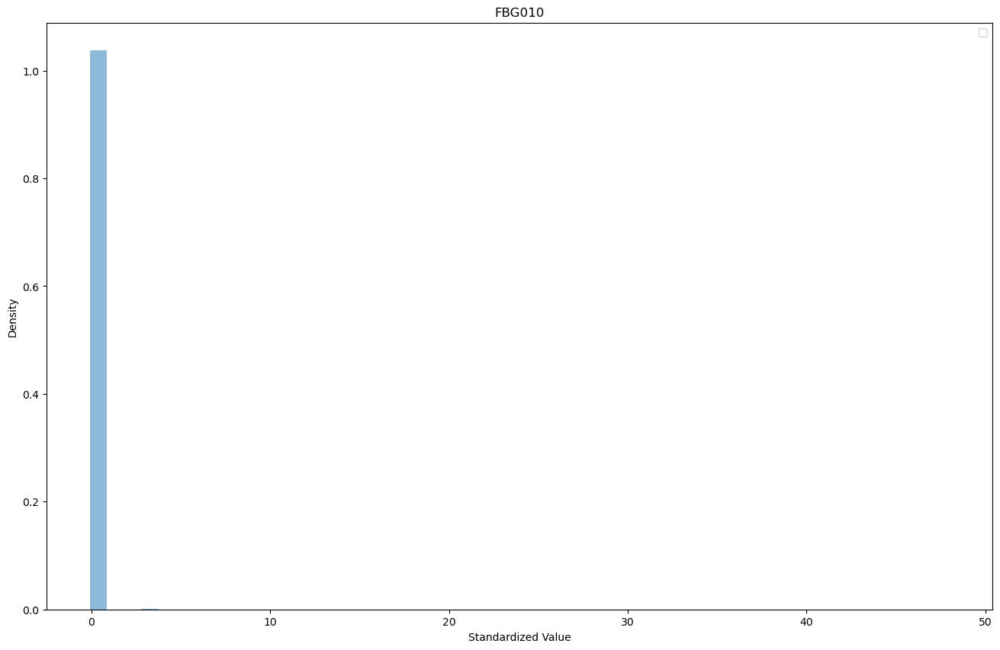

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


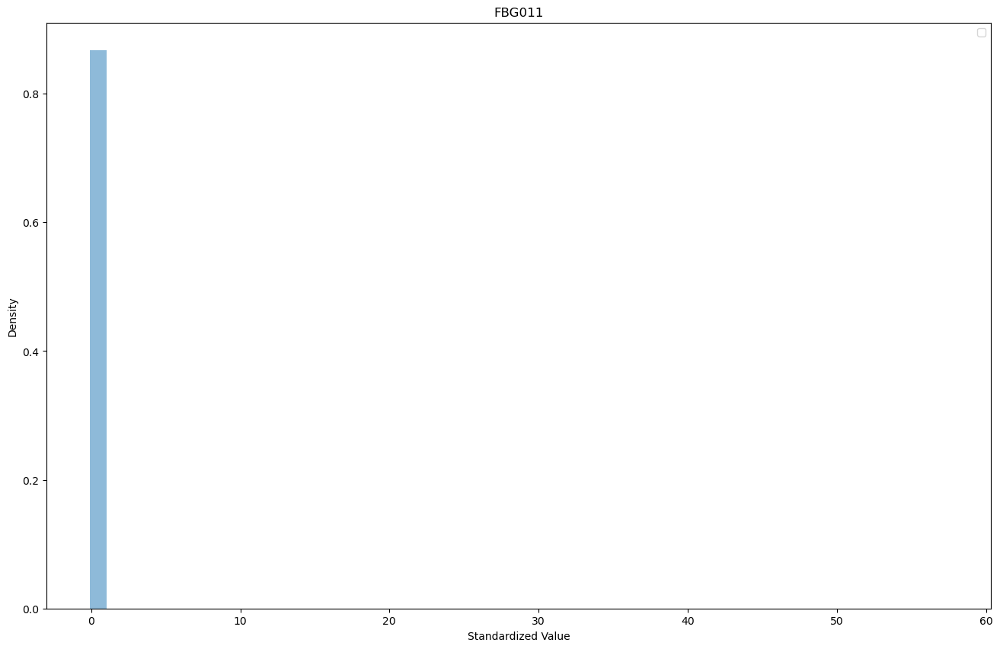

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


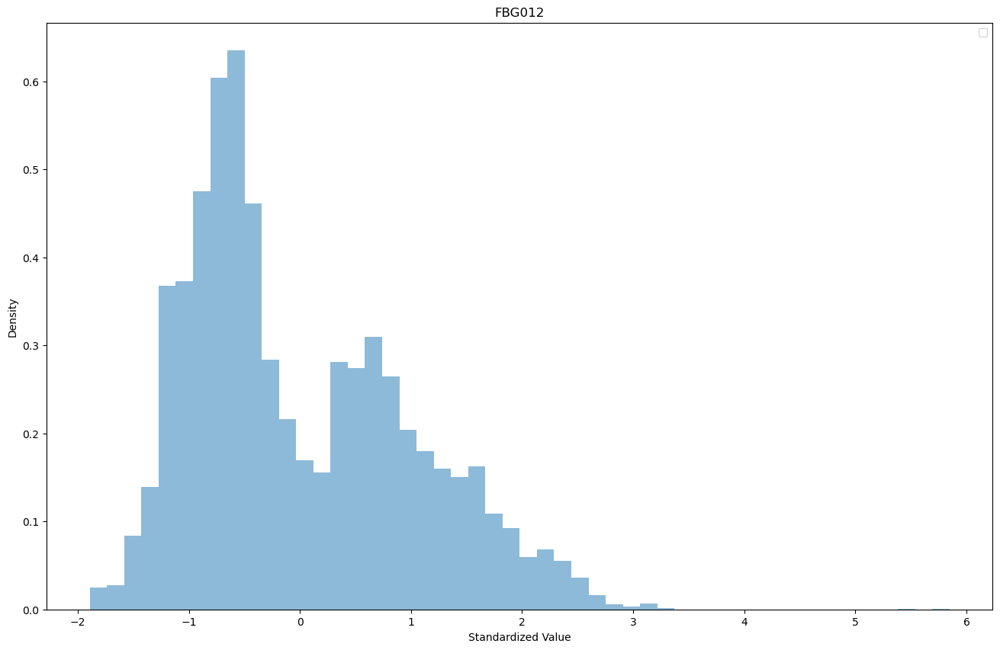

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


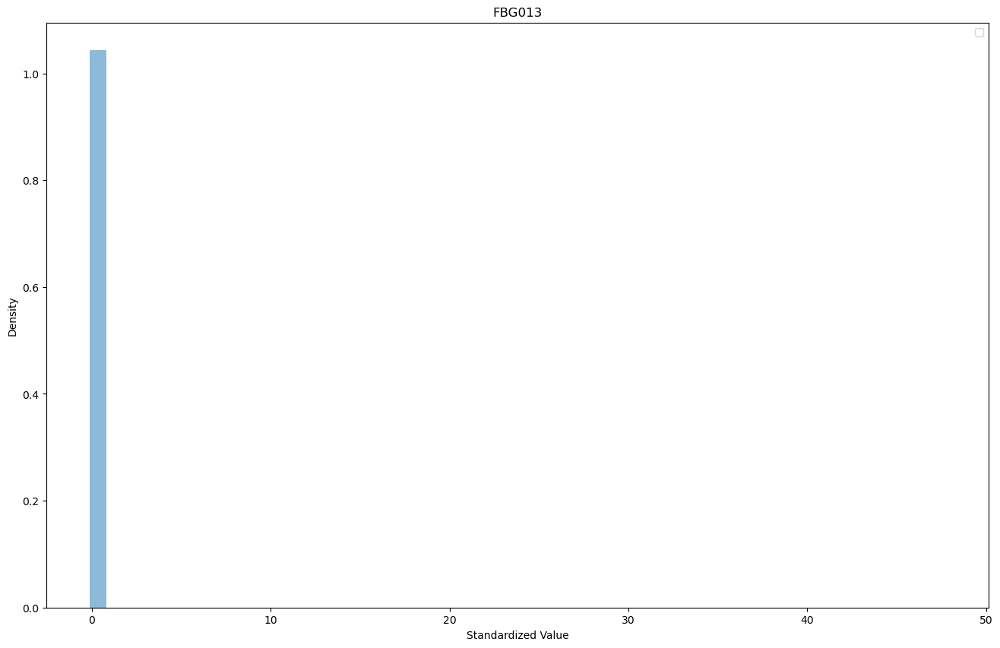

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


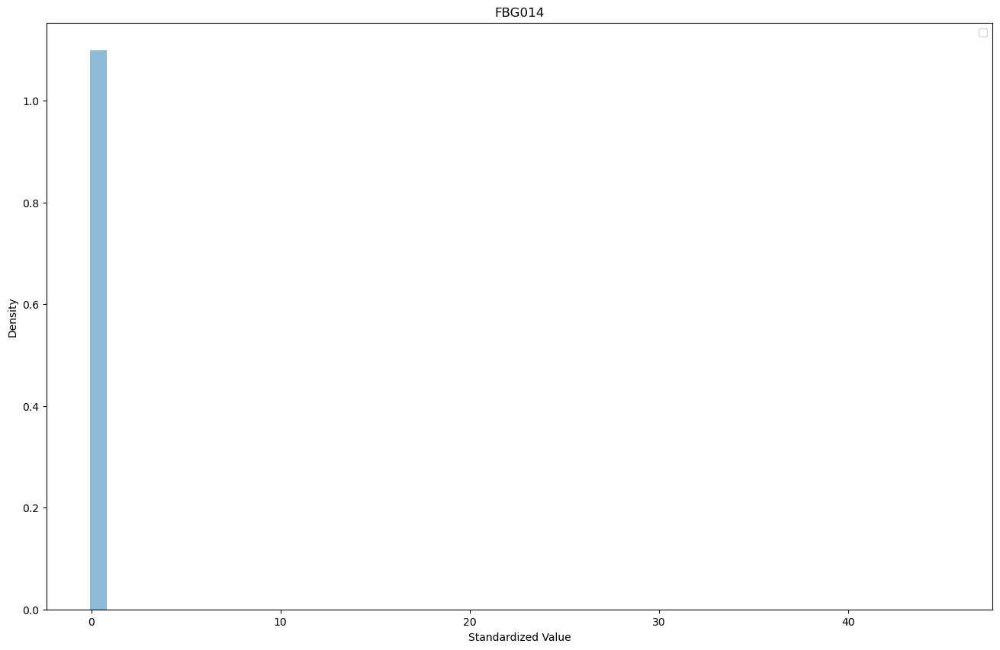

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


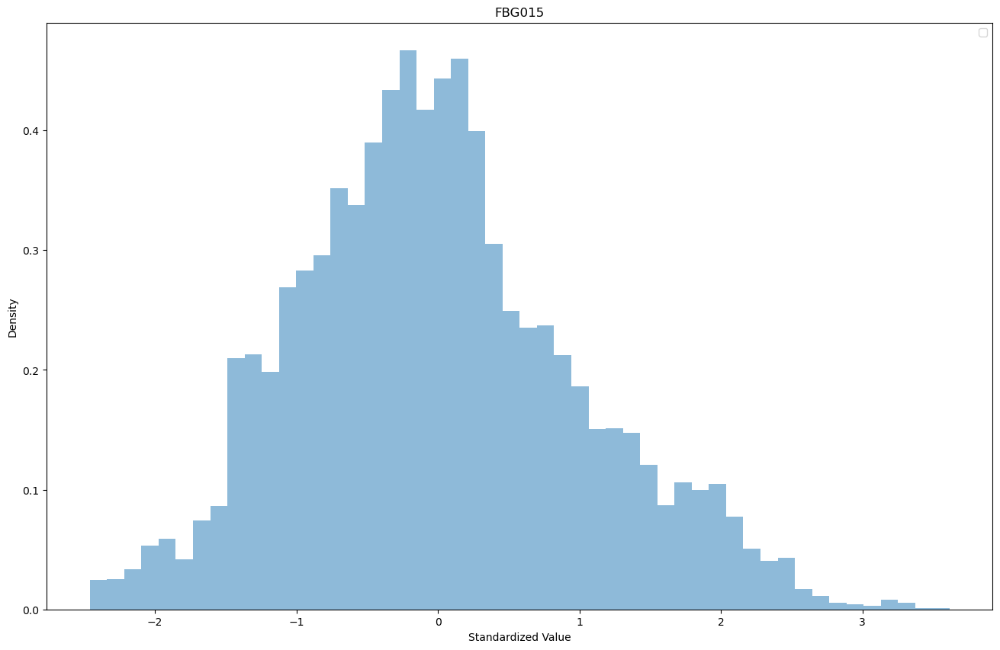

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


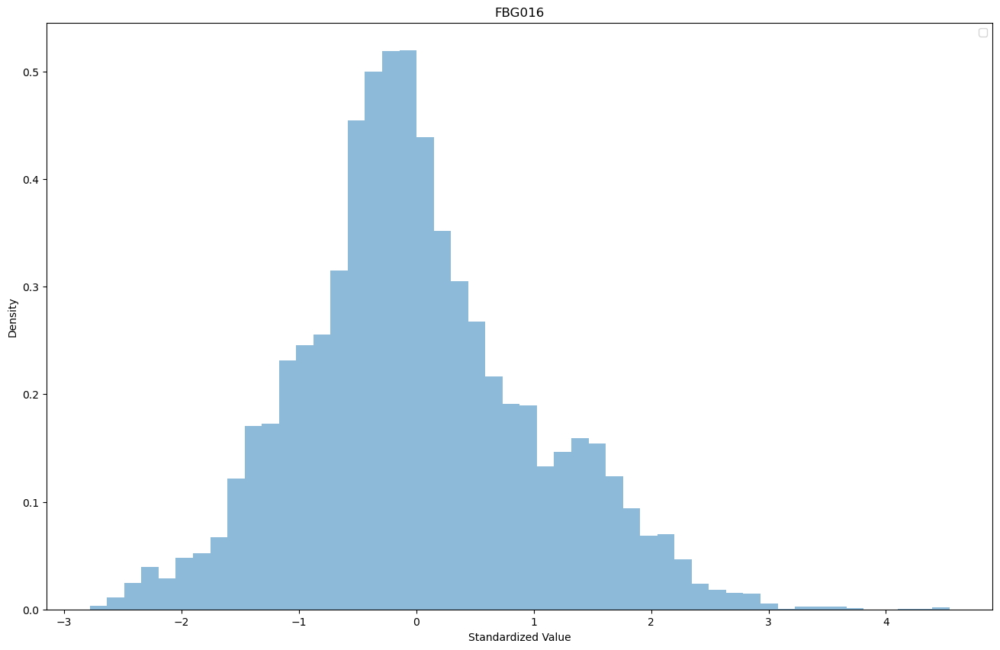

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


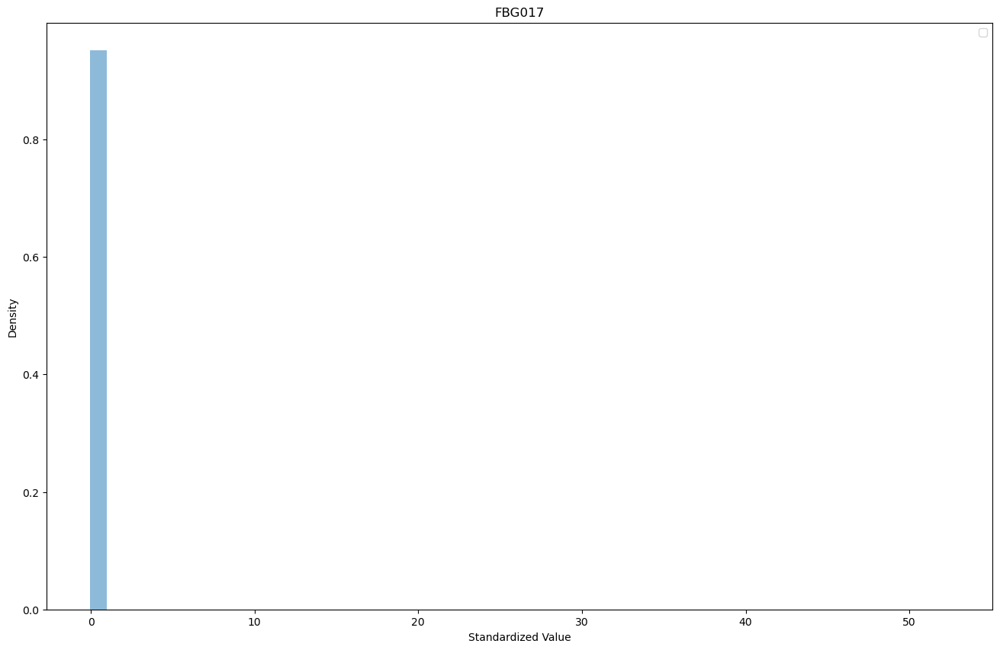

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


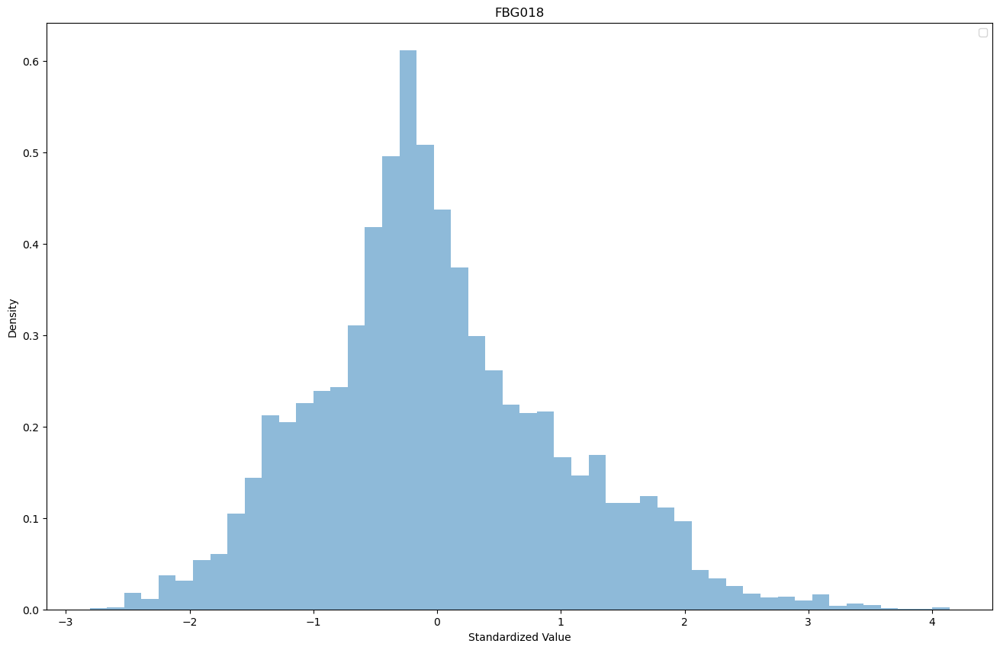

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


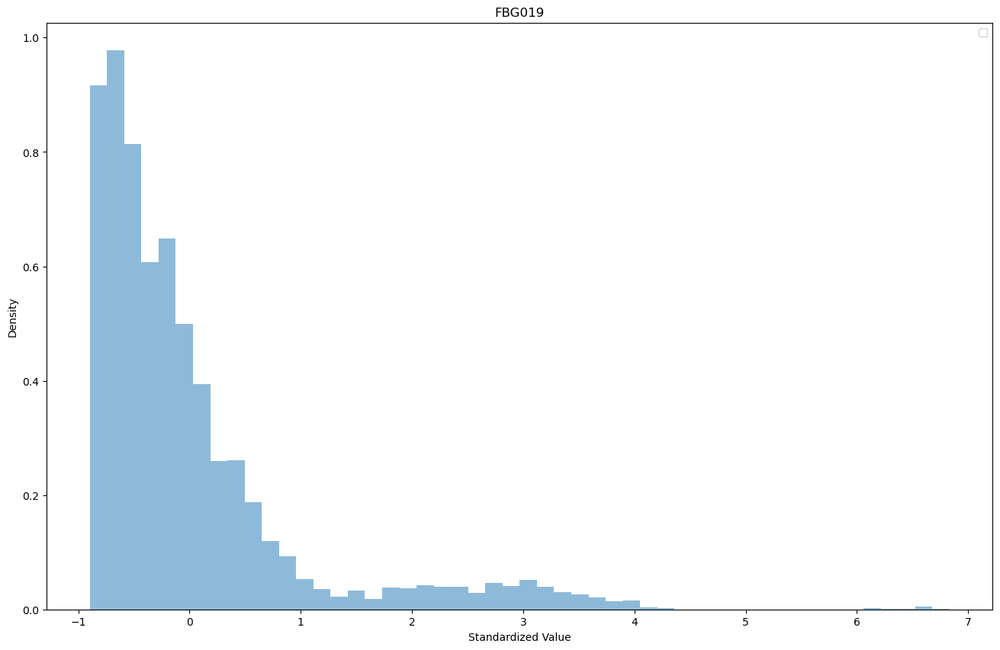

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


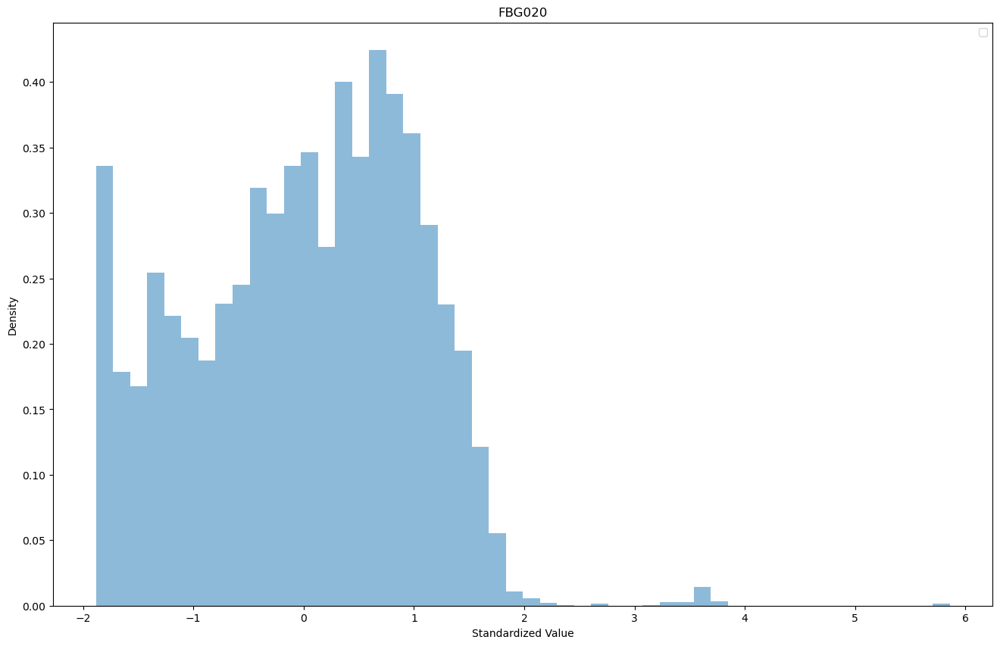

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


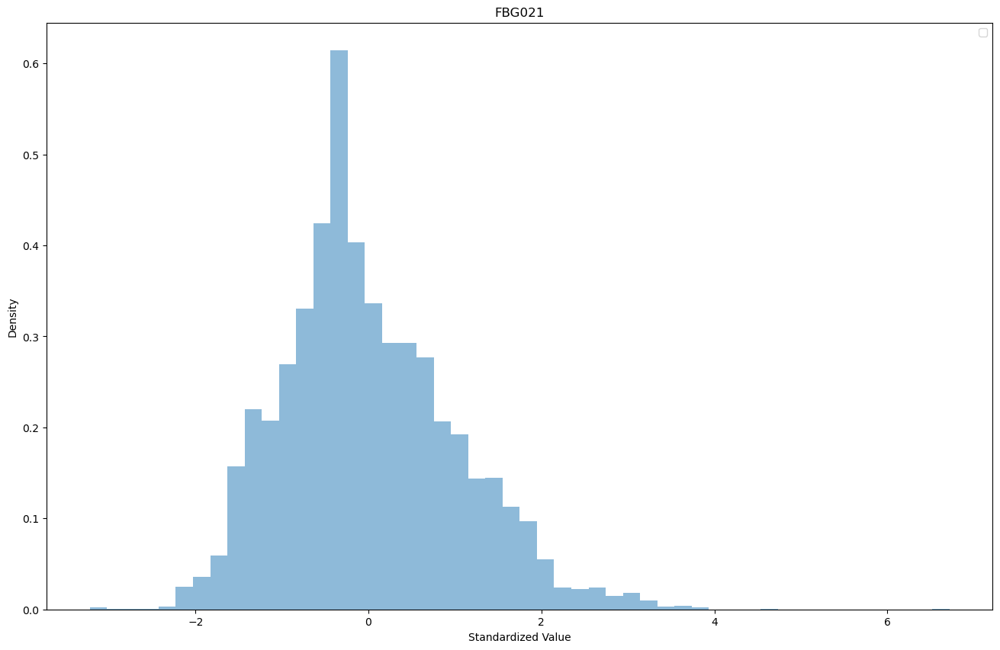

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


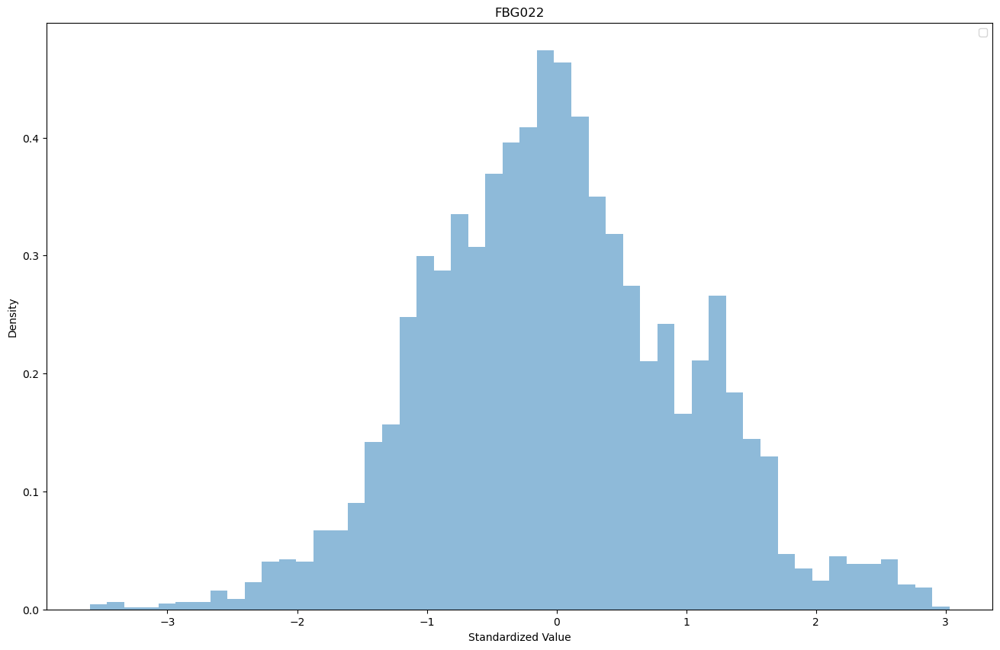

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


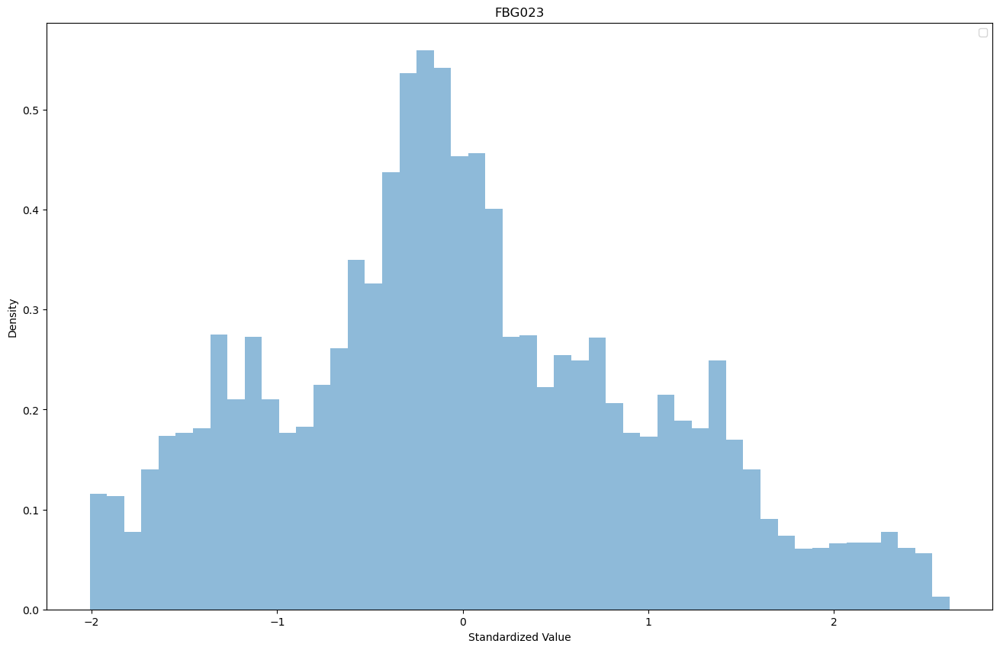

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


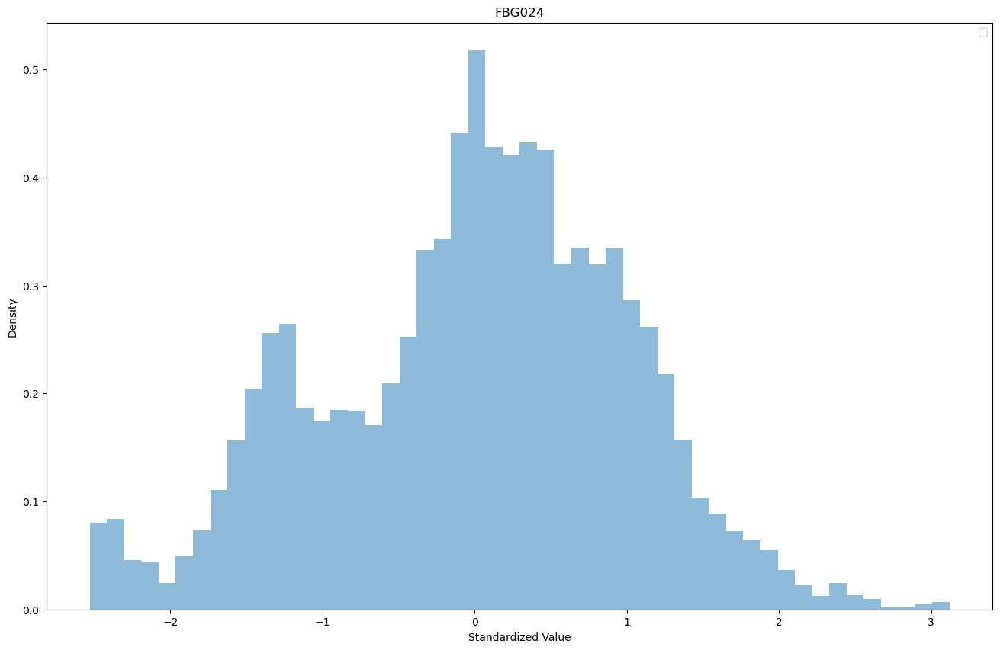

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


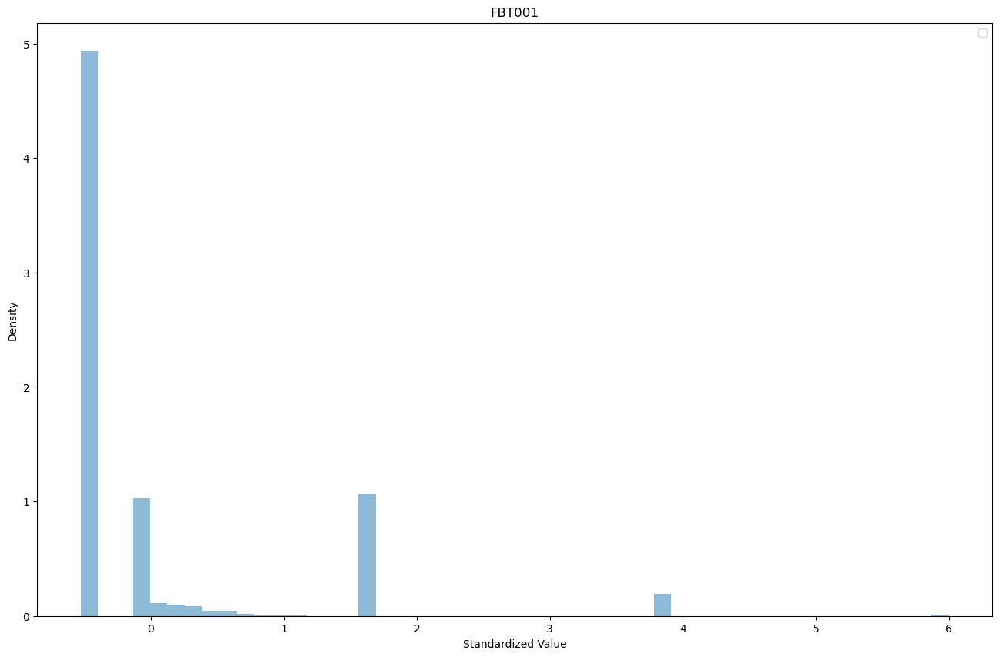

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


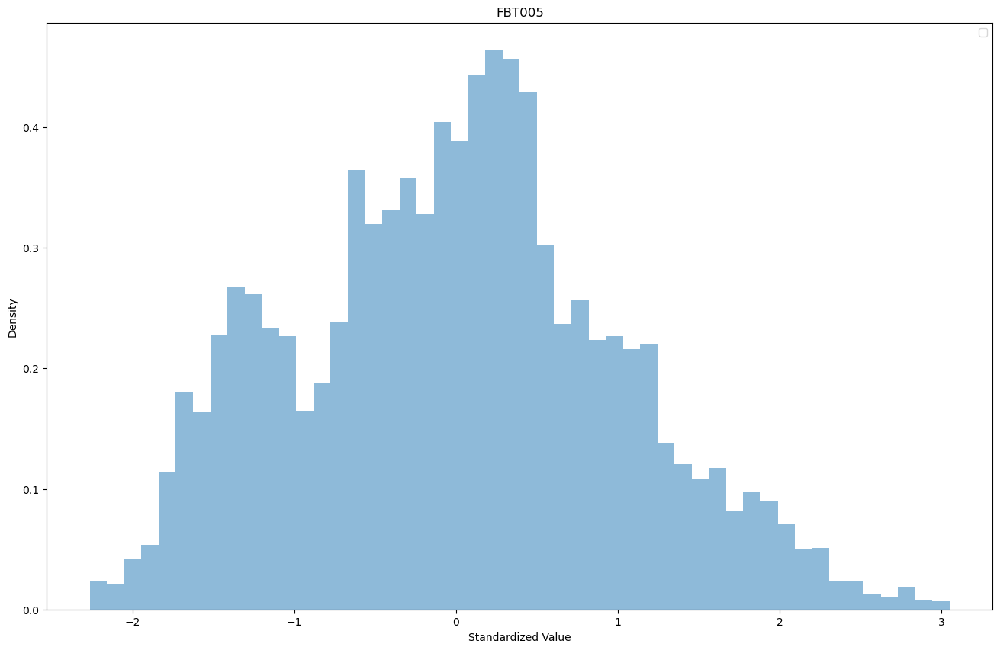

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


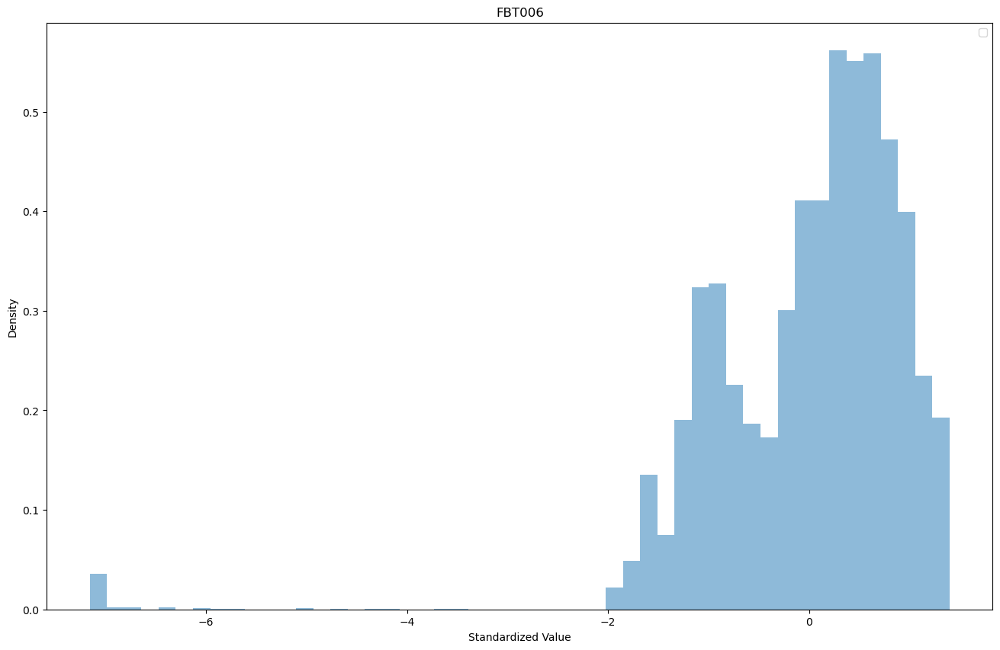

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


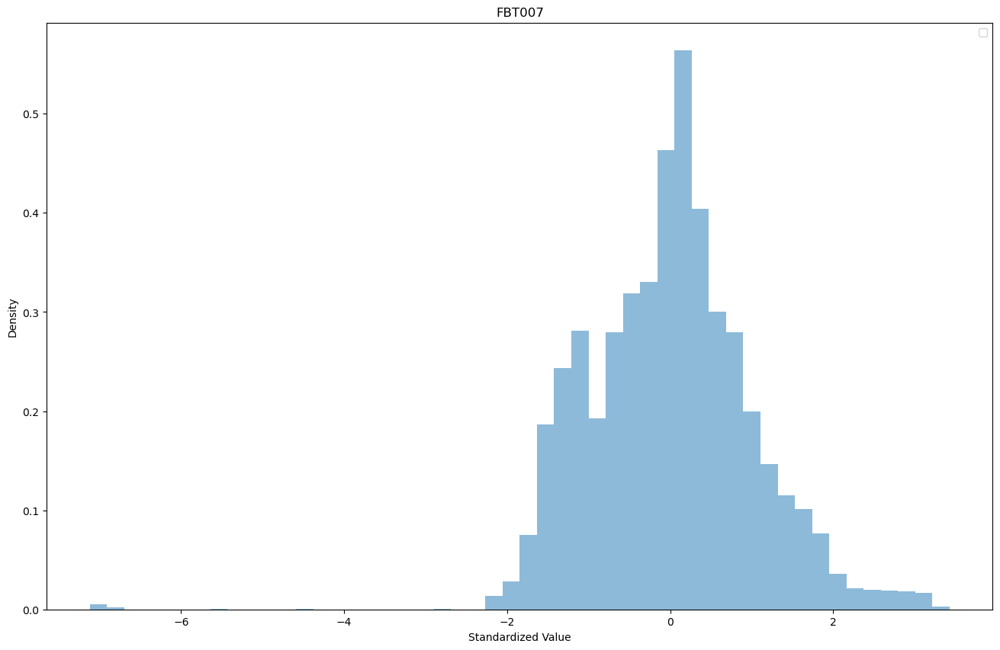

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


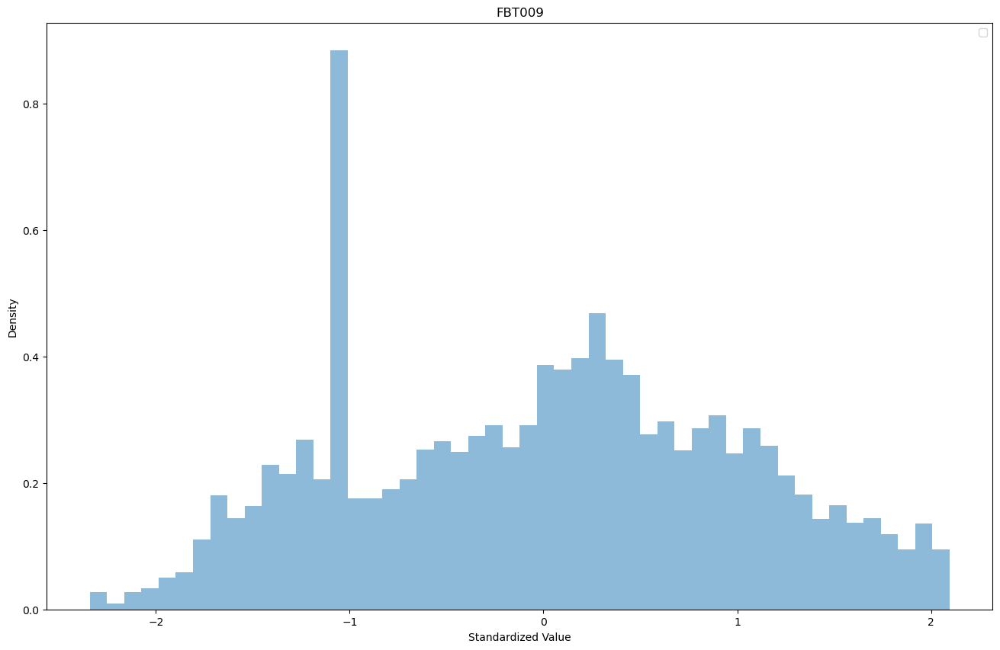

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


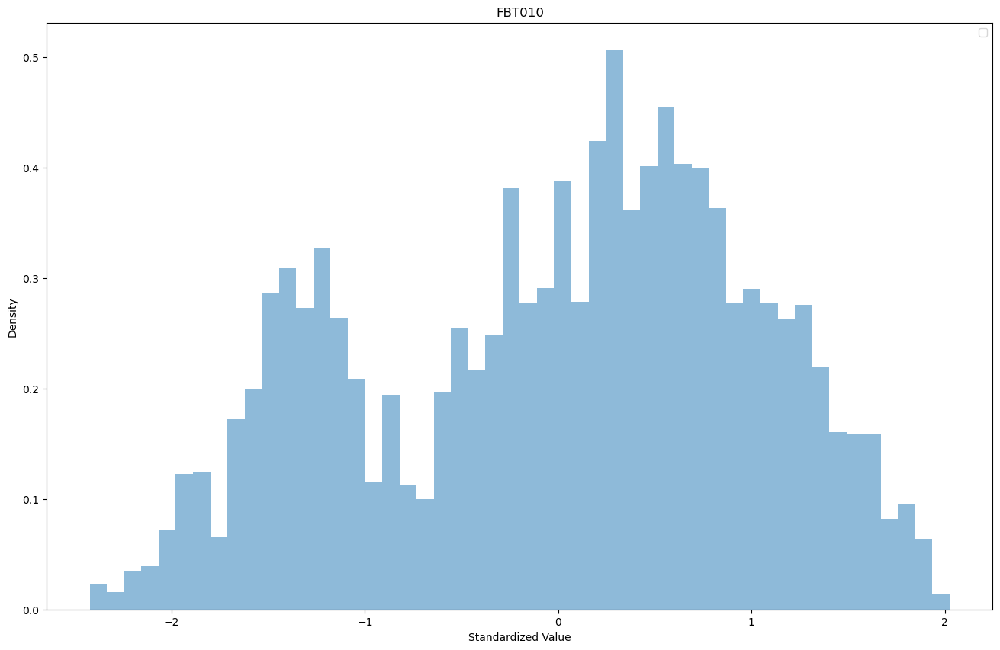

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


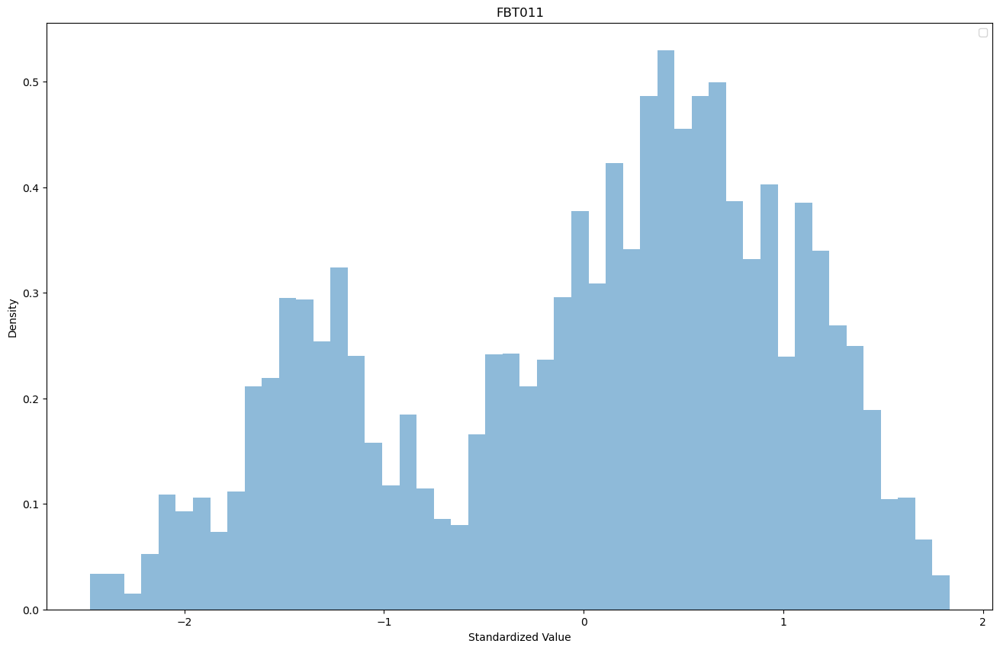

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


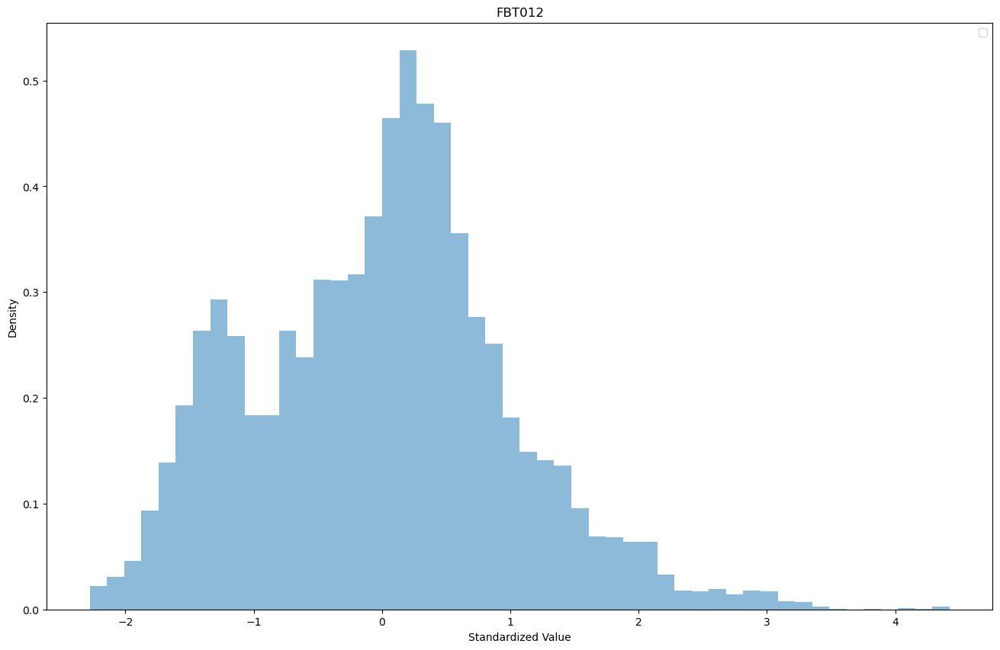

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


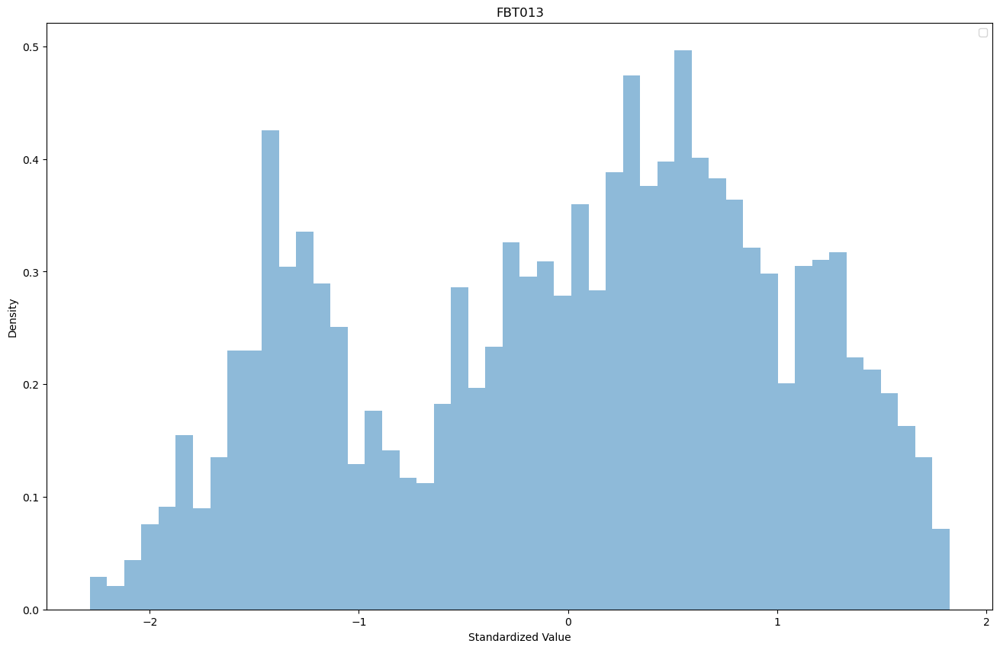

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


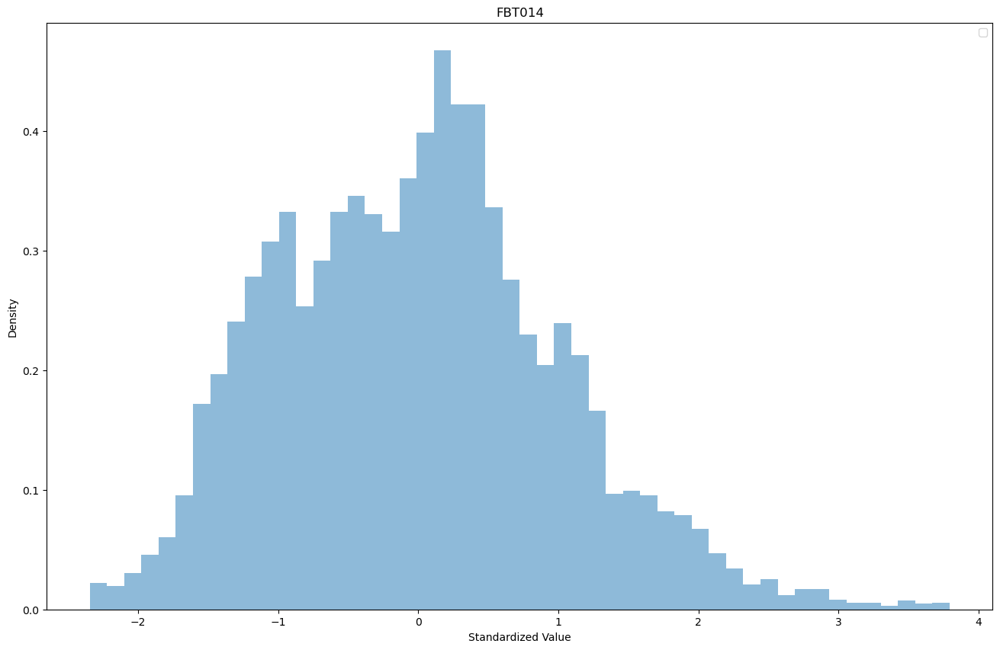

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


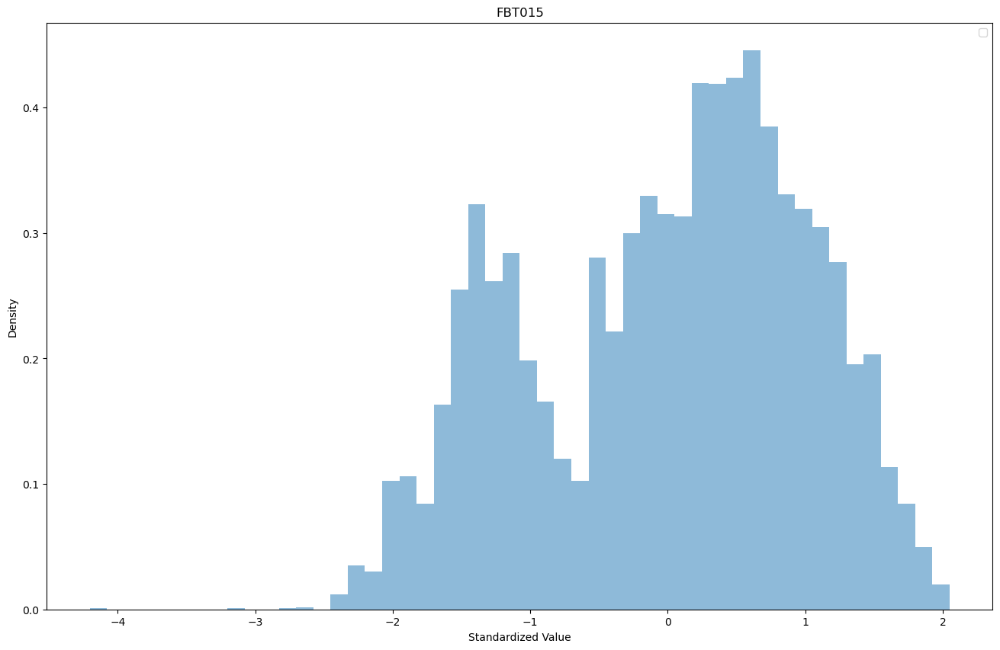

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


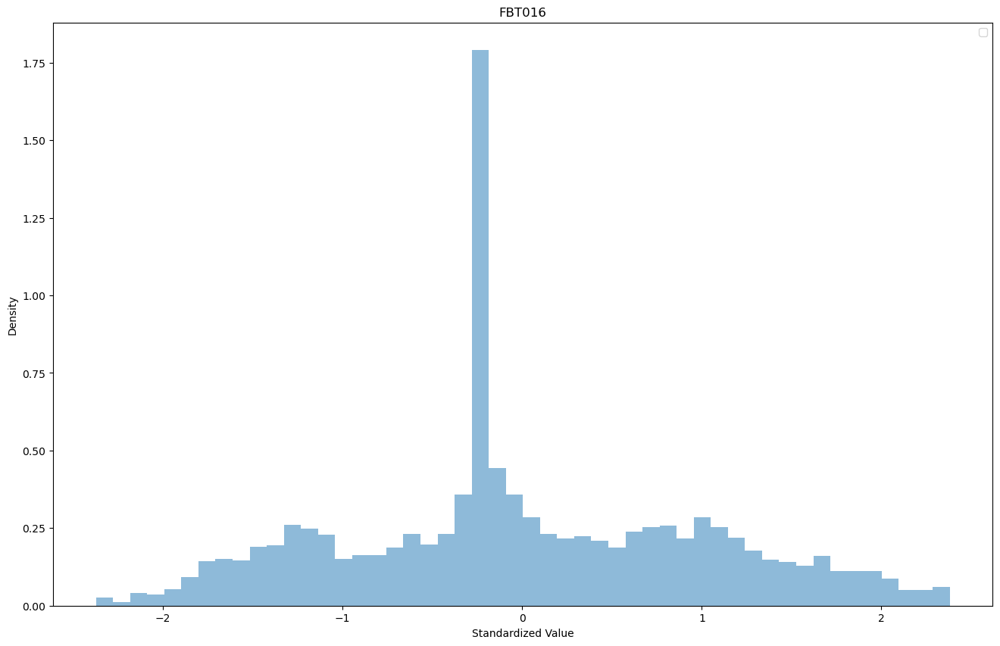

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


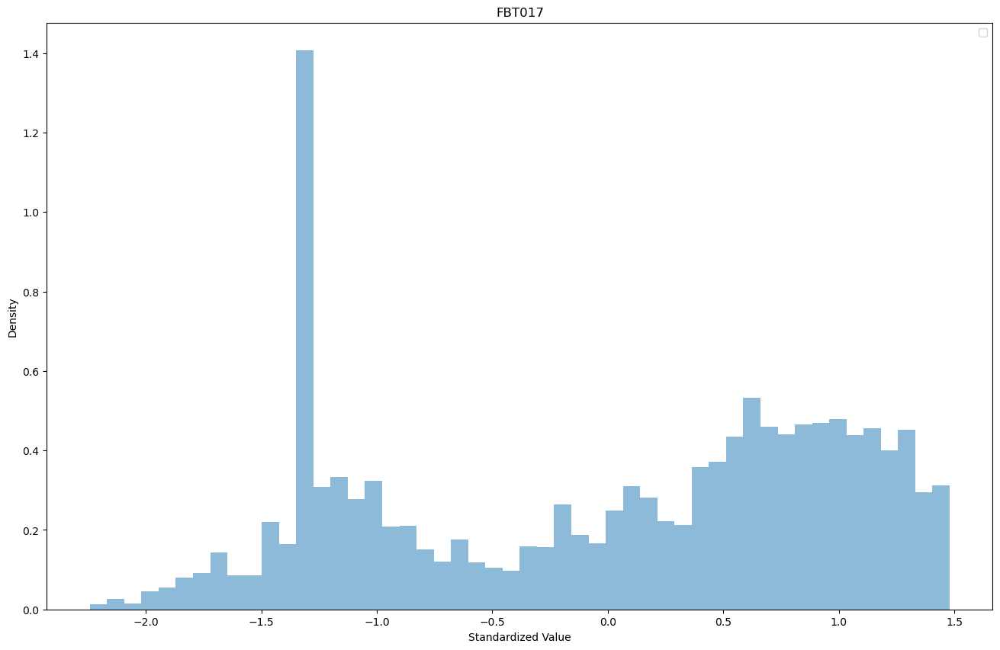

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


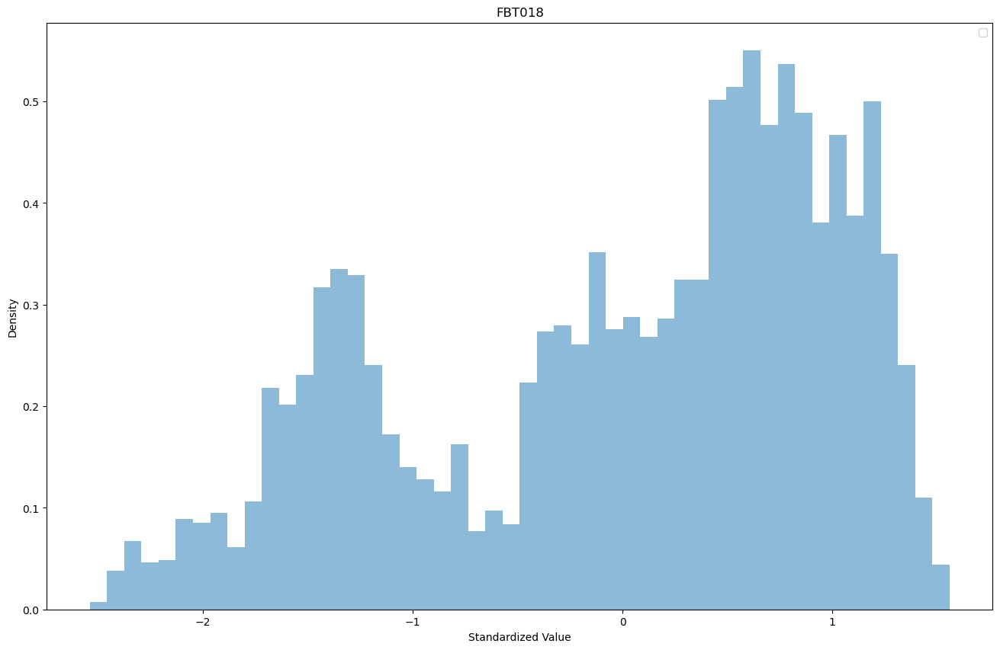

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


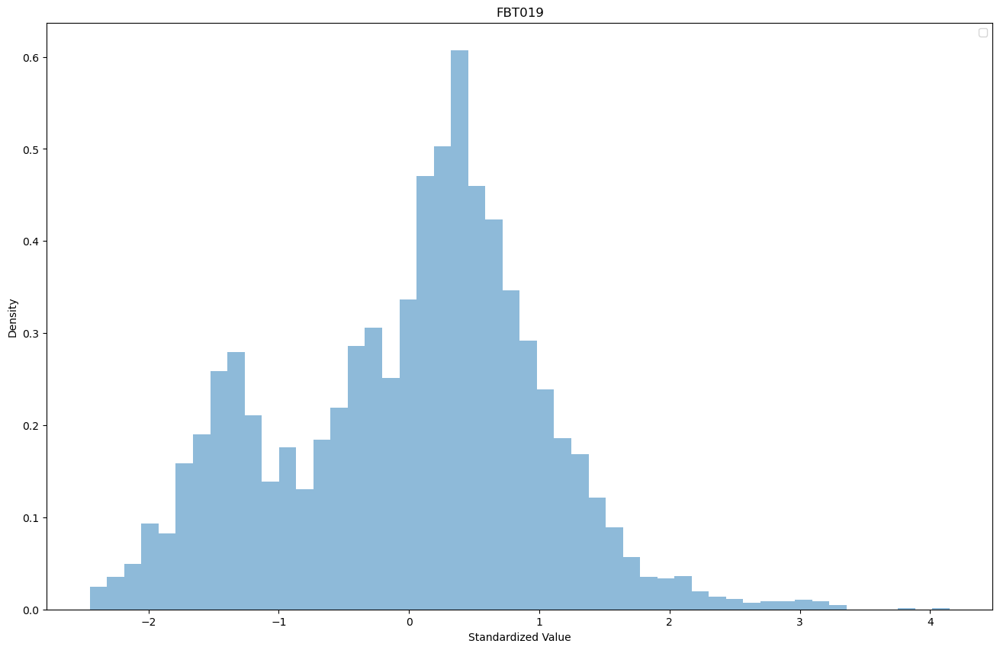

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


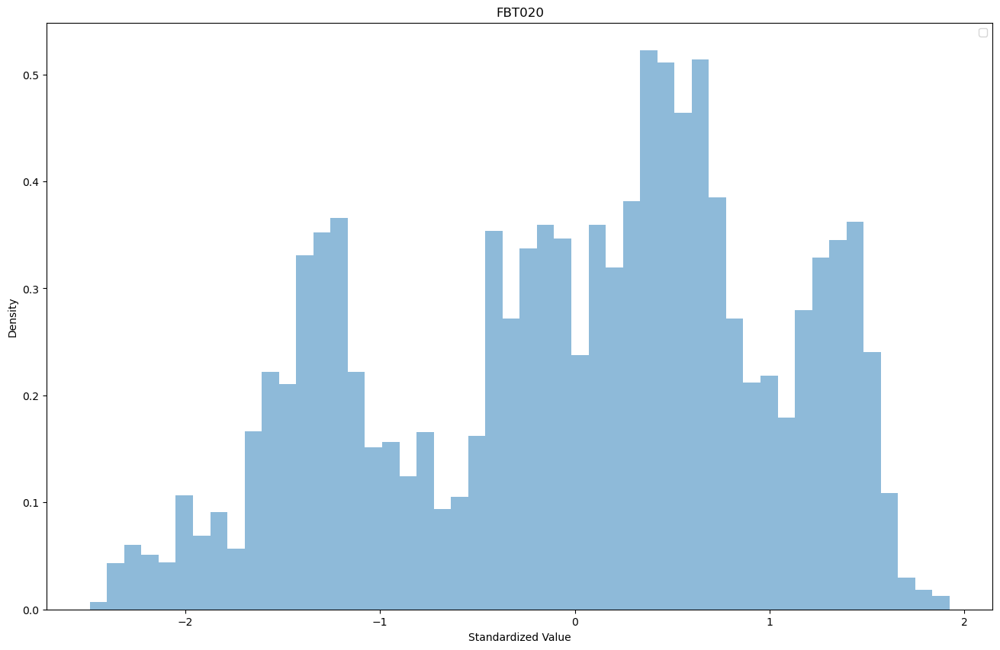

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


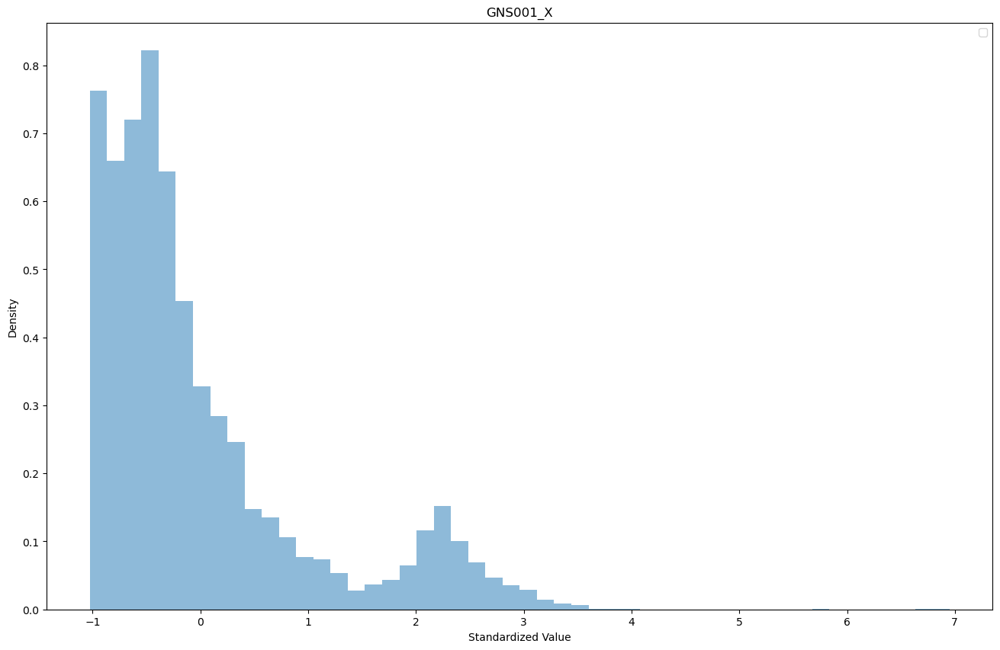

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


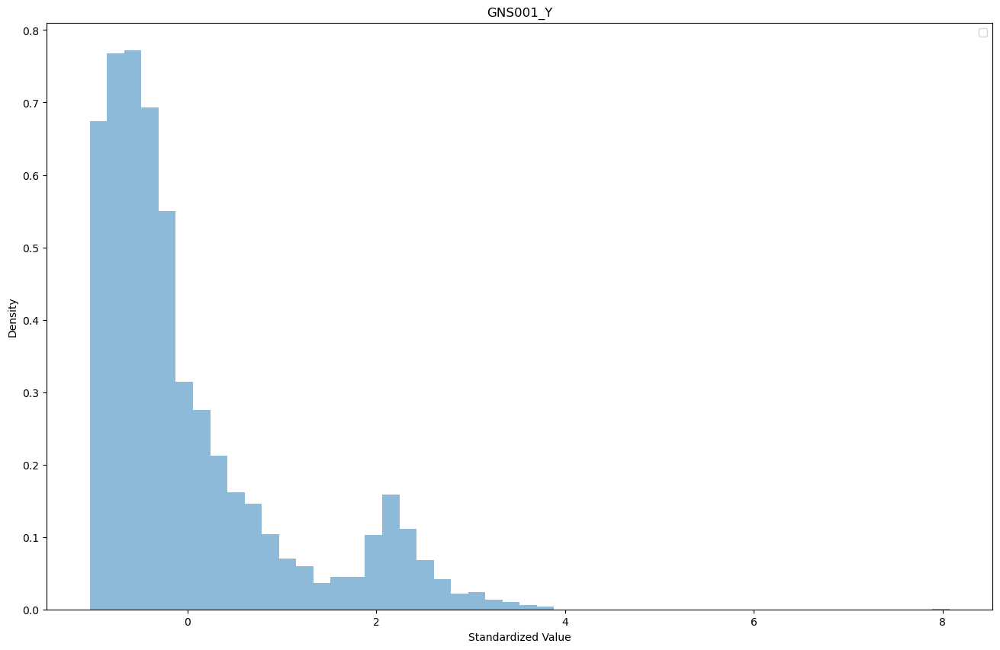

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


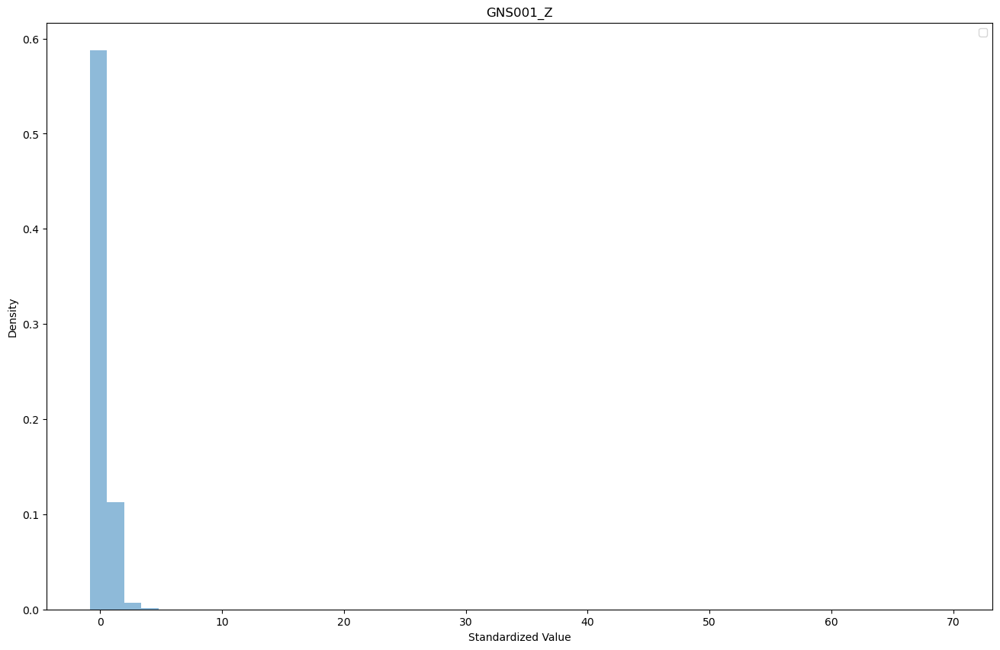

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


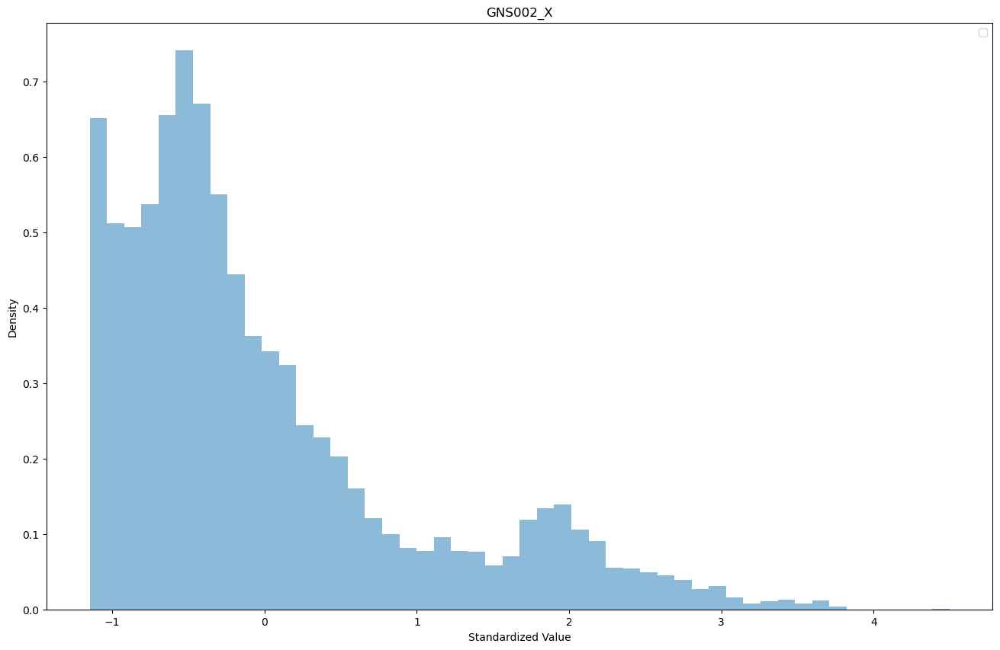

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


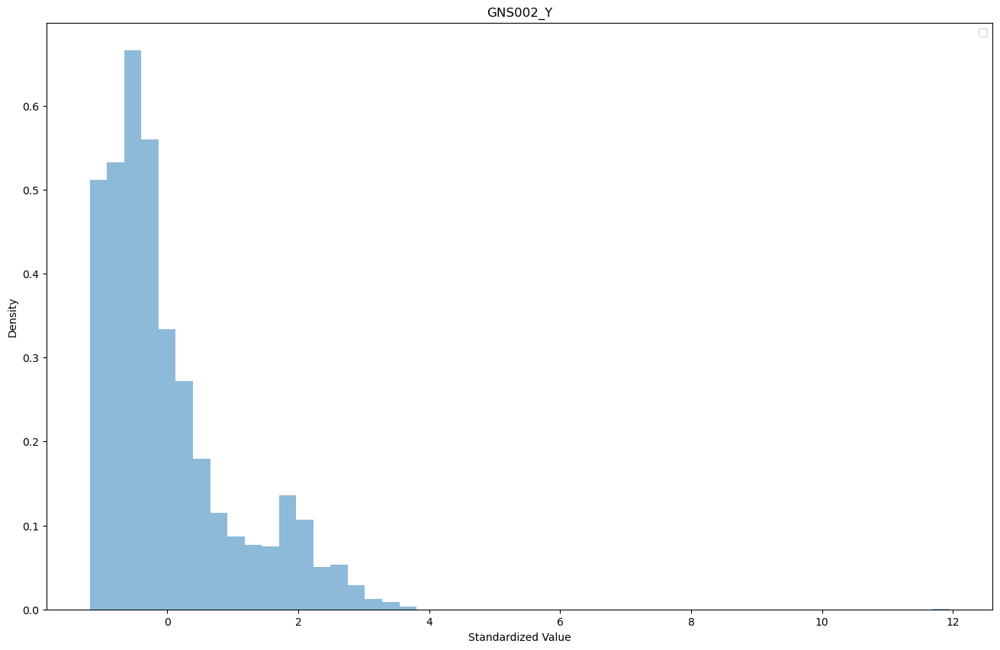

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


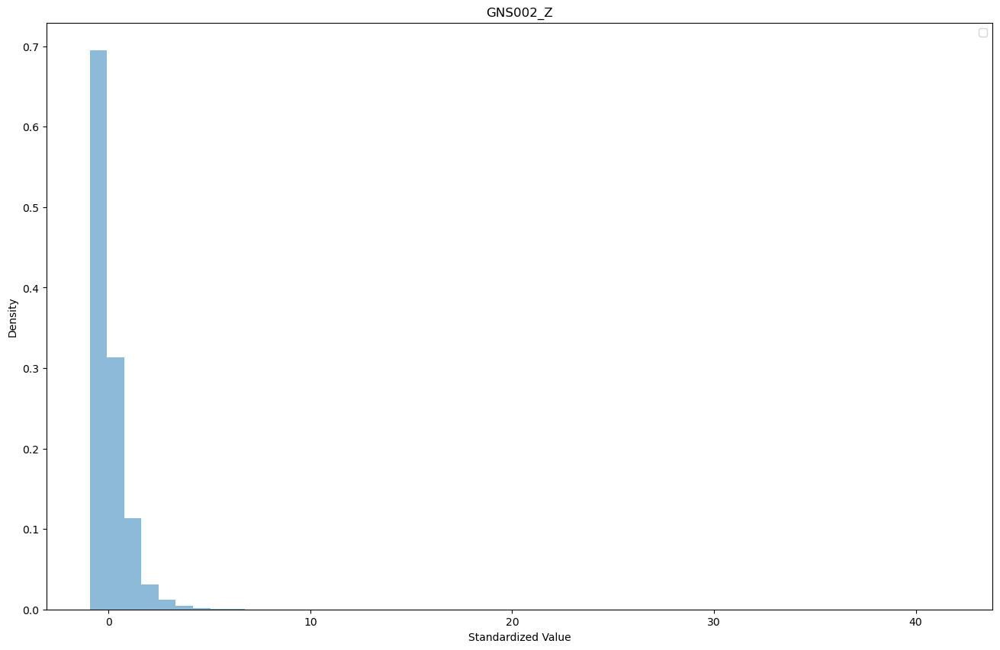

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


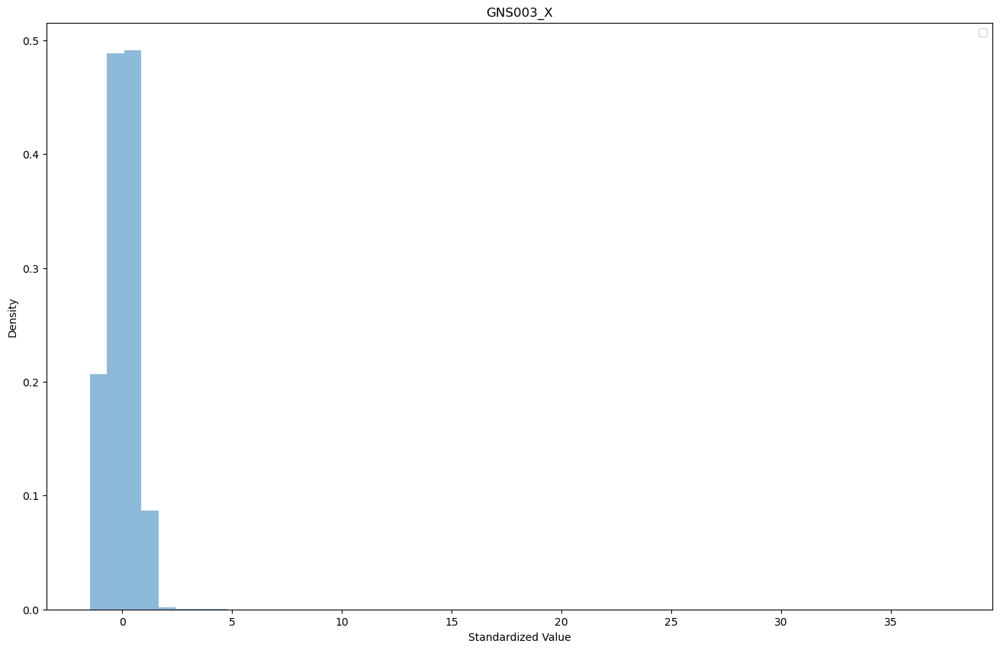

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


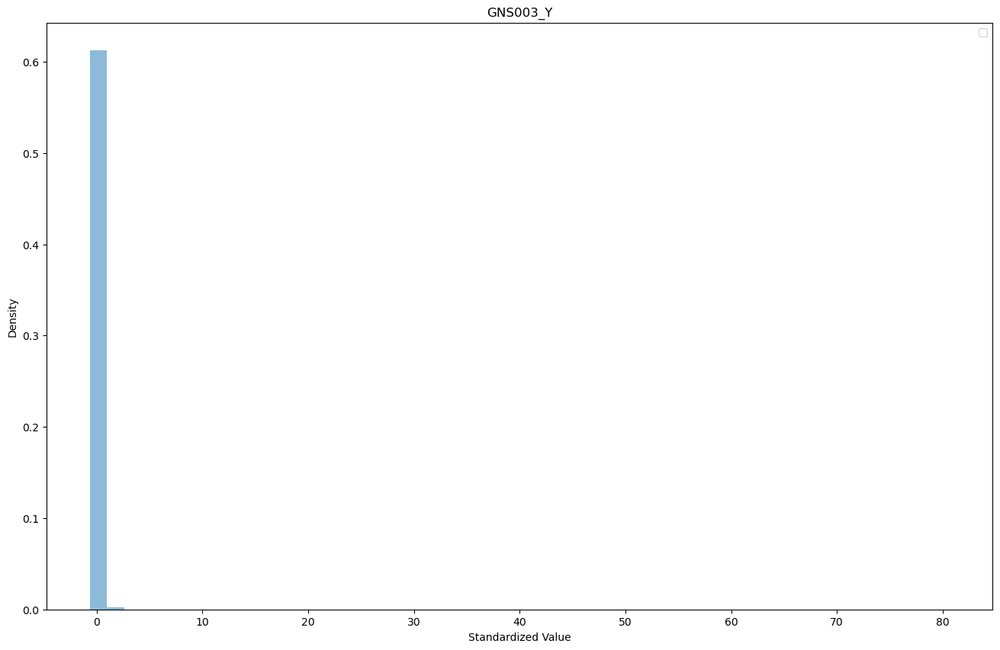

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


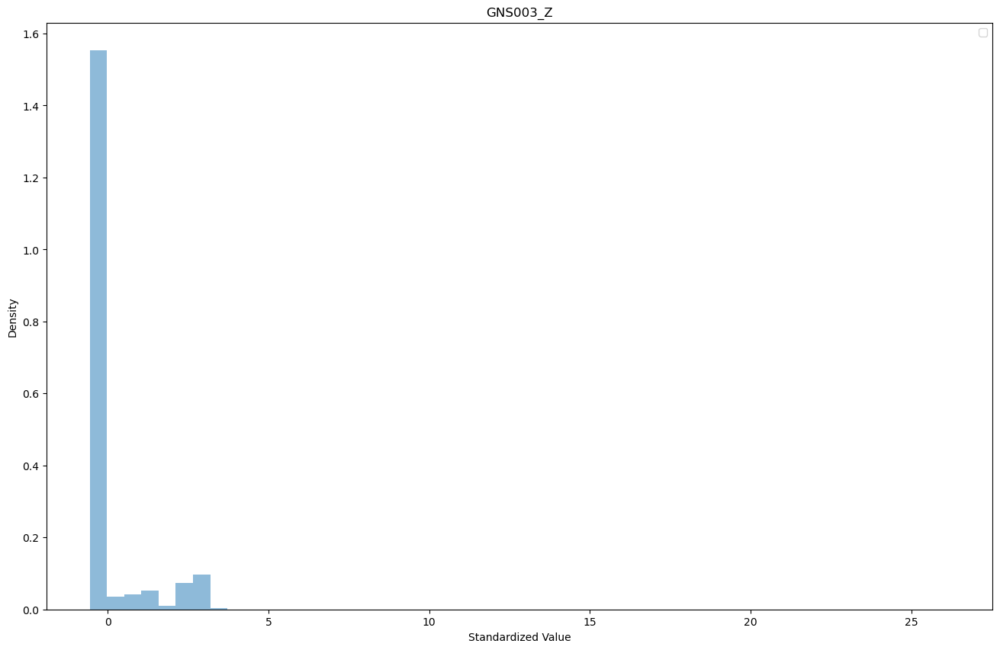

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


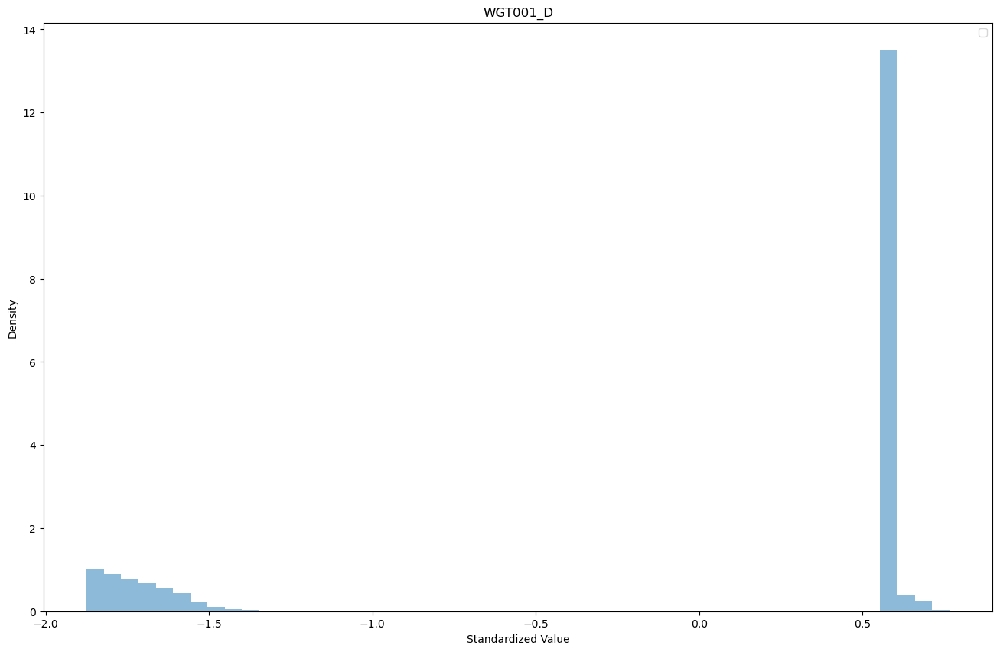

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


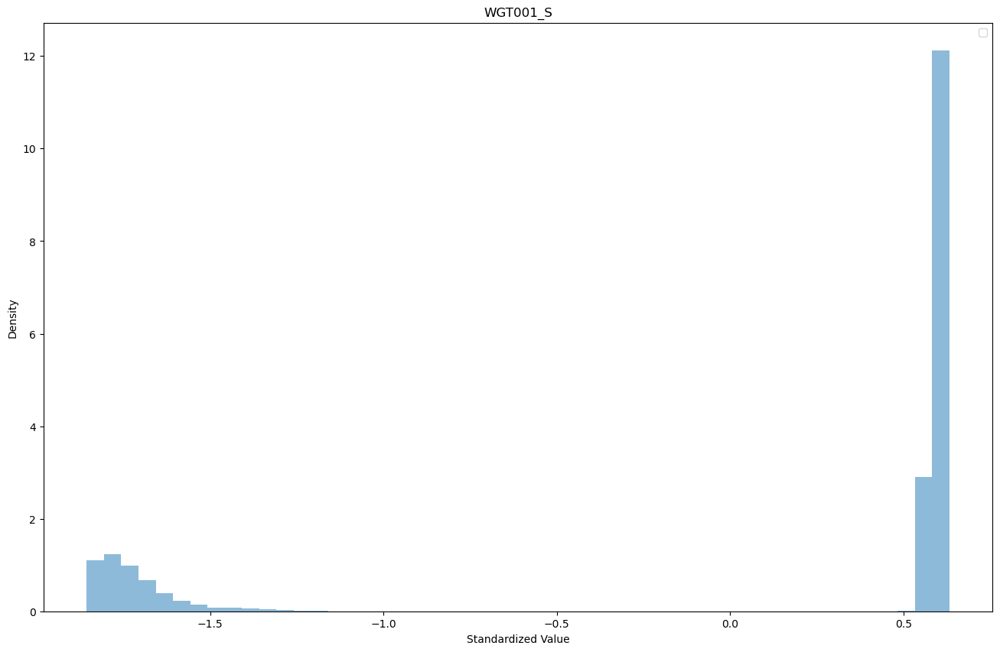

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


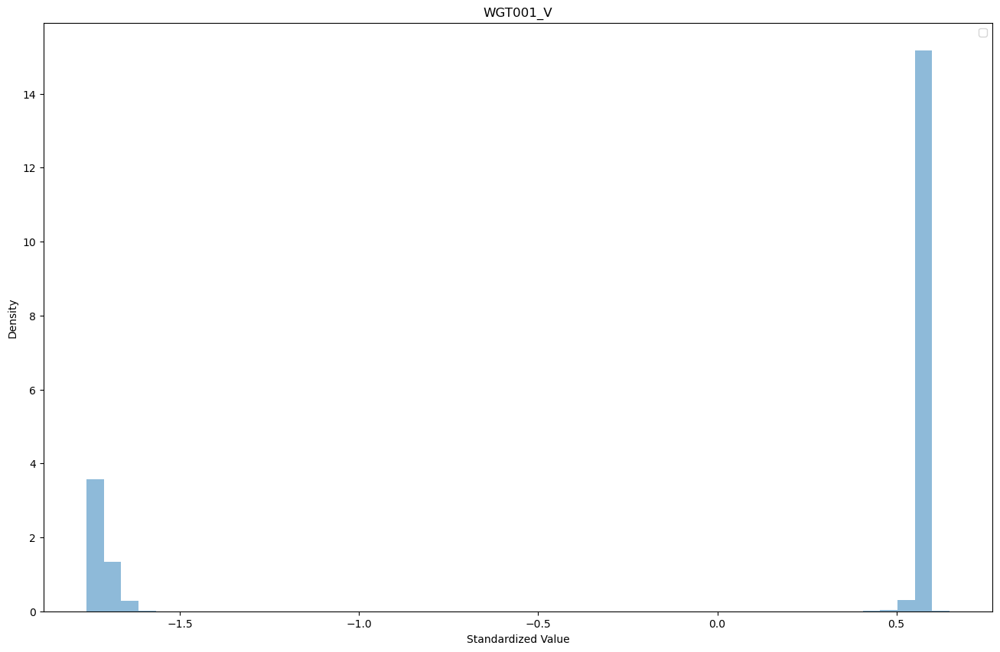

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


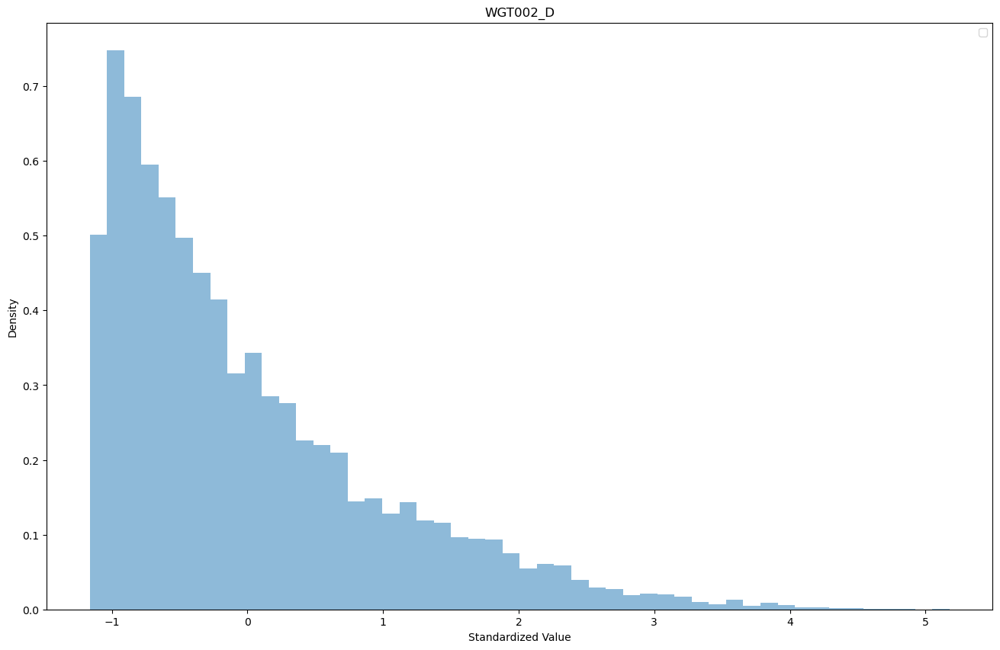

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


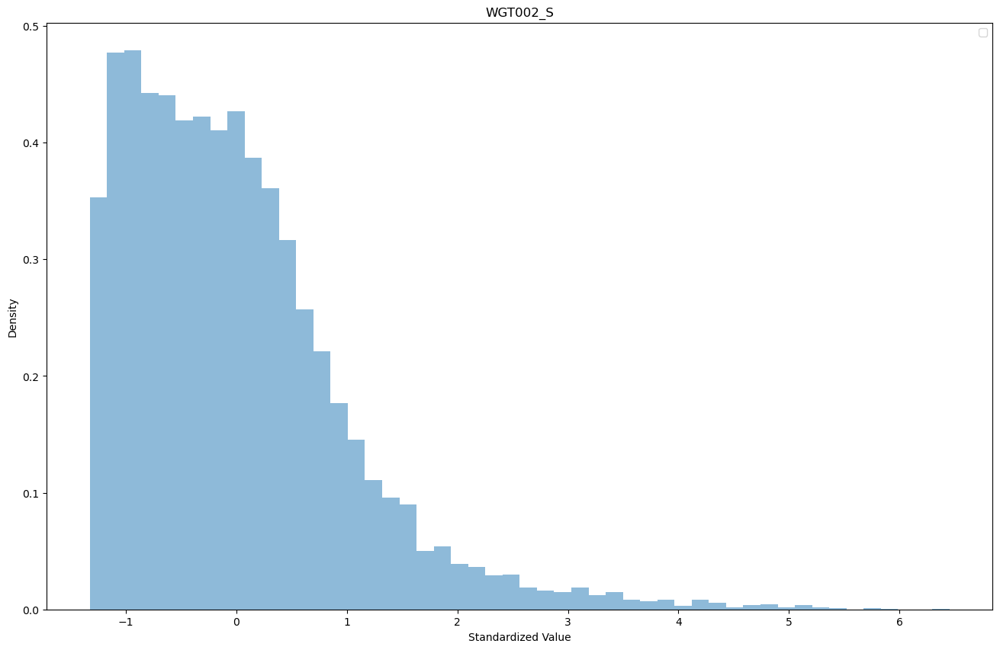

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


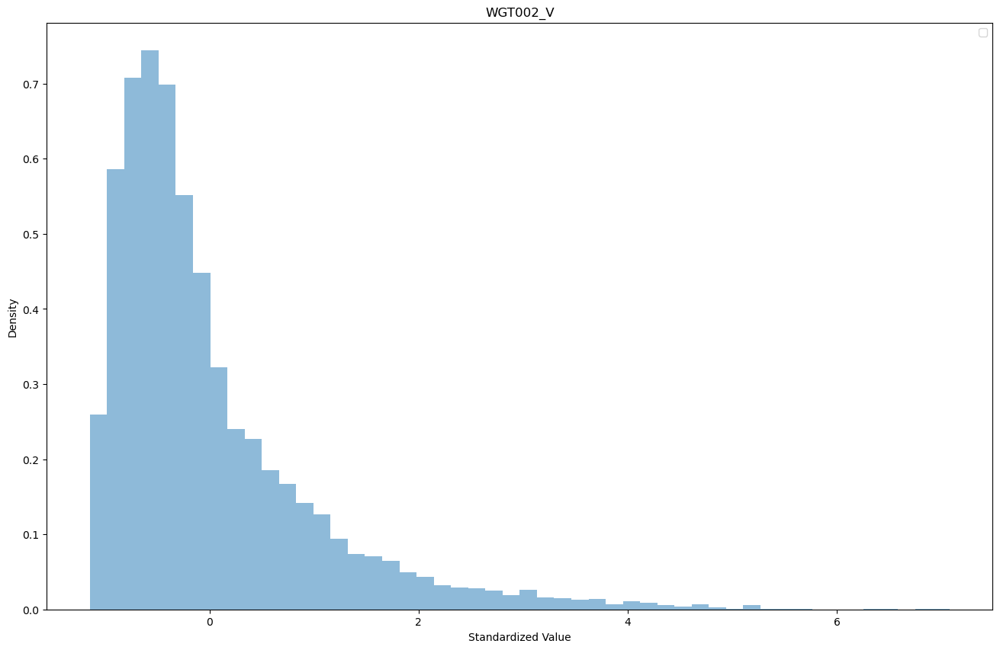

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


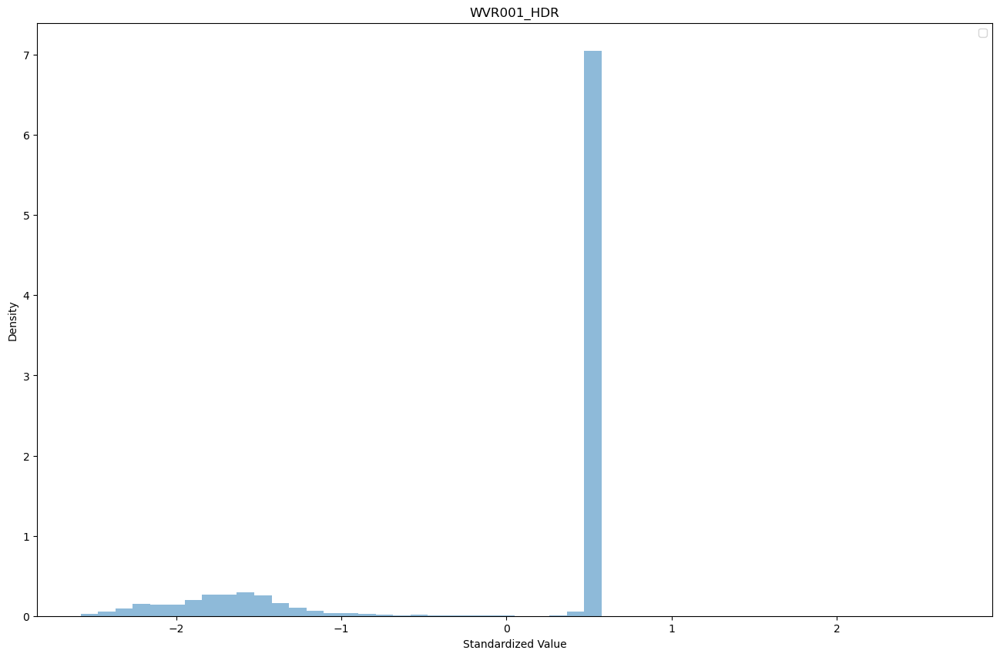

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


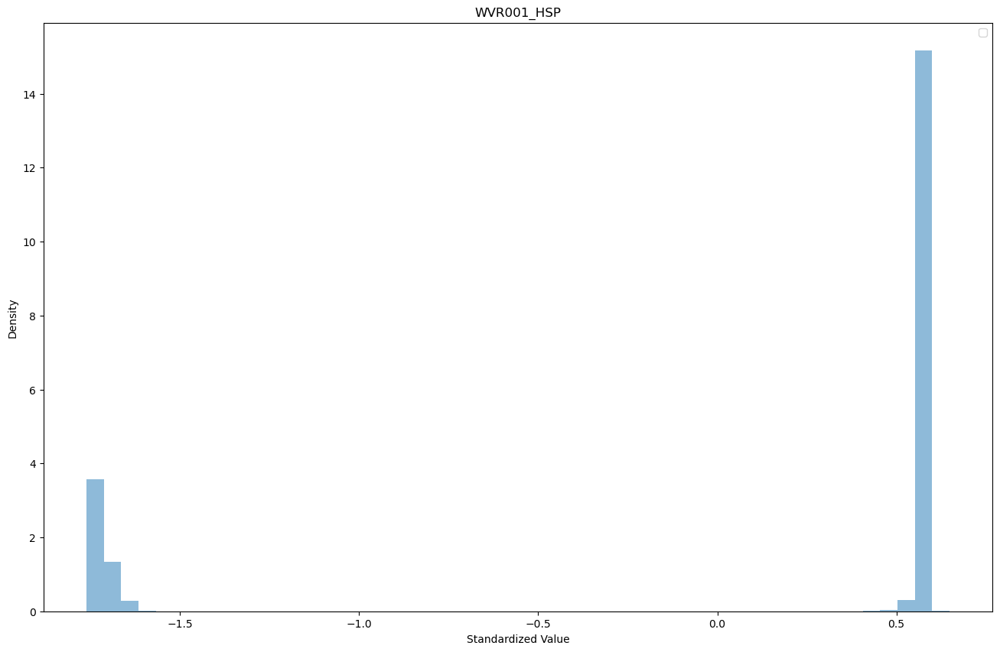

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


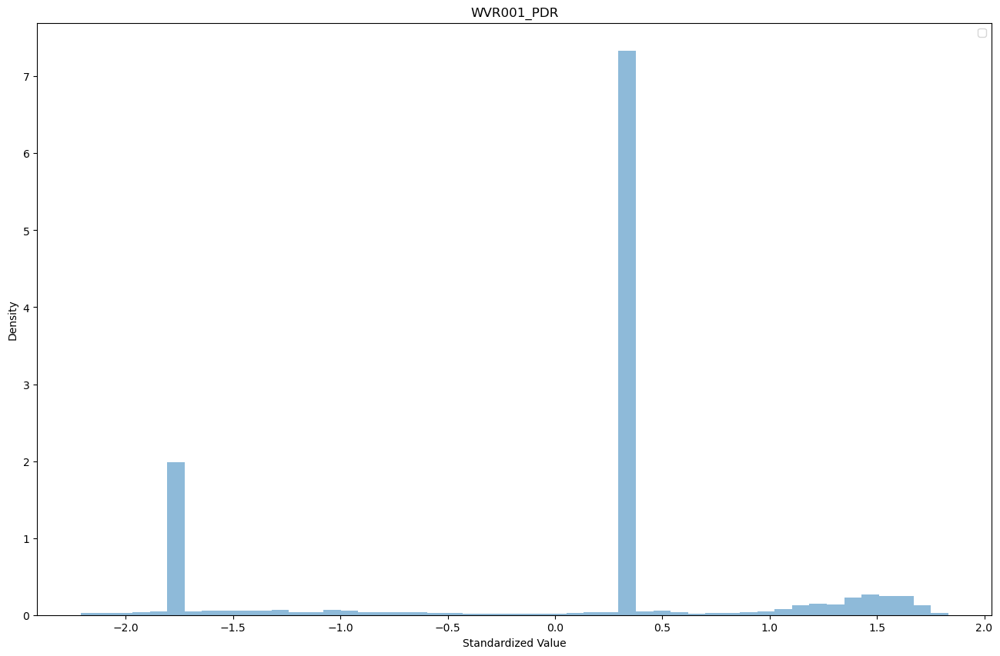

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


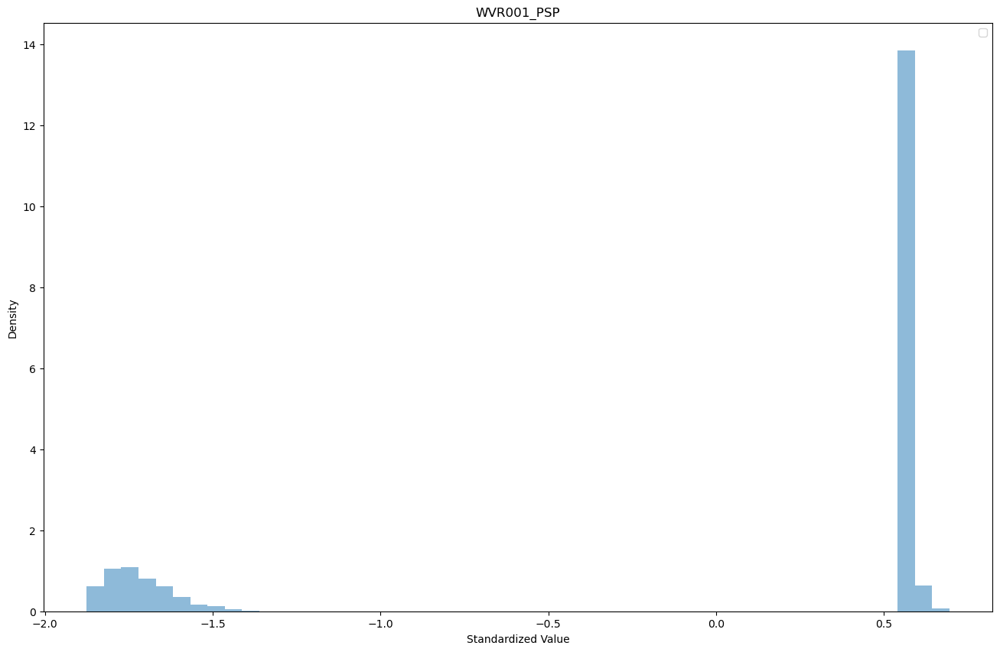

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


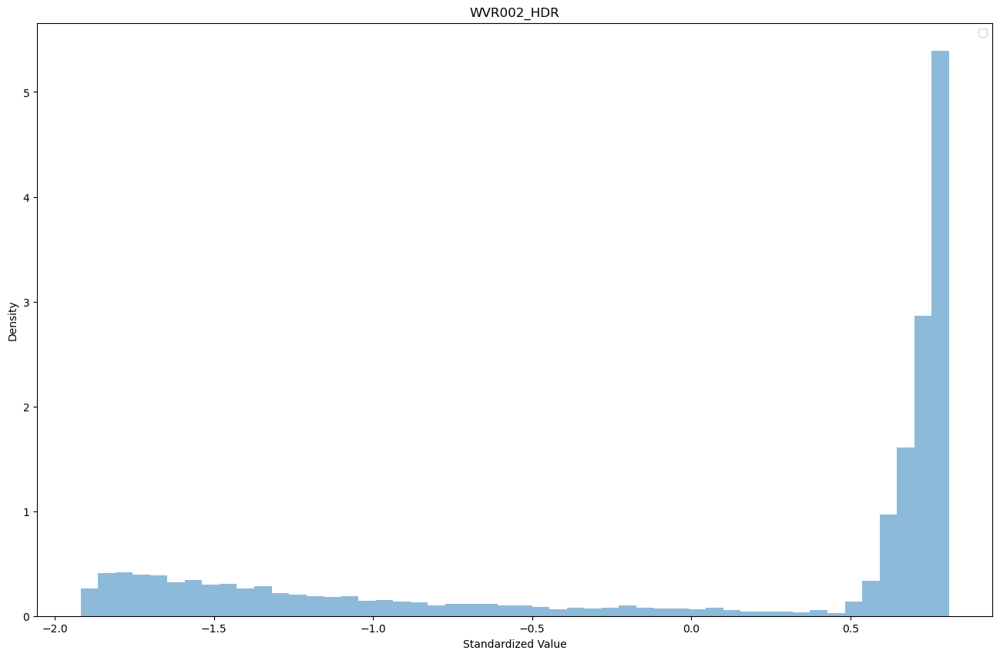

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


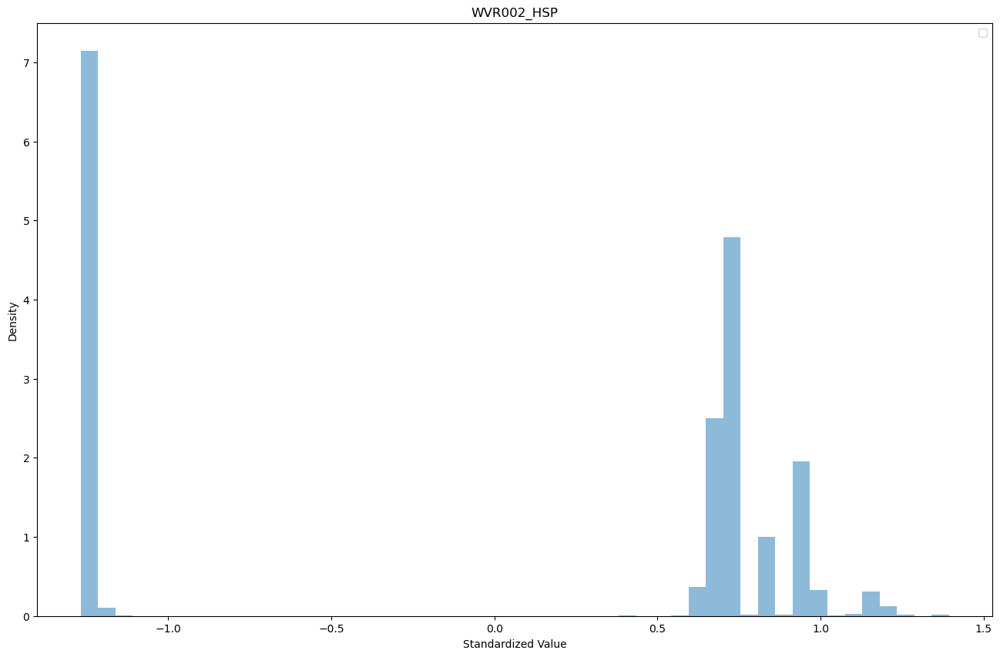

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


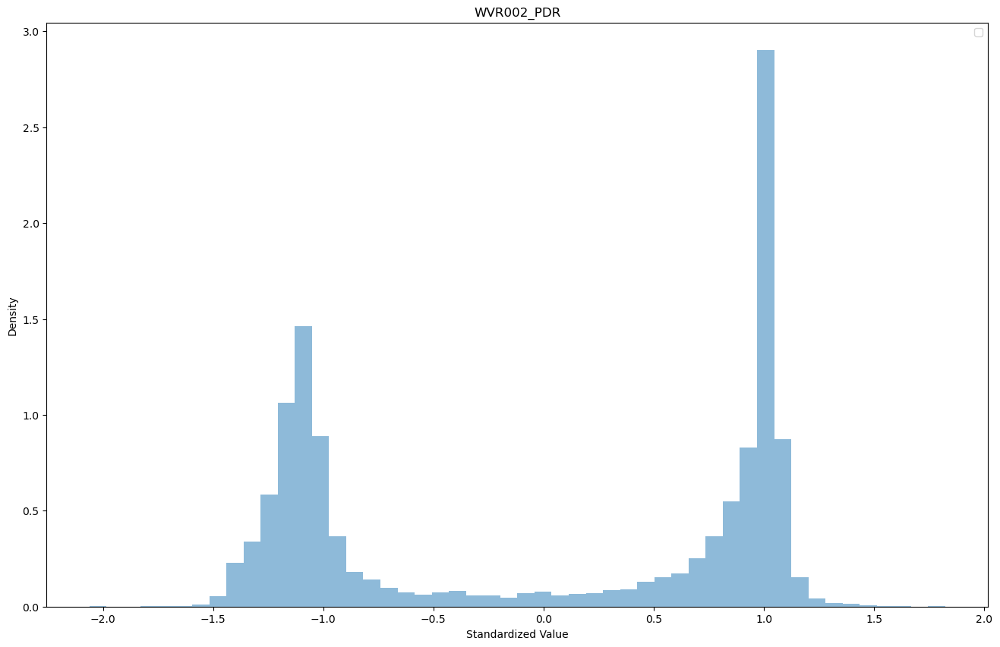

C:\Users\thddu\AppData\Local\Temp\ipykernel_26996\1146091628.py:20: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


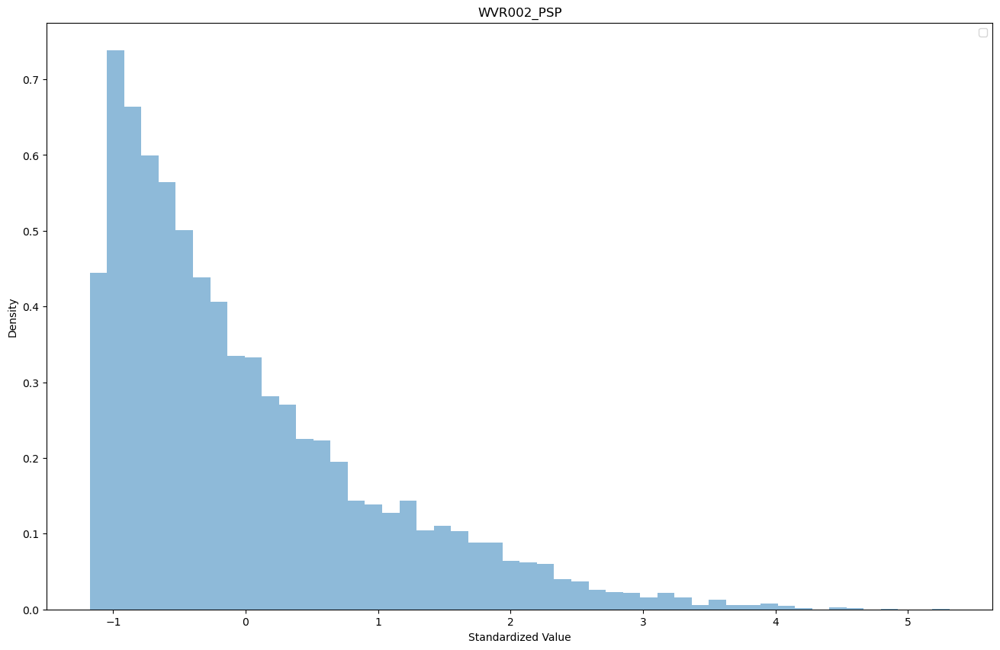

In [91]:
# 코드별 표준 정규분포 그려보기

from sklearn.preprocessing import StandardScaler
from scipy import stats

scaler = StandardScaler()
save_path = 'C:/Users/thddu/Desktop/데이터분석/진도대교분석/AI_anomalyDetection/img/StandardScaler'
for col in columns : 
    if col not in 'datetime' : 
        data_standalized = scaler.fit_transform(data[[col]])
        
        plt.figure(figsize= (16,10))
        plt.hist(data_standalized, bins = 50, density=True, alpha = 0.5)
        x = np.linspace(-4,4,1000)
        y = stats.norm.pdf(x,0,1)

        plt.title(col)
        plt.xlabel('Standardized Value')
        plt.ylabel('Density')
        plt.legend()
        plt.savefig(f"{save_path}/{col}.png")
        plt.show()

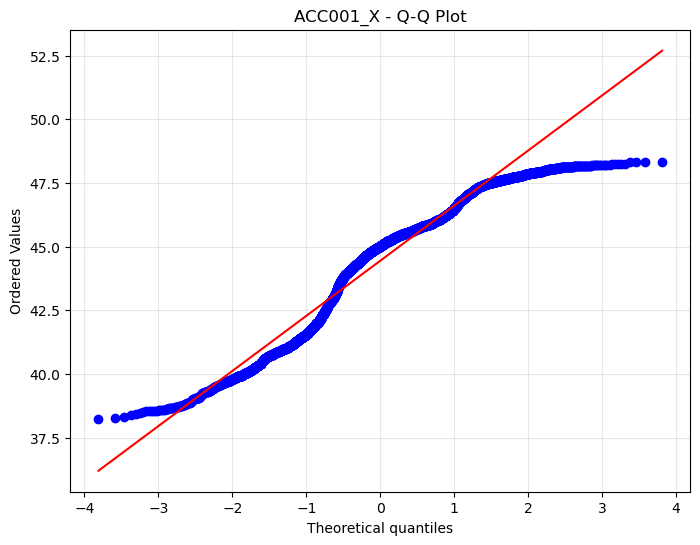

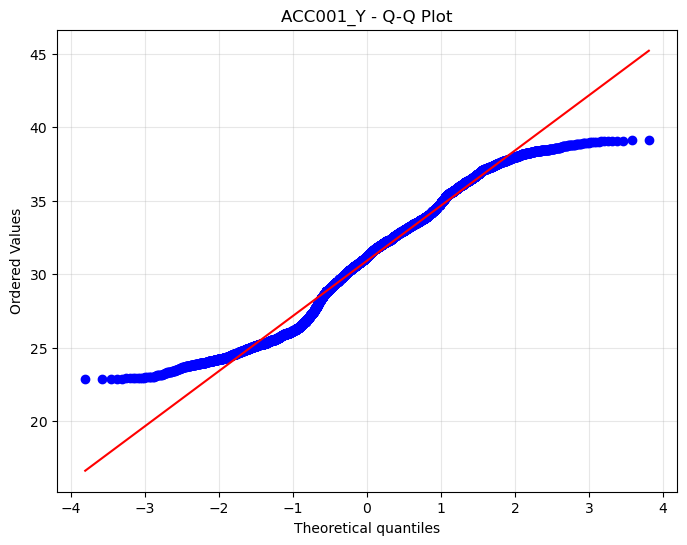

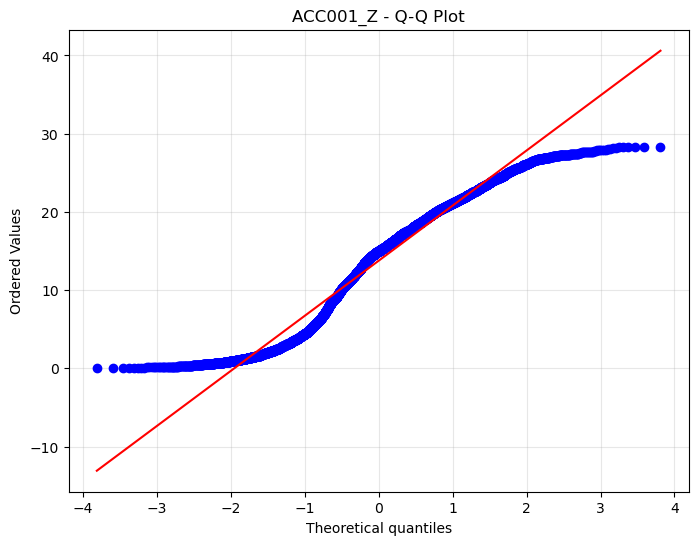

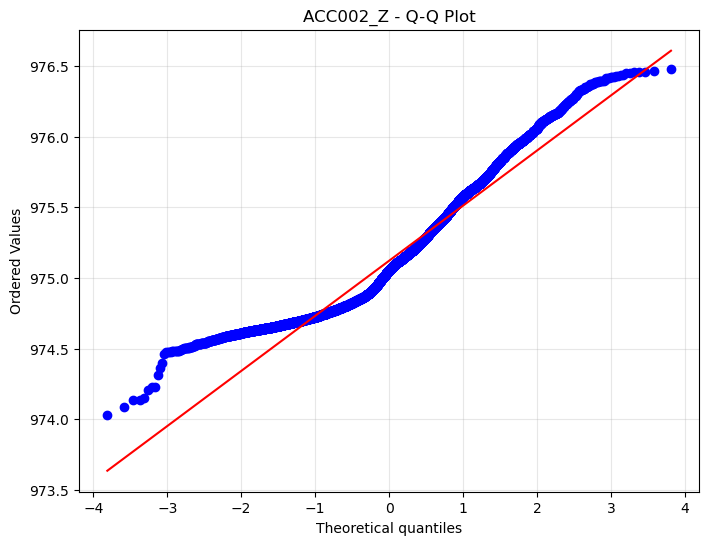

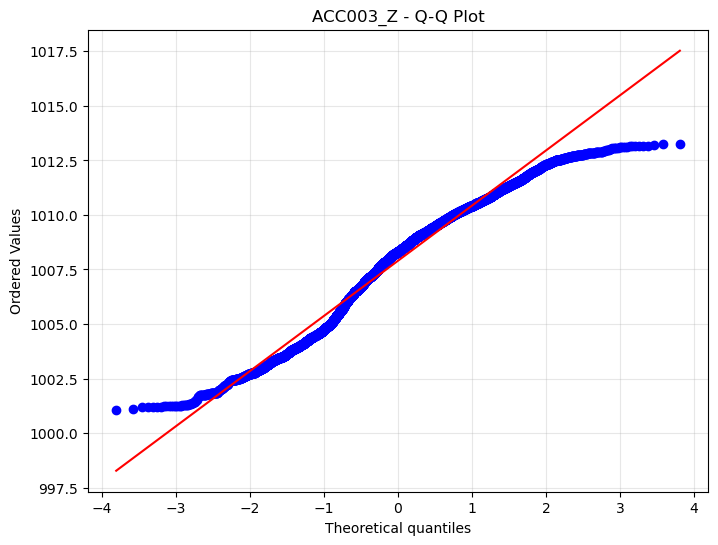

...

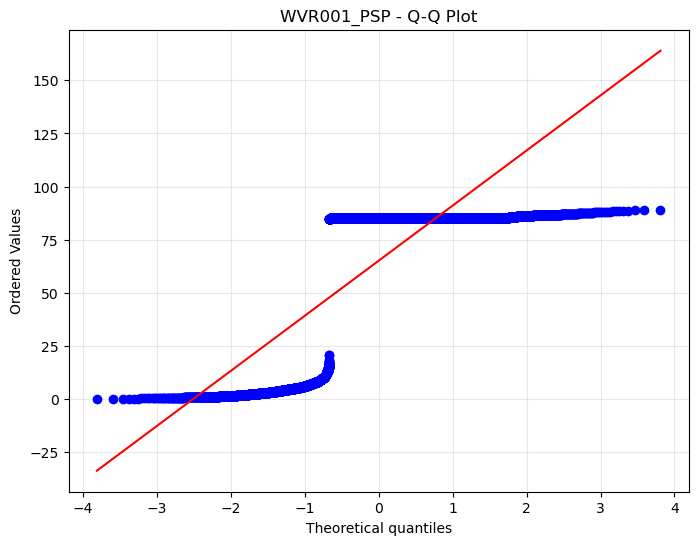

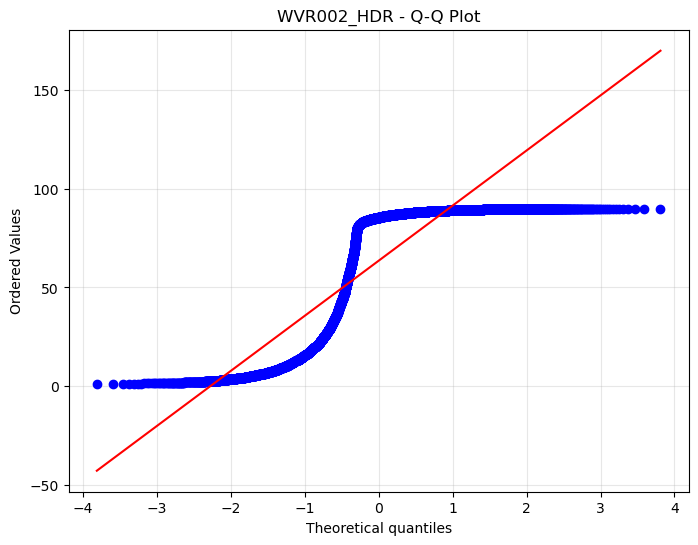

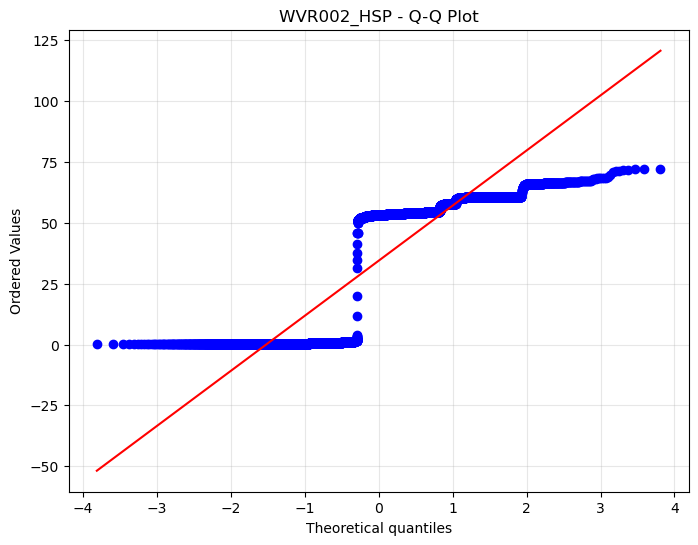

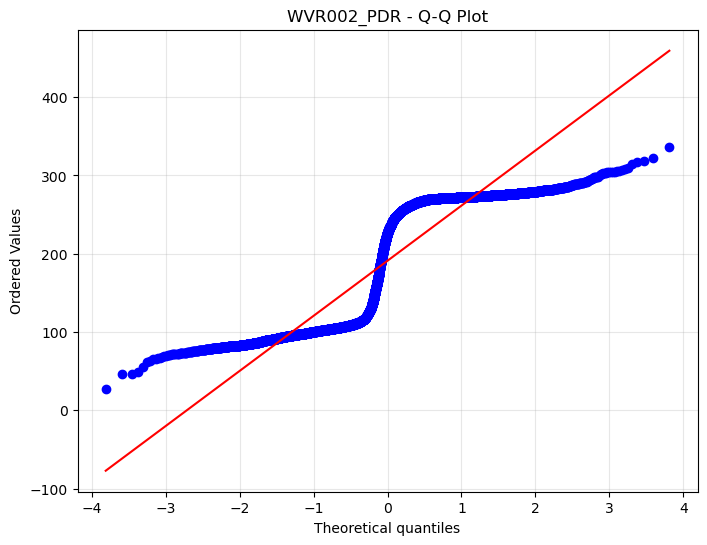

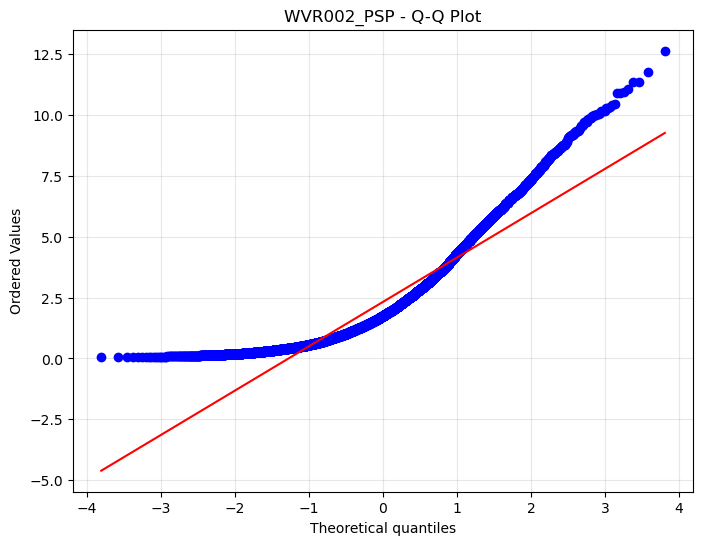

In [92]:
from scipy.stats import probplot

for col in columns : 
    if col not in 'datetime' : 
        plt.figure(figsize=(8, 6))
        probplot(data[col], dist="norm", plot=plt)
        plt.title(f'{col} - Q-Q Plot')
        plt.grid(True, alpha=0.3)
        plt.savefig(f"{save_path}/{col}_Q-Qplot.png")
        plt.show()

# Insight
### 1. 정규성을 지키는 데이터도 있고 아닌 데이터도 존재
### 2. 0과 Nan등의 데이터에 대해 보강 방법 필요
### 3. 정규성을 안지키는 데이터들에 대해 -> 로그 정규화 진행
### 4. 0의 데이터가 너무 많으면 분석 대상에서 제외